In [2]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 
from numpy import zeros, ones 
import numpy as np
from numpy.random import randn, randint
import tensorflow as tf
from matplotlib import pyplot
from model.dcgan_cifar import discriminator_, generator_, dcgan_
from utils.dataset_utils import return_cifar10 
from utils.model_utils import true_samples_generator, fake_samples_generator, make_latent_samples
from utils.visualizers_utils import show_generated_images, performance_summarizer
from tqdm.notebook import tqdm
from utils.visualizers_utils import show_gan_losses
import imageio
import glob
import re
from utils.visualizers_utils import generate_video 

Loading Cifar 10 dataset .......
Total number of files in the dataset is 50000
Shape of each image is (32, 32, 3)
********************
Examples from the dataset
********************


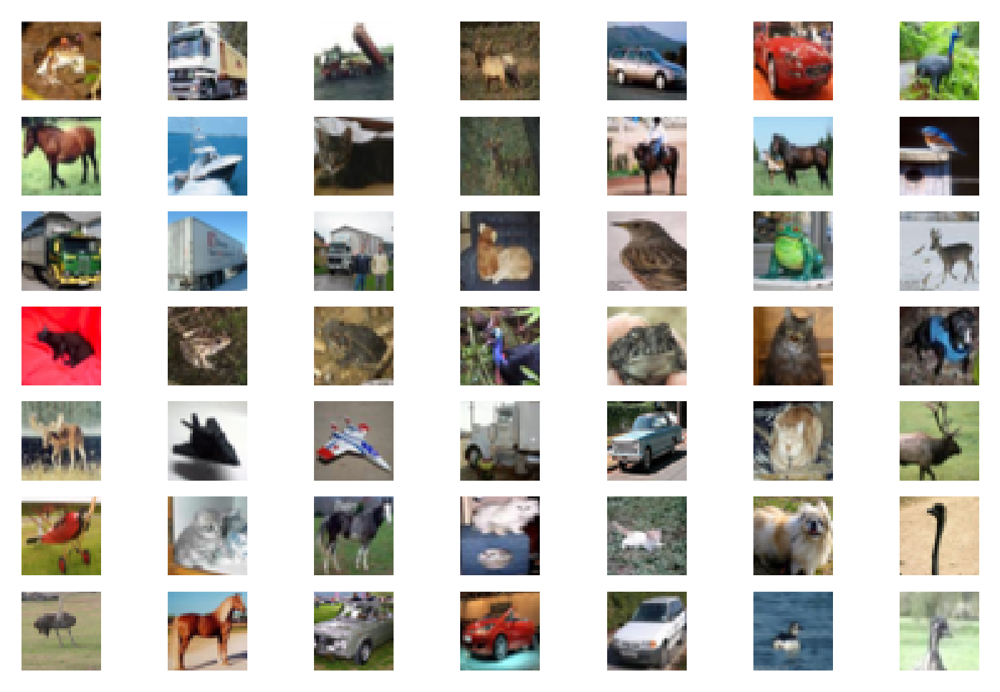

Done loading the Cifar 10 dataset .......


In [2]:
# load image data
data = return_cifar10()

In [3]:
# train the generator and discriminator
def train(generator, discriminator, dcgan, data, samplesize, epochs=200, batch_size=128, model_name=None):
    print(f' Training {model_name} ......')
    num_batches = int(data.shape[0] / batch_size)
    half_batch = int(batch_size / 2)

    discriminator_losses = []
    generator_losses = [] 
    # manually enumerate epochs
    for epoch in tqdm(range(epochs)):
        generator_loss_epoch = 0 
        discriminator_loss_epoch = 0 

        # enumerate batches over the training set
        for batch in range(num_batches):
            # get randomly selected 'real' samples
            X_real, y_real = true_samples_generator(data, half_batch)
            # update discriminator model weights
            discriminator_real_loss, _ = discriminator.train_on_batch(X_real, y_real)
            # generate 'fake' examples
            X_fake, y_fake = fake_samples_generator(half_batch, samplesize, generator)
            # update discriminator model weights
            discriminator_fake_loss, _ = discriminator.train_on_batch(X_fake, y_fake)
            # prepare points in latent space as input for the generator
            X_gan = make_latent_samples( samplesize, batch_size)
            # create inverted labels for the fake samples
            y_gan = np.ones((batch_size, 1))
            # update the generator via the discriminator's error
            generator_loss = dcgan.train_on_batch(X_gan, y_gan)

            #update the losses
            discriminator_loss_epoch += (discriminator_real_loss + discriminator_fake_loss)
            generator_loss_epoch += (generator_loss)

            # summarize loss on this batch
            if batch % 100 == 0:
                print(f' Epoch: {epoch + 1}, Batch: {batch + 1} of {num_batches}')
                print(f' Discriminator real loss: {discriminator_real_loss}, Discriminator Fake loss: {discriminator_fake_loss}, Generator loss: {generator_loss}')

        discriminator_losses.append(discriminator_loss_epoch)
        generator_losses.append(generator_loss_epoch)
        performance_summarizer(epoch, generator, discriminator, data, samplesize, model_name=model_name)
    show_gan_losses(generator_losses, discriminator_losses, save_to= f'results/{model_name}/')
    print("Done with training the model ......")
    return generator

 Training dcgan_cifar ......


  0%|          | 0/60 [00:00<?, ?it/s]

 Epoch: 1, Batch: 1 of 390
 Discriminator real loss: 0.6949191093444824, Discriminator Fake loss: 0.6954052448272705, Generator loss: 0.6915957927703857
 Epoch: 1, Batch: 101 of 390
 Discriminator real loss: 0.024886036291718483, Discriminator Fake loss: 0.013118699193000793, Generator loss: 4.474778175354004
 Epoch: 1, Batch: 201 of 390
 Discriminator real loss: 0.27421367168426514, Discriminator Fake loss: 0.23746547102928162, Generator loss: 2.7980895042419434
 Epoch: 1, Batch: 301 of 390
 Discriminator real loss: 0.42371201515197754, Discriminator Fake loss: 0.2257339209318161, Generator loss: 2.3617777824401855
***** Accuracy real: 80.66666722297668, fake: 94.66666579246521 *****


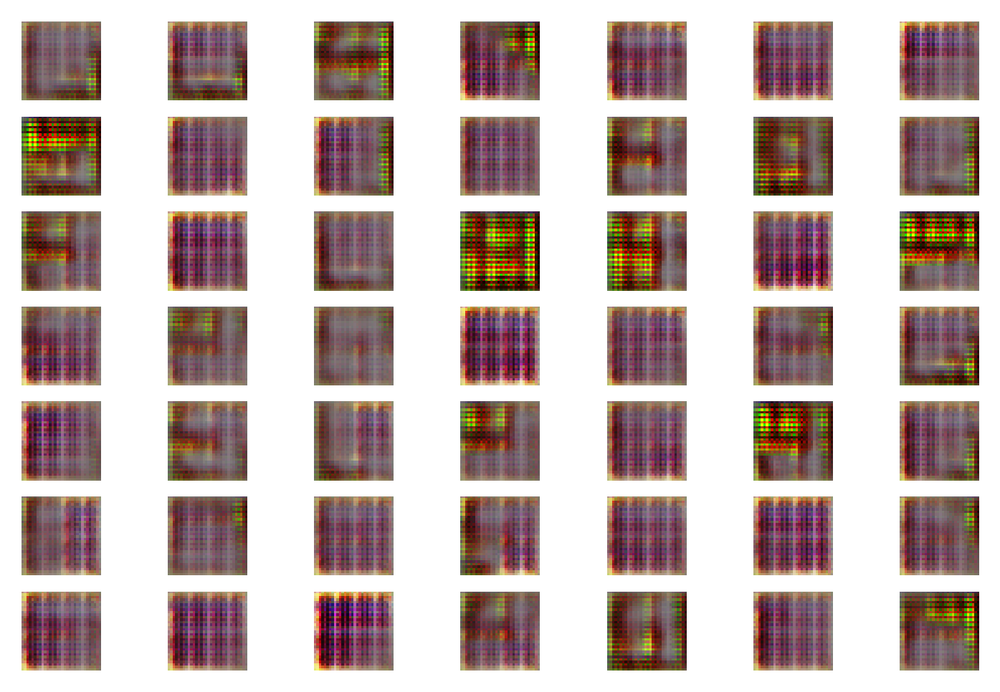

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 2, Batch: 1 of 390
 Discriminator real loss: 0.36515337228775024, Discriminator Fake loss: 0.372205913066864, Generator loss: 1.6808503866195679
 Epoch: 2, Batch: 101 of 390
 Discriminator real loss: 0.4151090979576111, Discriminator Fake loss: 0.49576377868652344, Generator loss: 2.5325329303741455
 Epoch: 2, Batch: 201 of 390
 Discriminator real loss: 0.41890543699264526, Discriminator Fake loss: 0.38325822353363037, Generator loss: 1.4410947561264038
 Epoch: 2, Batch: 301 of 390
 Discriminator real loss: 0.8019003868103027, Discriminator Fake loss: 0.47903409600257874, Generator loss: 1.364554524421692
***** Accuracy real: 63.999998569488525, fake: 88.66666555404663 *****


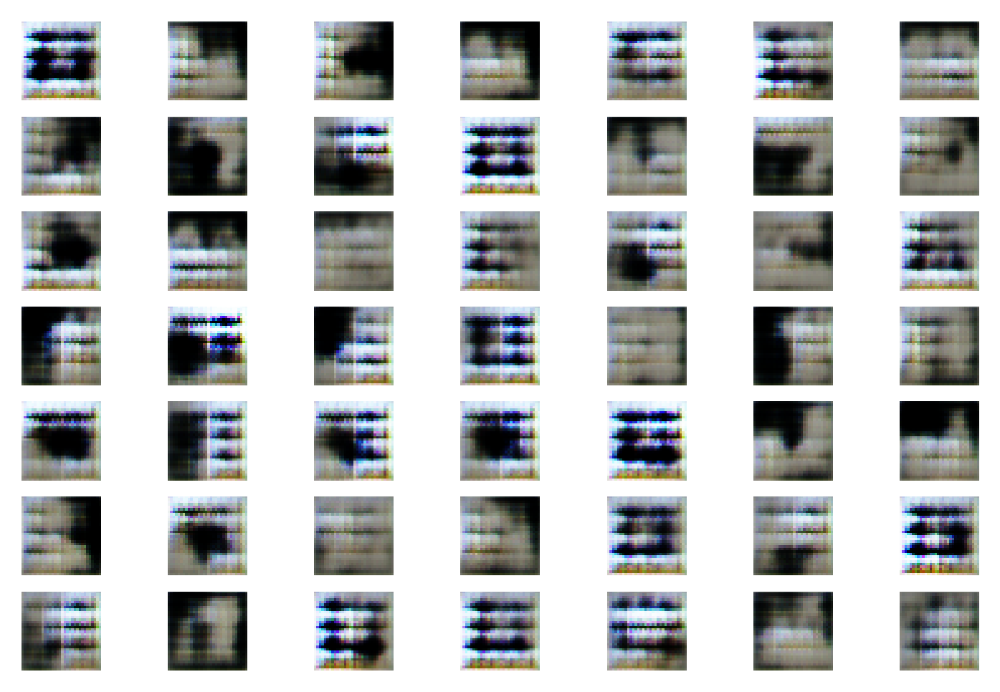

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 3, Batch: 1 of 390
 Discriminator real loss: 0.515411376953125, Discriminator Fake loss: 0.6410840153694153, Generator loss: 1.6075571775436401
 Epoch: 3, Batch: 101 of 390
 Discriminator real loss: 0.5336138010025024, Discriminator Fake loss: 0.40622928738594055, Generator loss: 1.5501066446304321
 Epoch: 3, Batch: 201 of 390
 Discriminator real loss: 0.4962071180343628, Discriminator Fake loss: 0.7179133296012878, Generator loss: 1.1410555839538574
 Epoch: 3, Batch: 301 of 390
 Discriminator real loss: 0.5432091951370239, Discriminator Fake loss: 0.5262032747268677, Generator loss: 1.269633173942566
***** Accuracy real: 47.999998927116394, fake: 90.66666960716248 *****


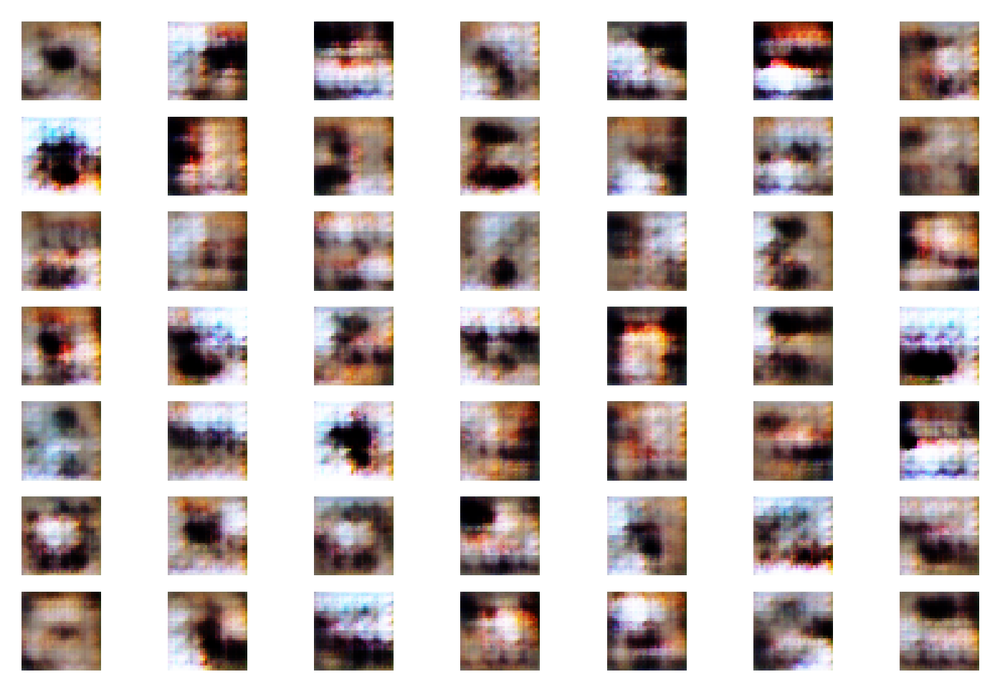

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 4, Batch: 1 of 390
 Discriminator real loss: 0.5508053302764893, Discriminator Fake loss: 0.6336579918861389, Generator loss: 1.2756145000457764
 Epoch: 4, Batch: 101 of 390
 Discriminator real loss: 0.4148479700088501, Discriminator Fake loss: 0.507984459400177, Generator loss: 1.28853440284729
 Epoch: 4, Batch: 201 of 390
 Discriminator real loss: 0.38780492544174194, Discriminator Fake loss: 0.46930280327796936, Generator loss: 1.1627302169799805
 Epoch: 4, Batch: 301 of 390
 Discriminator real loss: 0.7301016449928284, Discriminator Fake loss: 0.39774030447006226, Generator loss: 1.3968546390533447
***** Accuracy real: 74.00000095367432, fake: 77.99999713897705 *****


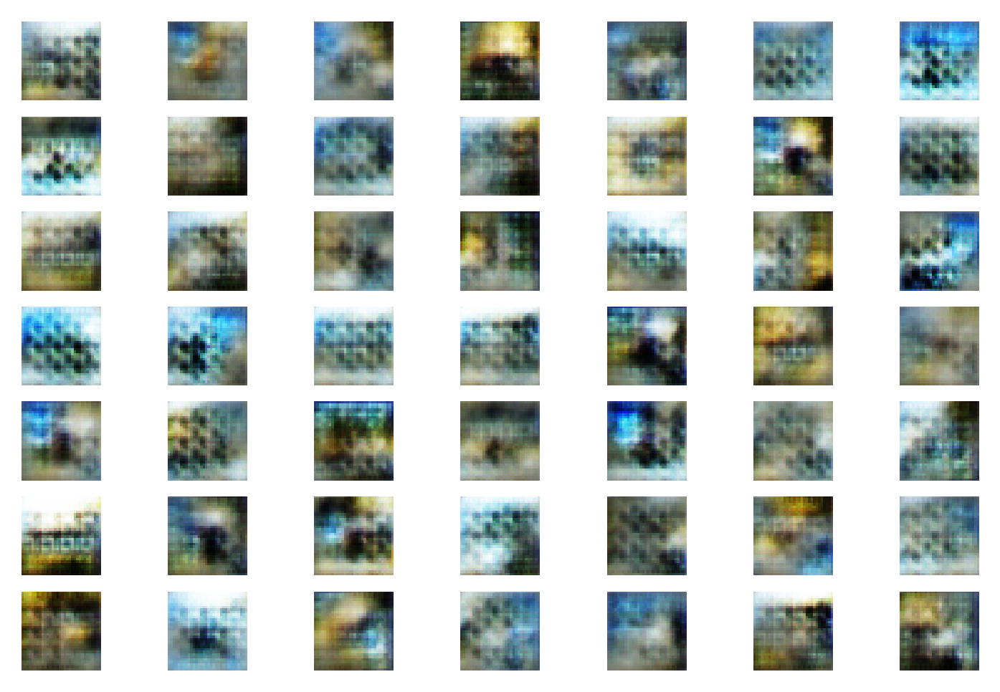

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 5, Batch: 1 of 390
 Discriminator real loss: 0.5552629232406616, Discriminator Fake loss: 0.6171213388442993, Generator loss: 1.1027026176452637
 Epoch: 5, Batch: 101 of 390
 Discriminator real loss: 0.6491072773933411, Discriminator Fake loss: 0.6272889375686646, Generator loss: 1.247117042541504
 Epoch: 5, Batch: 201 of 390
 Discriminator real loss: 0.6119422912597656, Discriminator Fake loss: 0.5593944191932678, Generator loss: 1.190964937210083
 Epoch: 5, Batch: 301 of 390
 Discriminator real loss: 0.7672246694564819, Discriminator Fake loss: 0.3714578151702881, Generator loss: 1.6822998523712158
***** Accuracy real: 58.666664361953735, fake: 80.0000011920929 *****


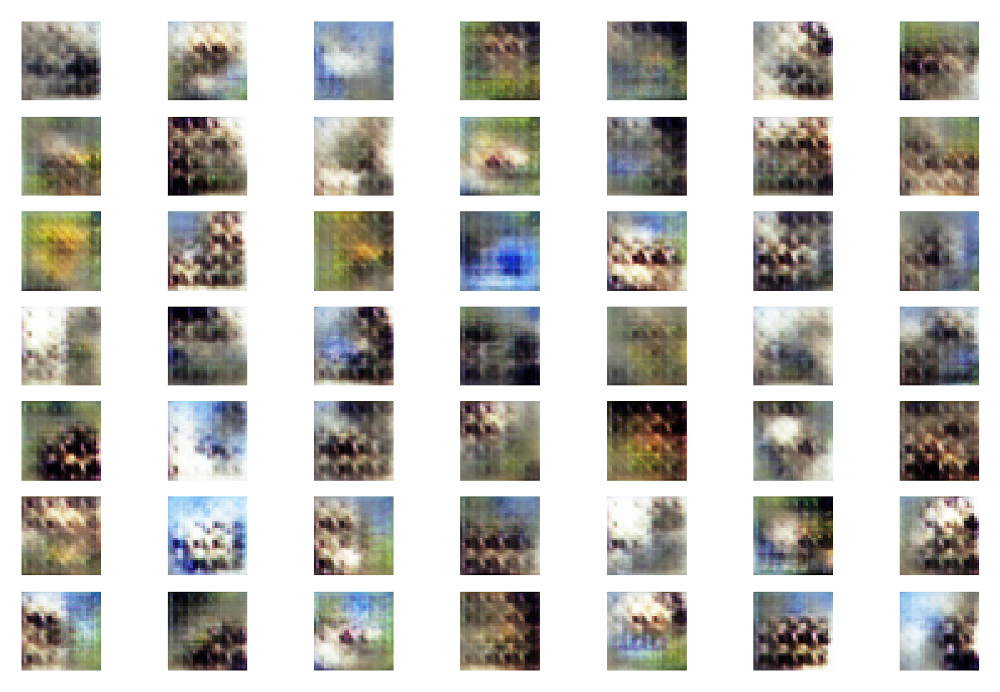

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 6, Batch: 1 of 390
 Discriminator real loss: 0.5873866677284241, Discriminator Fake loss: 0.6296140551567078, Generator loss: 1.2685281038284302
 Epoch: 6, Batch: 101 of 390
 Discriminator real loss: 0.5187321901321411, Discriminator Fake loss: 0.4686253070831299, Generator loss: 1.5798242092132568
 Epoch: 6, Batch: 201 of 390
 Discriminator real loss: 0.6286787986755371, Discriminator Fake loss: 0.5544396638870239, Generator loss: 1.179566740989685
 Epoch: 6, Batch: 301 of 390
 Discriminator real loss: 0.5582038760185242, Discriminator Fake loss: 0.5540667772293091, Generator loss: 1.209423303604126
***** Accuracy real: 65.3333306312561, fake: 53.33333611488342 *****


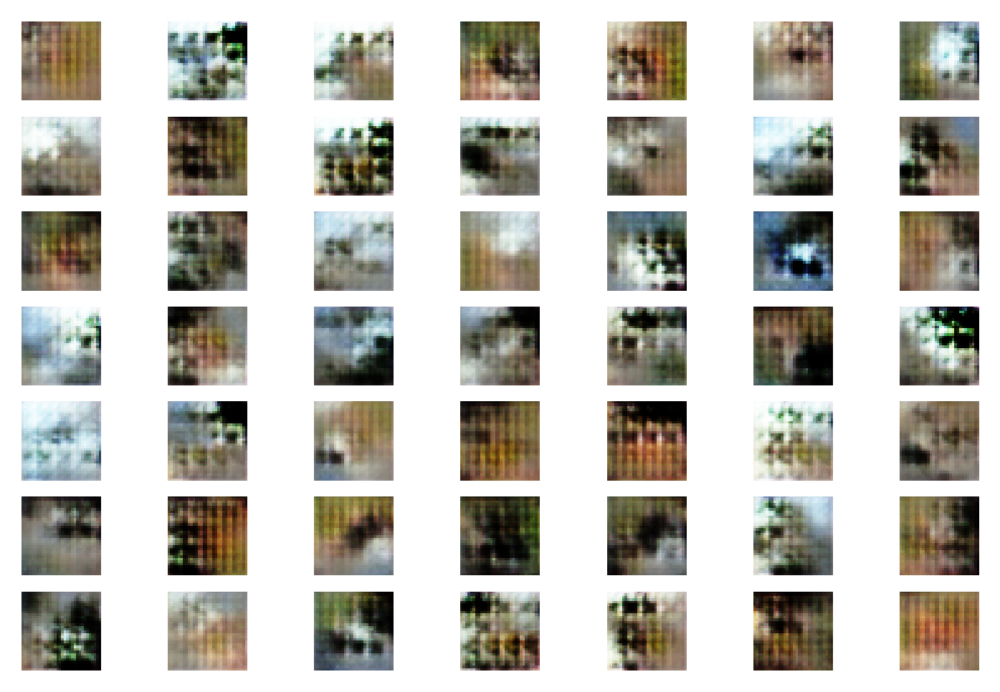

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 7, Batch: 1 of 390
 Discriminator real loss: 0.7647161483764648, Discriminator Fake loss: 0.8374887704849243, Generator loss: 1.2531510591506958
 Epoch: 7, Batch: 101 of 390
 Discriminator real loss: 0.5791849493980408, Discriminator Fake loss: 0.5243713855743408, Generator loss: 1.3398551940917969
 Epoch: 7, Batch: 201 of 390
 Discriminator real loss: 0.6500478982925415, Discriminator Fake loss: 0.668254017829895, Generator loss: 1.2826417684555054
 Epoch: 7, Batch: 301 of 390
 Discriminator real loss: 0.5152899622917175, Discriminator Fake loss: 0.5520508289337158, Generator loss: 1.3498215675354004
***** Accuracy real: 70.6666648387909, fake: 94.66666579246521 *****


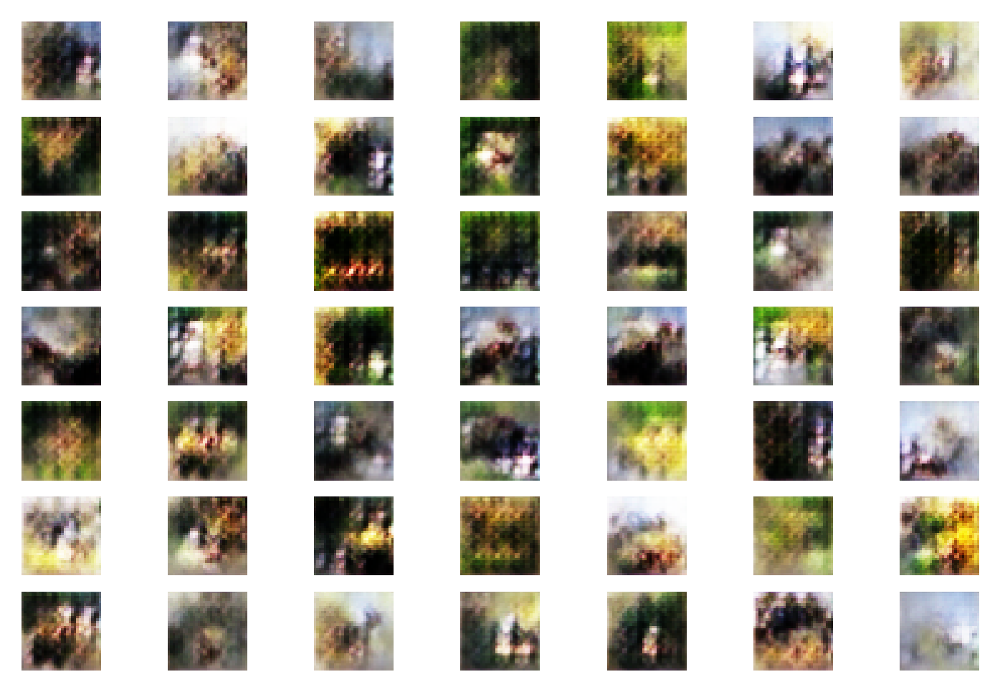

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 8, Batch: 1 of 390
 Discriminator real loss: 0.36795511841773987, Discriminator Fake loss: 0.4733050763607025, Generator loss: 1.4939370155334473
 Epoch: 8, Batch: 101 of 390
 Discriminator real loss: 0.6924382448196411, Discriminator Fake loss: 0.515941321849823, Generator loss: 1.2012417316436768
 Epoch: 8, Batch: 201 of 390
 Discriminator real loss: 0.6814188957214355, Discriminator Fake loss: 0.6508799195289612, Generator loss: 1.2140188217163086
 Epoch: 8, Batch: 301 of 390
 Discriminator real loss: 0.5937528014183044, Discriminator Fake loss: 0.5434795022010803, Generator loss: 1.5515859127044678
***** Accuracy real: 71.33333086967468, fake: 88.66666555404663 *****


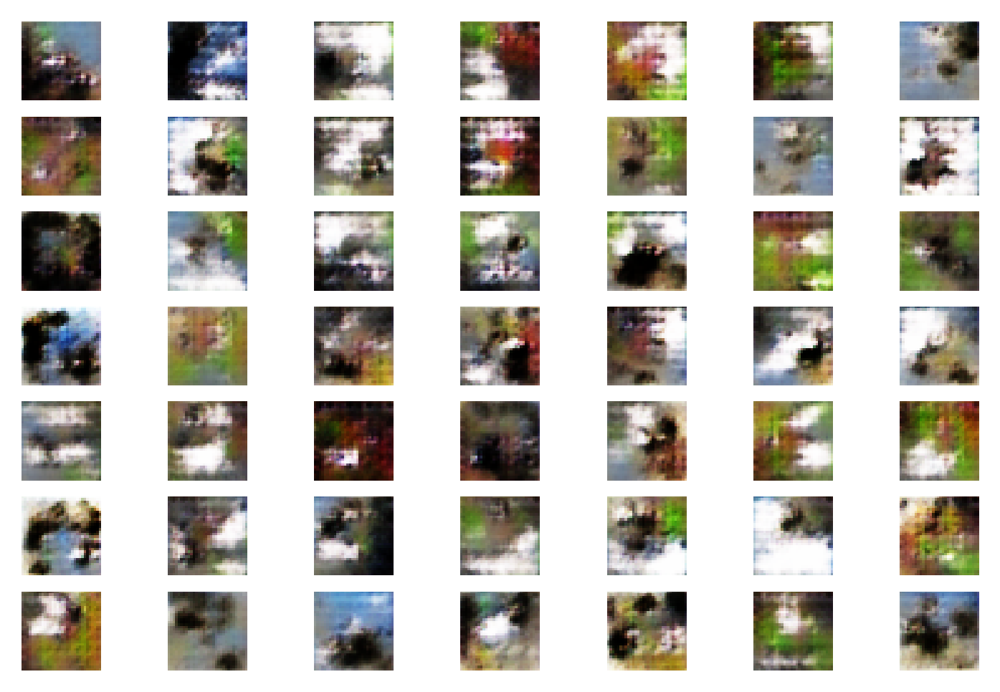

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 9, Batch: 1 of 390
 Discriminator real loss: 0.46535253524780273, Discriminator Fake loss: 0.5689802169799805, Generator loss: 1.2484235763549805
 Epoch: 9, Batch: 101 of 390
 Discriminator real loss: 0.6774475574493408, Discriminator Fake loss: 0.5771846771240234, Generator loss: 1.1257271766662598
 Epoch: 9, Batch: 201 of 390
 Discriminator real loss: 0.6515381932258606, Discriminator Fake loss: 0.4566015899181366, Generator loss: 1.2118313312530518
 Epoch: 9, Batch: 301 of 390
 Discriminator real loss: 0.6152348518371582, Discriminator Fake loss: 0.5269584655761719, Generator loss: 1.1110068559646606
***** Accuracy real: 53.33333611488342, fake: 87.33333349227905 *****


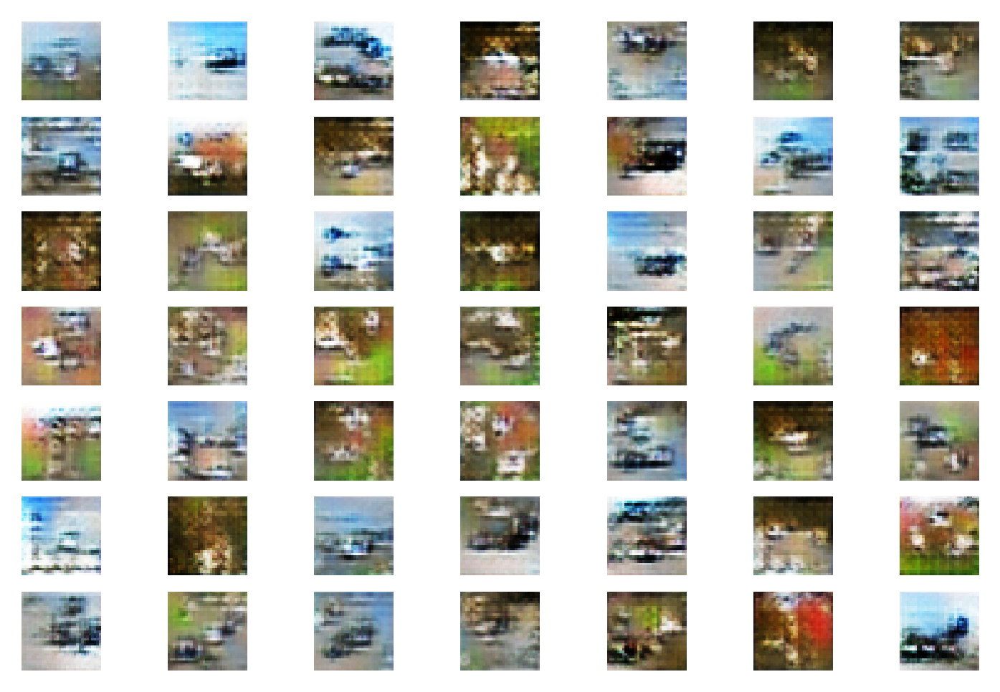

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 10, Batch: 1 of 390
 Discriminator real loss: 0.5484820008277893, Discriminator Fake loss: 0.5053161382675171, Generator loss: 1.2529287338256836
 Epoch: 10, Batch: 101 of 390
 Discriminator real loss: 0.630454421043396, Discriminator Fake loss: 0.6036224365234375, Generator loss: 1.1448876857757568
 Epoch: 10, Batch: 201 of 390
 Discriminator real loss: 0.9579761624336243, Discriminator Fake loss: 0.3265775442123413, Generator loss: 1.6792631149291992
 Epoch: 10, Batch: 301 of 390
 Discriminator real loss: 0.6334846019744873, Discriminator Fake loss: 0.6001883149147034, Generator loss: 1.1779818534851074
***** Accuracy real: 50.66666603088379, fake: 77.33333110809326 *****


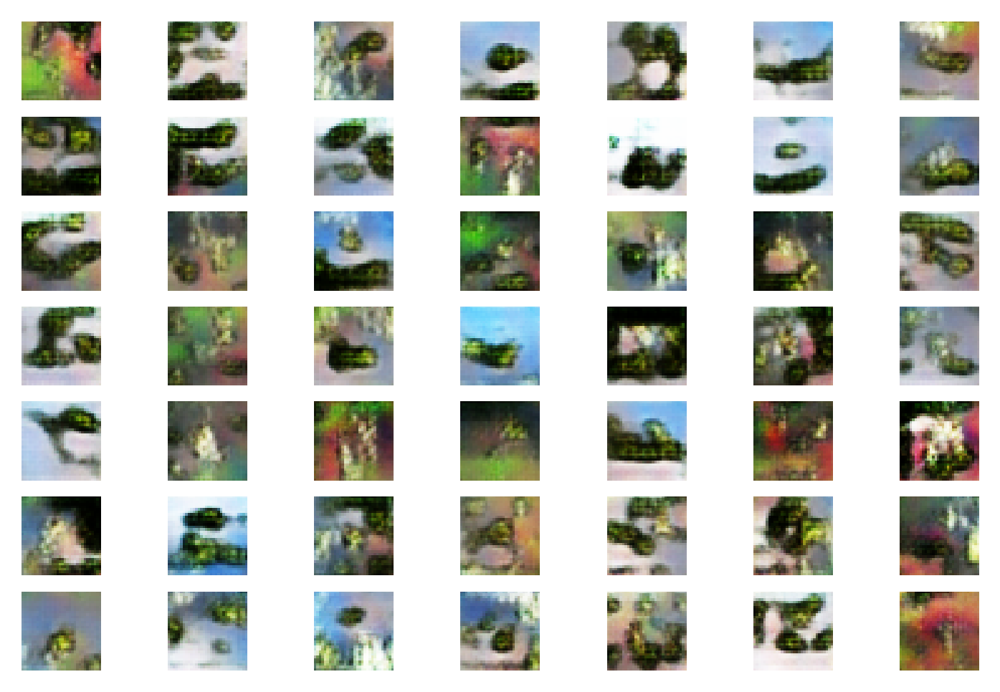

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 11, Batch: 1 of 390
 Discriminator real loss: 0.6058706045150757, Discriminator Fake loss: 0.5880007743835449, Generator loss: 0.9827459454536438
 Epoch: 11, Batch: 101 of 390
 Discriminator real loss: 0.6162464618682861, Discriminator Fake loss: 0.6484935283660889, Generator loss: 0.9625548124313354
 Epoch: 11, Batch: 201 of 390
 Discriminator real loss: 0.7405273914337158, Discriminator Fake loss: 0.5425318479537964, Generator loss: 0.9863595962524414
 Epoch: 11, Batch: 301 of 390
 Discriminator real loss: 0.7486672401428223, Discriminator Fake loss: 0.7247815132141113, Generator loss: 1.1236895322799683
***** Accuracy real: 45.33333480358124, fake: 86.66666746139526 *****


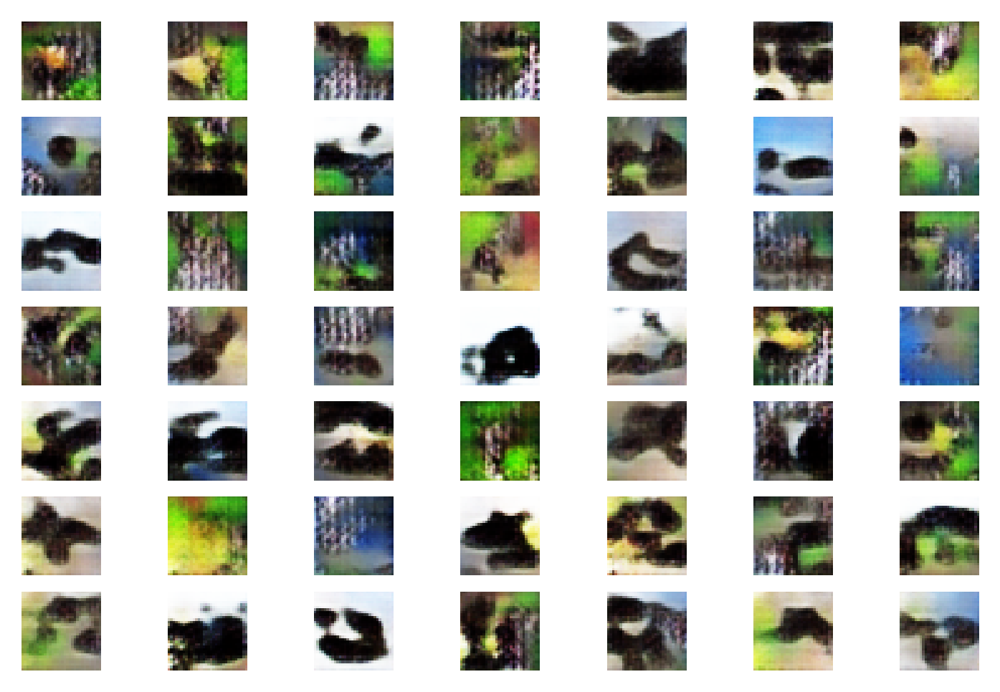

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 12, Batch: 1 of 390
 Discriminator real loss: 0.5805559158325195, Discriminator Fake loss: 0.5128918886184692, Generator loss: 1.0239386558532715
 Epoch: 12, Batch: 101 of 390
 Discriminator real loss: 0.7346731424331665, Discriminator Fake loss: 0.5815728902816772, Generator loss: 1.0153859853744507
 Epoch: 12, Batch: 201 of 390
 Discriminator real loss: 0.6329150795936584, Discriminator Fake loss: 0.5983343124389648, Generator loss: 0.9045790433883667
 Epoch: 12, Batch: 301 of 390
 Discriminator real loss: 0.5847429633140564, Discriminator Fake loss: 0.803931713104248, Generator loss: 0.9799668788909912
***** Accuracy real: 51.33333206176758, fake: 81.33333325386047 *****


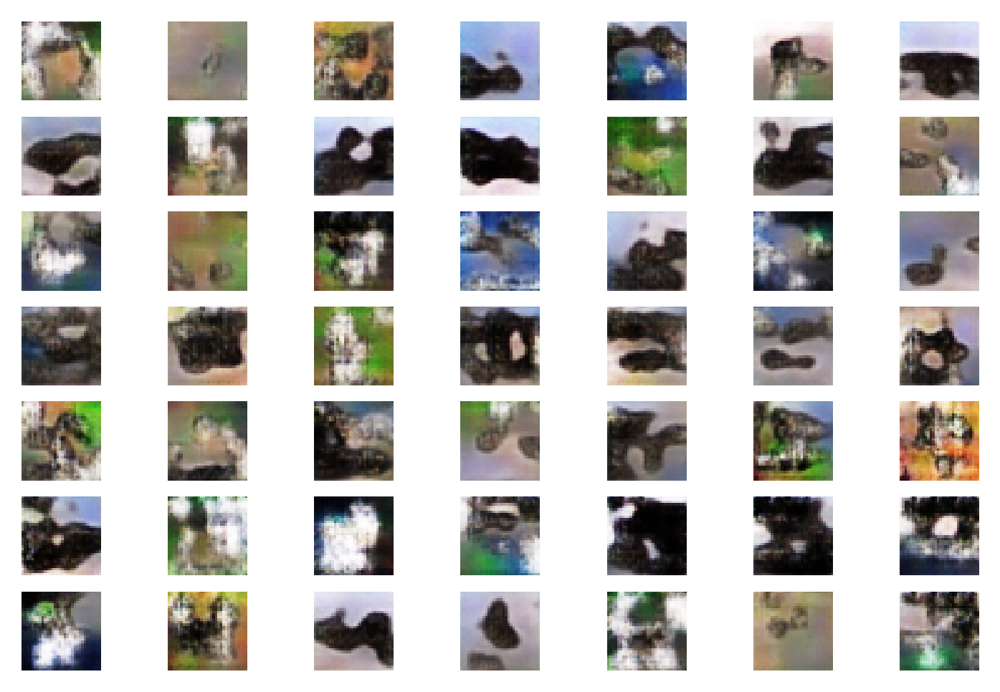

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 13, Batch: 1 of 390
 Discriminator real loss: 0.606941282749176, Discriminator Fake loss: 0.637877881526947, Generator loss: 0.8235833644866943
 Epoch: 13, Batch: 101 of 390
 Discriminator real loss: 0.6637866497039795, Discriminator Fake loss: 0.6617196202278137, Generator loss: 0.8527612686157227
 Epoch: 13, Batch: 201 of 390
 Discriminator real loss: 0.6781189441680908, Discriminator Fake loss: 0.6432653665542603, Generator loss: 0.9454097747802734
 Epoch: 13, Batch: 301 of 390
 Discriminator real loss: 0.7216498851776123, Discriminator Fake loss: 0.6059103608131409, Generator loss: 0.9196566939353943
***** Accuracy real: 51.99999809265137, fake: 86.00000143051147 *****


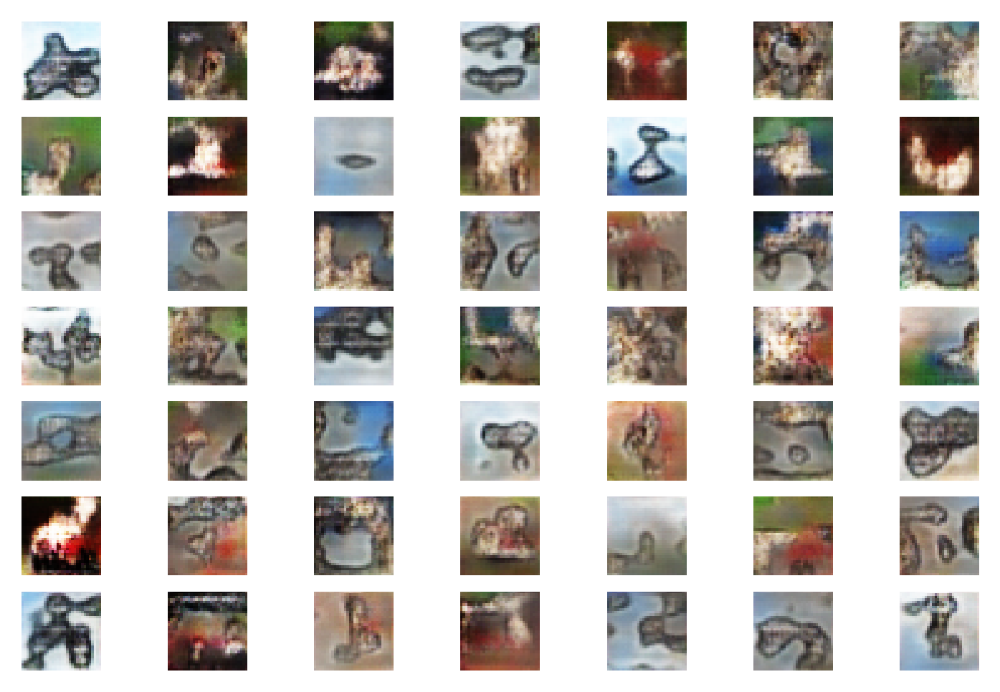

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 14, Batch: 1 of 390
 Discriminator real loss: 0.6148200631141663, Discriminator Fake loss: 0.6154689788818359, Generator loss: 0.867692232131958
 Epoch: 14, Batch: 101 of 390
 Discriminator real loss: 0.6582112312316895, Discriminator Fake loss: 0.6463262438774109, Generator loss: 0.8308054208755493
 Epoch: 14, Batch: 201 of 390
 Discriminator real loss: 0.6203954219818115, Discriminator Fake loss: 0.6465072631835938, Generator loss: 0.8253601789474487
 Epoch: 14, Batch: 301 of 390
 Discriminator real loss: 0.6198218464851379, Discriminator Fake loss: 0.5678322911262512, Generator loss: 1.0315455198287964
***** Accuracy real: 51.99999809265137, fake: 81.99999928474426 *****


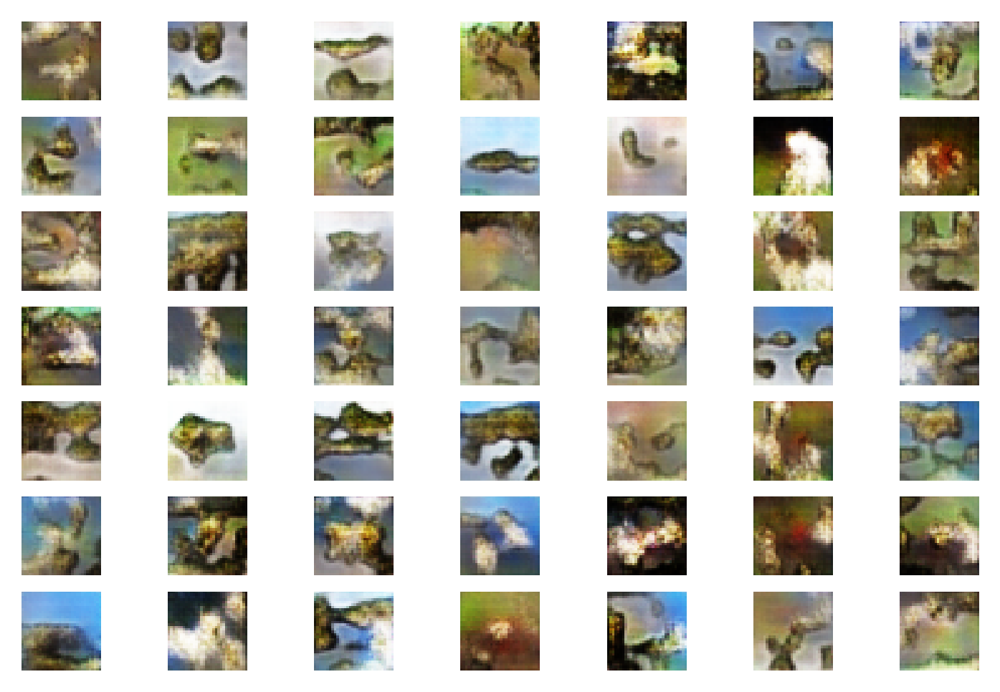

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 15, Batch: 1 of 390
 Discriminator real loss: 0.5930917859077454, Discriminator Fake loss: 0.6453408002853394, Generator loss: 0.8318659663200378
 Epoch: 15, Batch: 101 of 390
 Discriminator real loss: 0.5704564452171326, Discriminator Fake loss: 0.6087096929550171, Generator loss: 0.9233064651489258
 Epoch: 15, Batch: 201 of 390
 Discriminator real loss: 0.6275888681411743, Discriminator Fake loss: 0.6601788401603699, Generator loss: 0.909379243850708
 Epoch: 15, Batch: 301 of 390
 Discriminator real loss: 0.6929678916931152, Discriminator Fake loss: 0.5975850820541382, Generator loss: 0.8785446882247925
***** Accuracy real: 48.66666793823242, fake: 81.99999928474426 *****


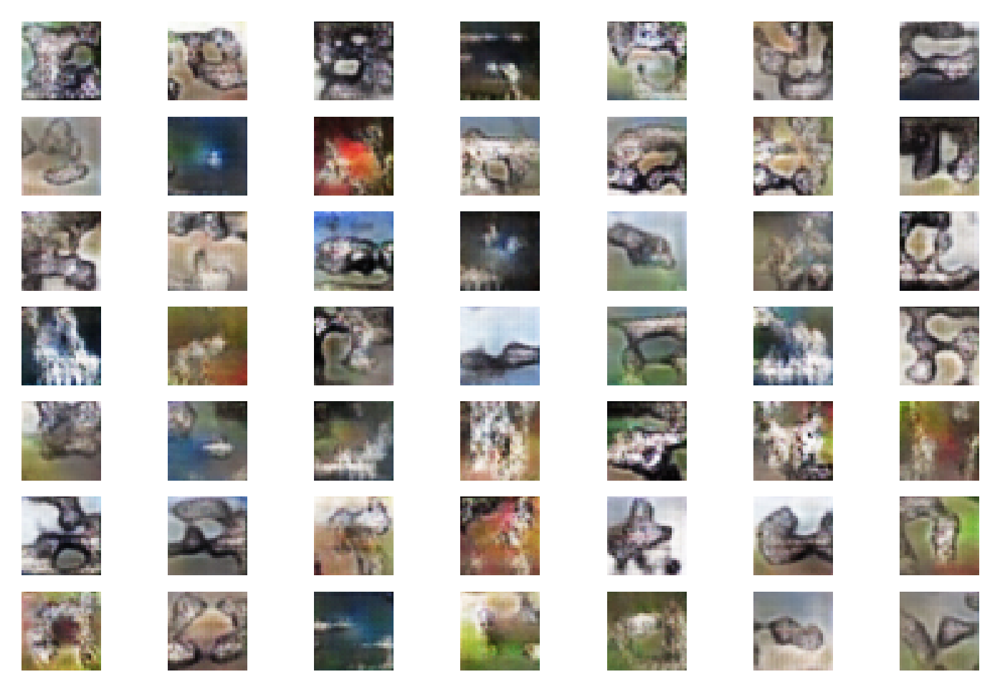

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 16, Batch: 1 of 390
 Discriminator real loss: 0.614541232585907, Discriminator Fake loss: 0.6167281866073608, Generator loss: 0.8401662707328796
 Epoch: 16, Batch: 101 of 390
 Discriminator real loss: 0.6927870512008667, Discriminator Fake loss: 0.6139465570449829, Generator loss: 0.9926332235336304
 Epoch: 16, Batch: 201 of 390
 Discriminator real loss: 0.729535698890686, Discriminator Fake loss: 0.6136691570281982, Generator loss: 0.9318448305130005
 Epoch: 16, Batch: 301 of 390
 Discriminator real loss: 0.6556317806243896, Discriminator Fake loss: 0.6218384504318237, Generator loss: 0.8638503551483154
***** Accuracy real: 56.66666626930237, fake: 52.666664123535156 *****


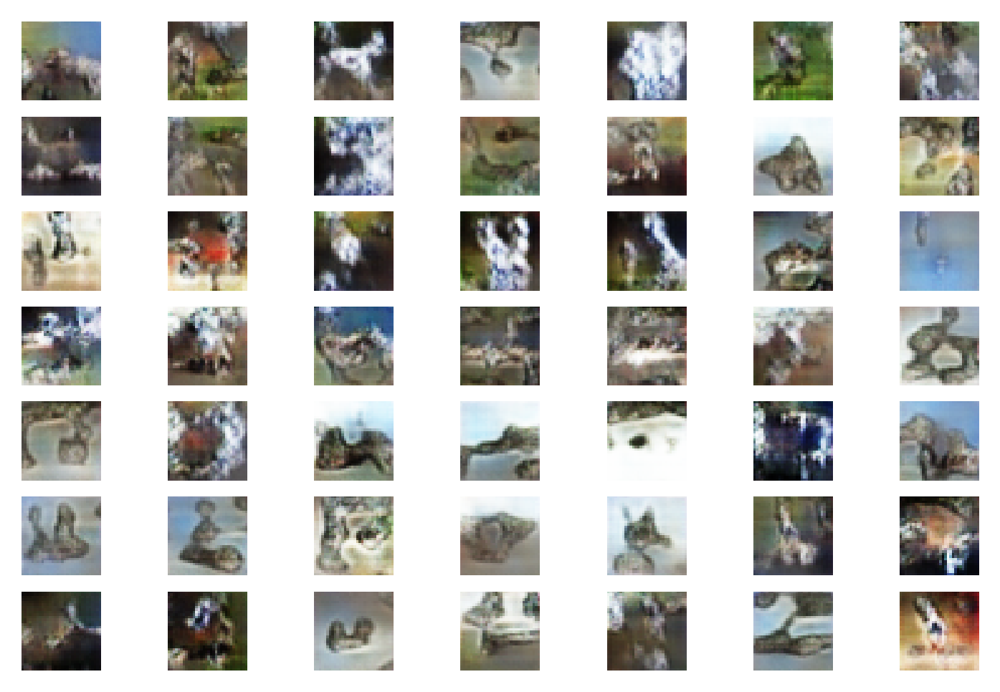

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 17, Batch: 1 of 390
 Discriminator real loss: 0.7042086124420166, Discriminator Fake loss: 0.7221534252166748, Generator loss: 0.8841071128845215
 Epoch: 17, Batch: 101 of 390
 Discriminator real loss: 0.6865100860595703, Discriminator Fake loss: 0.6256488561630249, Generator loss: 0.8499202132225037
 Epoch: 17, Batch: 201 of 390
 Discriminator real loss: 0.6212003231048584, Discriminator Fake loss: 0.6331552863121033, Generator loss: 0.9383299350738525
 Epoch: 17, Batch: 301 of 390
 Discriminator real loss: 0.5713138580322266, Discriminator Fake loss: 0.7066657543182373, Generator loss: 0.7897060513496399
***** Accuracy real: 43.99999976158142, fake: 74.6666669845581 *****


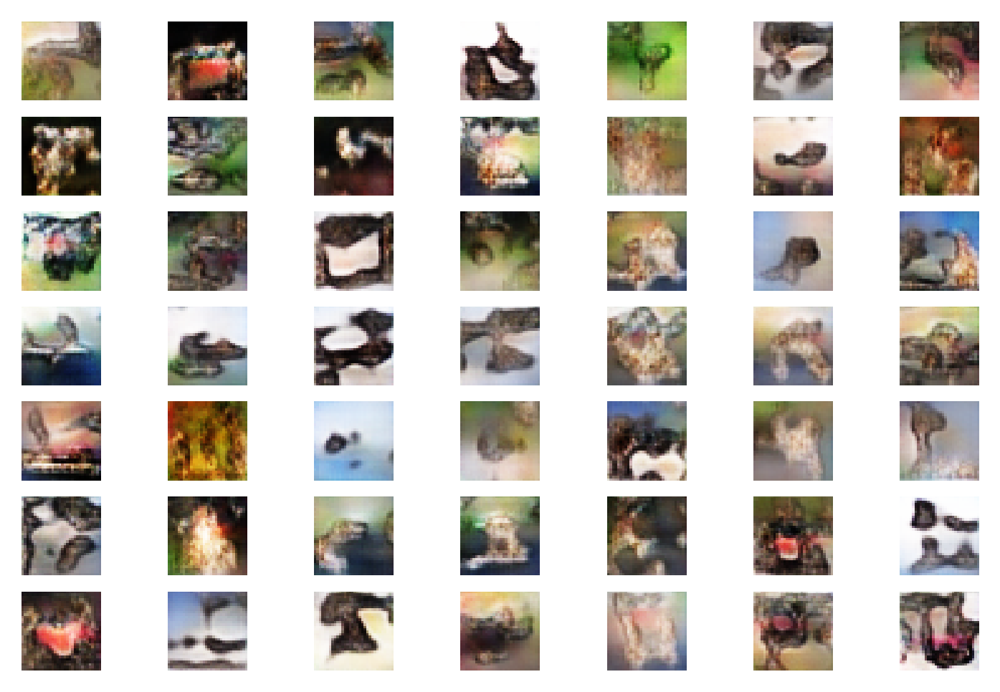

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 18, Batch: 1 of 390
 Discriminator real loss: 0.6178534030914307, Discriminator Fake loss: 0.7010321617126465, Generator loss: 0.8684554100036621
 Epoch: 18, Batch: 101 of 390
 Discriminator real loss: 0.6703271269798279, Discriminator Fake loss: 0.6258790493011475, Generator loss: 0.8518972992897034
 Epoch: 18, Batch: 201 of 390
 Discriminator real loss: 0.610535740852356, Discriminator Fake loss: 0.6234060525894165, Generator loss: 0.8801915049552917
 Epoch: 18, Batch: 301 of 390
 Discriminator real loss: 0.6971473693847656, Discriminator Fake loss: 0.5884784460067749, Generator loss: 0.9460957050323486
***** Accuracy real: 51.99999809265137, fake: 78.66666913032532 *****


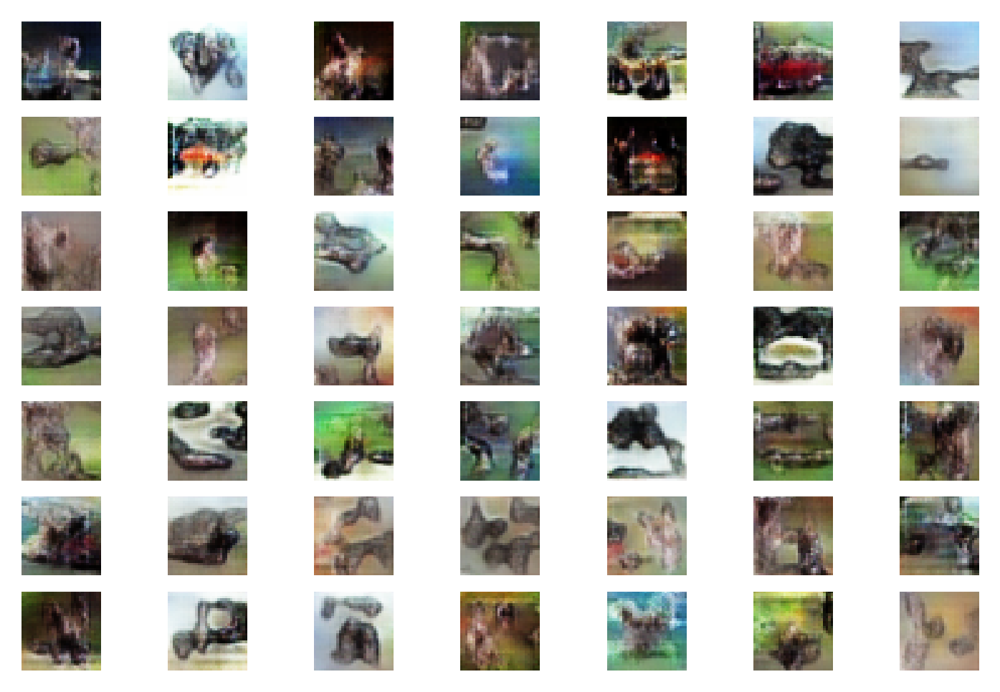

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 19, Batch: 1 of 390
 Discriminator real loss: 0.5914275050163269, Discriminator Fake loss: 0.6033510565757751, Generator loss: 0.8904631733894348
 Epoch: 19, Batch: 101 of 390
 Discriminator real loss: 0.5752860903739929, Discriminator Fake loss: 0.5505393743515015, Generator loss: 0.9727212190628052
 Epoch: 19, Batch: 201 of 390
 Discriminator real loss: 0.6482517719268799, Discriminator Fake loss: 0.649824857711792, Generator loss: 0.826262354850769
 Epoch: 19, Batch: 301 of 390
 Discriminator real loss: 0.6469901204109192, Discriminator Fake loss: 0.6192378997802734, Generator loss: 0.9638807773590088
***** Accuracy real: 56.00000023841858, fake: 57.999998331069946 *****


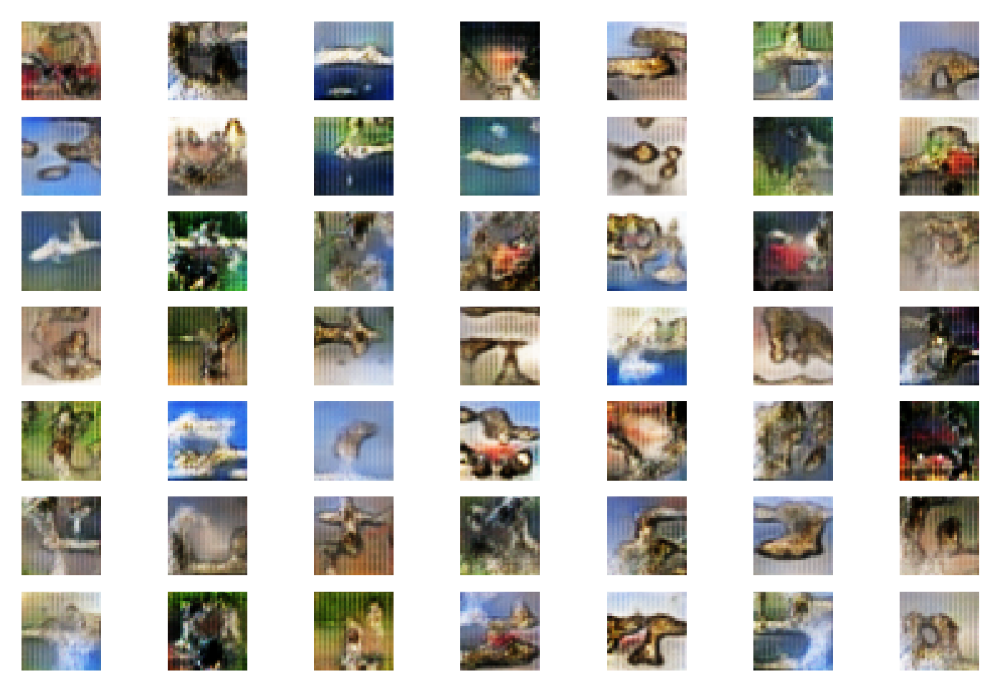

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 20, Batch: 1 of 390
 Discriminator real loss: 0.6534543633460999, Discriminator Fake loss: 0.7915295362472534, Generator loss: 0.8535356521606445
 Epoch: 20, Batch: 101 of 390
 Discriminator real loss: 0.703356146812439, Discriminator Fake loss: 0.7120992541313171, Generator loss: 0.8343016505241394
 Epoch: 20, Batch: 201 of 390
 Discriminator real loss: 0.6797899007797241, Discriminator Fake loss: 0.6465325951576233, Generator loss: 0.817692756652832
 Epoch: 20, Batch: 301 of 390
 Discriminator real loss: 0.6760108470916748, Discriminator Fake loss: 0.6852431893348694, Generator loss: 0.8982301354408264
***** Accuracy real: 45.33333480358124, fake: 80.66666722297668 *****


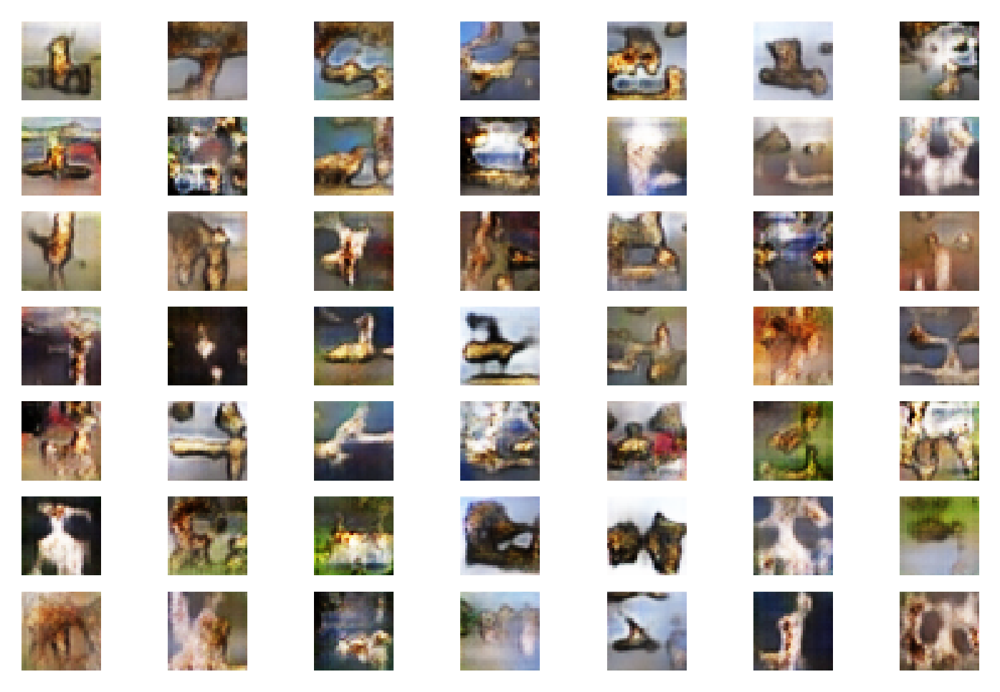

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 21, Batch: 1 of 390
 Discriminator real loss: 0.6273510456085205, Discriminator Fake loss: 0.6613864898681641, Generator loss: 0.9083582162857056
 Epoch: 21, Batch: 101 of 390
 Discriminator real loss: 0.6532115340232849, Discriminator Fake loss: 0.7166665196418762, Generator loss: 0.8456064462661743
 Epoch: 21, Batch: 201 of 390
 Discriminator real loss: 0.6986119747161865, Discriminator Fake loss: 0.6335564851760864, Generator loss: 0.9606071710586548
 Epoch: 21, Batch: 301 of 390
 Discriminator real loss: 0.7013342380523682, Discriminator Fake loss: 0.6229591965675354, Generator loss: 0.8521071672439575
***** Accuracy real: 44.66666579246521, fake: 69.9999988079071 *****


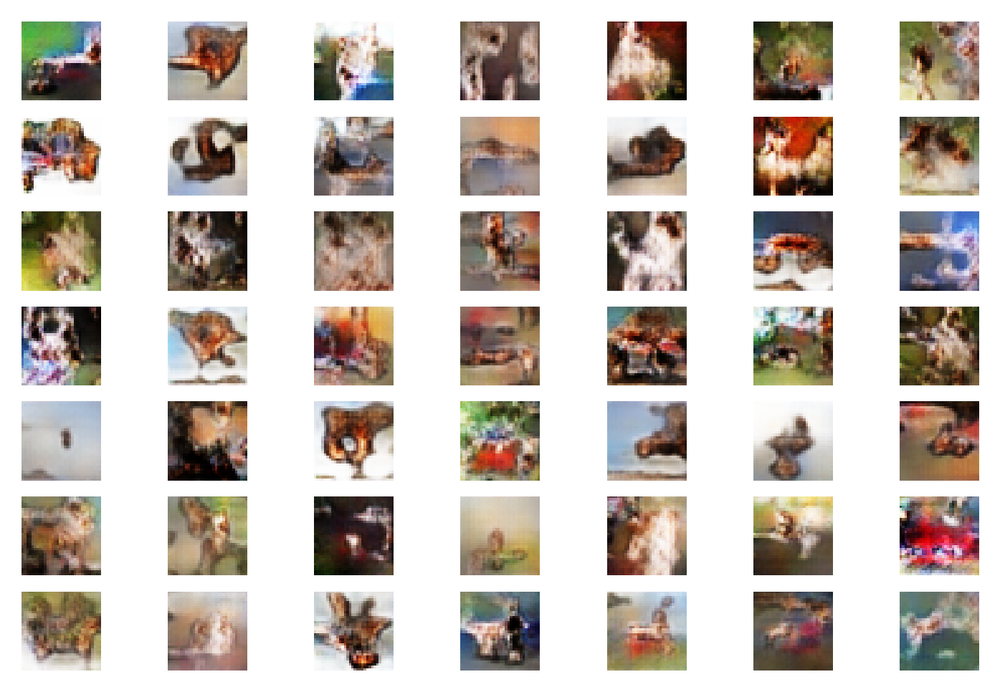

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 22, Batch: 1 of 390
 Discriminator real loss: 0.6461013555526733, Discriminator Fake loss: 0.6535094380378723, Generator loss: 0.8891026973724365
 Epoch: 22, Batch: 101 of 390
 Discriminator real loss: 0.5994642972946167, Discriminator Fake loss: 0.5892564058303833, Generator loss: 0.9056627154350281
 Epoch: 22, Batch: 201 of 390
 Discriminator real loss: 0.683381199836731, Discriminator Fake loss: 0.6515056490898132, Generator loss: 0.8518879413604736
 Epoch: 22, Batch: 301 of 390
 Discriminator real loss: 0.6163346171379089, Discriminator Fake loss: 0.6718156933784485, Generator loss: 0.917277455329895
***** Accuracy real: 37.99999952316284, fake: 72.66666889190674 *****


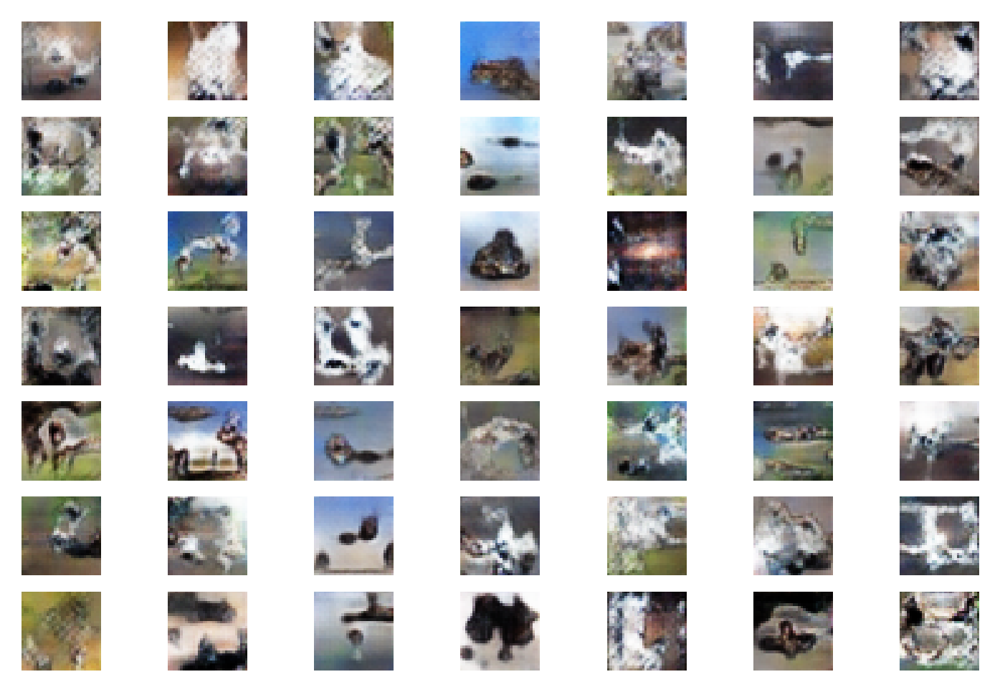

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 23, Batch: 1 of 390
 Discriminator real loss: 0.6308040618896484, Discriminator Fake loss: 0.6595782041549683, Generator loss: 0.9176894426345825
 Epoch: 23, Batch: 101 of 390
 Discriminator real loss: 0.4732149839401245, Discriminator Fake loss: 0.7185288667678833, Generator loss: 0.8184298872947693
 Epoch: 23, Batch: 201 of 390
 Discriminator real loss: 0.6490277051925659, Discriminator Fake loss: 0.6202105283737183, Generator loss: 0.8181455135345459
 Epoch: 23, Batch: 301 of 390
 Discriminator real loss: 0.6220777034759521, Discriminator Fake loss: 0.6788495182991028, Generator loss: 0.8160630464553833
***** Accuracy real: 77.33333110809326, fake: 66.66666865348816 *****


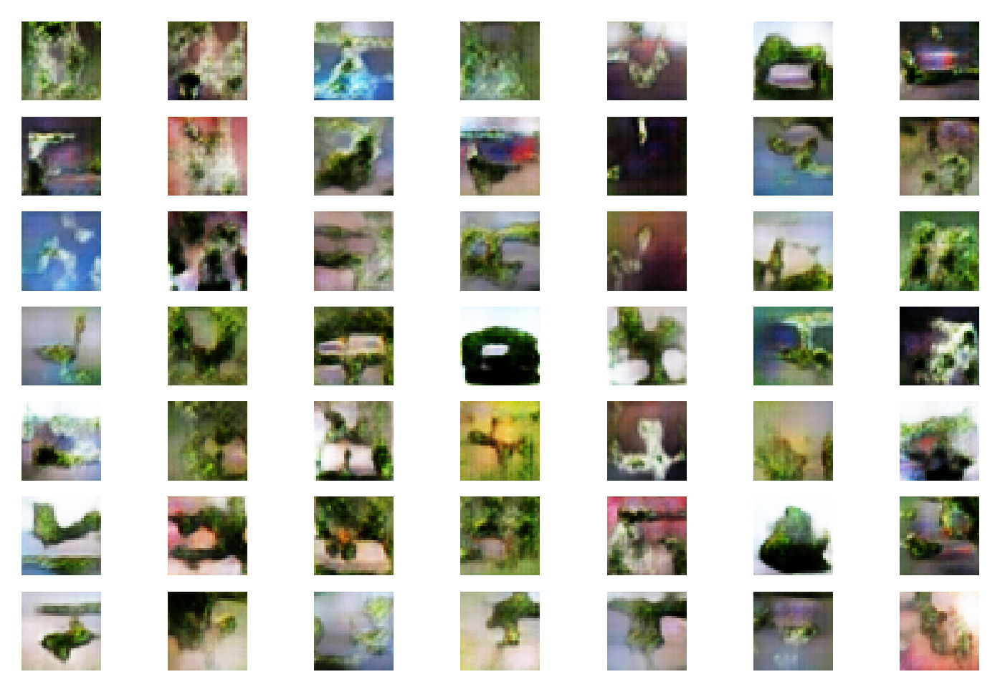

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 24, Batch: 1 of 390
 Discriminator real loss: 0.633283793926239, Discriminator Fake loss: 0.7073550224304199, Generator loss: 0.8703033924102783
 Epoch: 24, Batch: 101 of 390
 Discriminator real loss: 0.8020322322845459, Discriminator Fake loss: 0.6356847286224365, Generator loss: 0.9776583909988403
 Epoch: 24, Batch: 201 of 390
 Discriminator real loss: 0.6580315828323364, Discriminator Fake loss: 0.6331848502159119, Generator loss: 0.8174062967300415
 Epoch: 24, Batch: 301 of 390
 Discriminator real loss: 0.6135585308074951, Discriminator Fake loss: 0.6949824094772339, Generator loss: 0.8645245432853699
***** Accuracy real: 57.33333230018616, fake: 73.33333492279053 *****


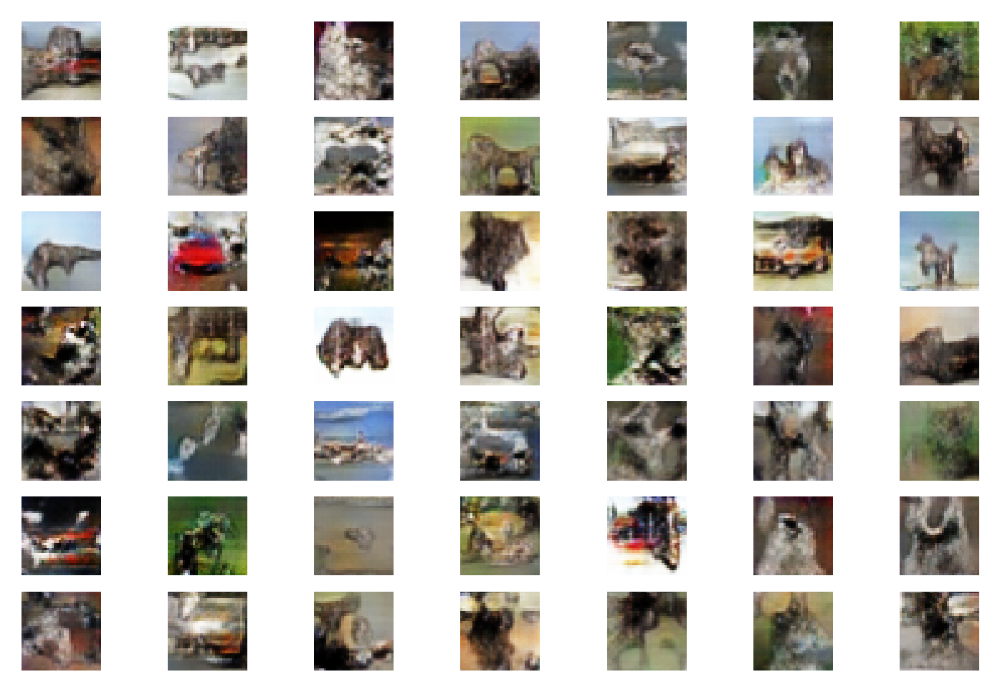

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 25, Batch: 1 of 390
 Discriminator real loss: 0.648252546787262, Discriminator Fake loss: 0.674754798412323, Generator loss: 0.8532899022102356
 Epoch: 25, Batch: 101 of 390
 Discriminator real loss: 0.5951934456825256, Discriminator Fake loss: 0.7243729829788208, Generator loss: 0.868375837802887
 Epoch: 25, Batch: 201 of 390
 Discriminator real loss: 0.6154992580413818, Discriminator Fake loss: 0.6515284776687622, Generator loss: 0.8226358890533447
 Epoch: 25, Batch: 301 of 390
 Discriminator real loss: 0.7335880398750305, Discriminator Fake loss: 0.5753093957901001, Generator loss: 0.8525599837303162
***** Accuracy real: 59.333330392837524, fake: 78.66666913032532 *****


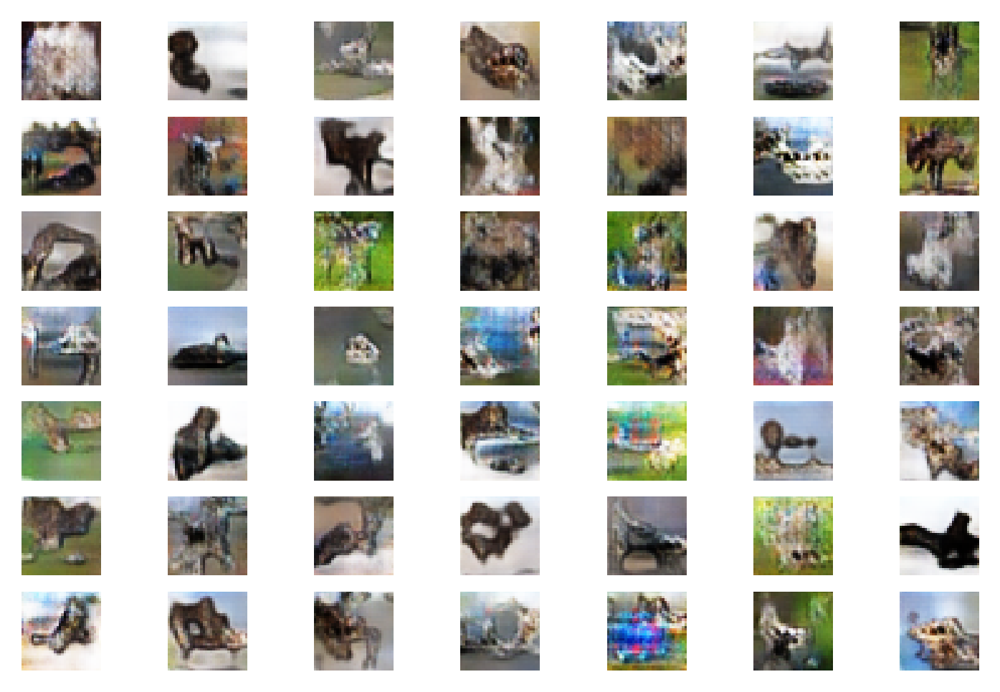

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 26, Batch: 1 of 390
 Discriminator real loss: 0.6086081862449646, Discriminator Fake loss: 0.7126098871231079, Generator loss: 0.9083766341209412
 Epoch: 26, Batch: 101 of 390
 Discriminator real loss: 0.6753028631210327, Discriminator Fake loss: 0.6261652112007141, Generator loss: 0.8403531312942505
 Epoch: 26, Batch: 201 of 390
 Discriminator real loss: 0.7796241044998169, Discriminator Fake loss: 0.5605418086051941, Generator loss: 0.9756646156311035
 Epoch: 26, Batch: 301 of 390
 Discriminator real loss: 0.6537460088729858, Discriminator Fake loss: 0.5987721681594849, Generator loss: 0.8513257503509521
***** Accuracy real: 57.33333230018616, fake: 78.66666913032532 *****


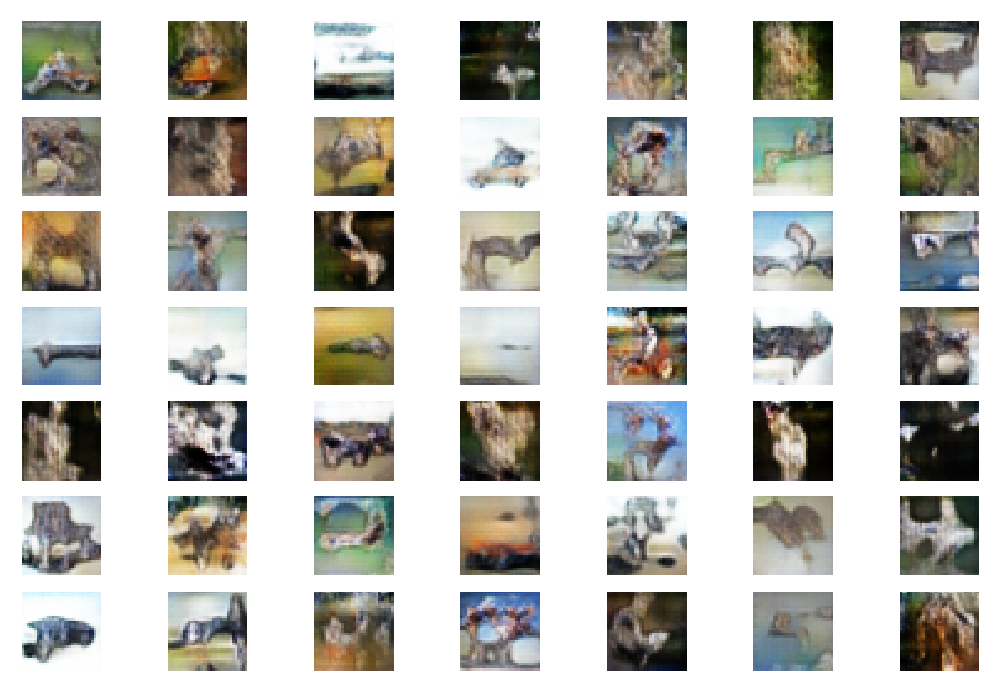

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 27, Batch: 1 of 390
 Discriminator real loss: 0.6225865483283997, Discriminator Fake loss: 0.7481032013893127, Generator loss: 0.8645086884498596
 Epoch: 27, Batch: 101 of 390
 Discriminator real loss: 0.6779853701591492, Discriminator Fake loss: 0.6578114628791809, Generator loss: 0.8305930495262146
 Epoch: 27, Batch: 201 of 390
 Discriminator real loss: 0.7074044942855835, Discriminator Fake loss: 0.6509981155395508, Generator loss: 0.8548753261566162
 Epoch: 27, Batch: 301 of 390
 Discriminator real loss: 0.668228030204773, Discriminator Fake loss: 0.6511385440826416, Generator loss: 0.8521380424499512
***** Accuracy real: 50.0, fake: 82.66666531562805 *****


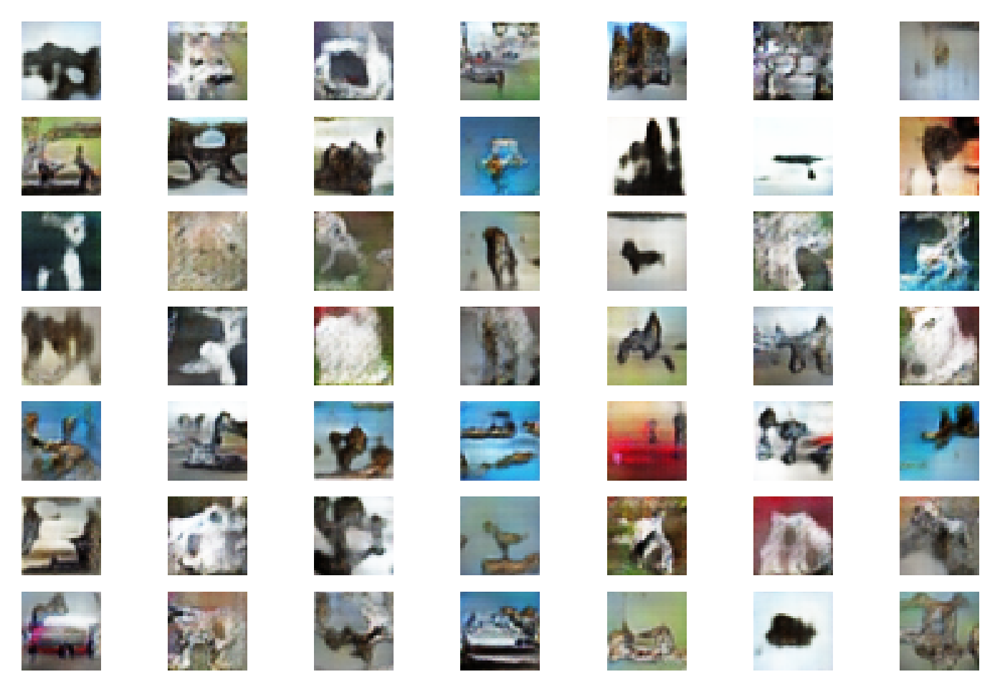

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 28, Batch: 1 of 390
 Discriminator real loss: 0.5979869365692139, Discriminator Fake loss: 0.6040906310081482, Generator loss: 0.8623517751693726
 Epoch: 28, Batch: 101 of 390
 Discriminator real loss: 0.6621177196502686, Discriminator Fake loss: 0.6769896149635315, Generator loss: 0.8610504865646362
 Epoch: 28, Batch: 201 of 390
 Discriminator real loss: 0.6435331106185913, Discriminator Fake loss: 0.6501520872116089, Generator loss: 0.8296777606010437
 Epoch: 28, Batch: 301 of 390
 Discriminator real loss: 0.648341178894043, Discriminator Fake loss: 0.6020447015762329, Generator loss: 0.904167890548706
***** Accuracy real: 51.33333206176758, fake: 74.00000095367432 *****


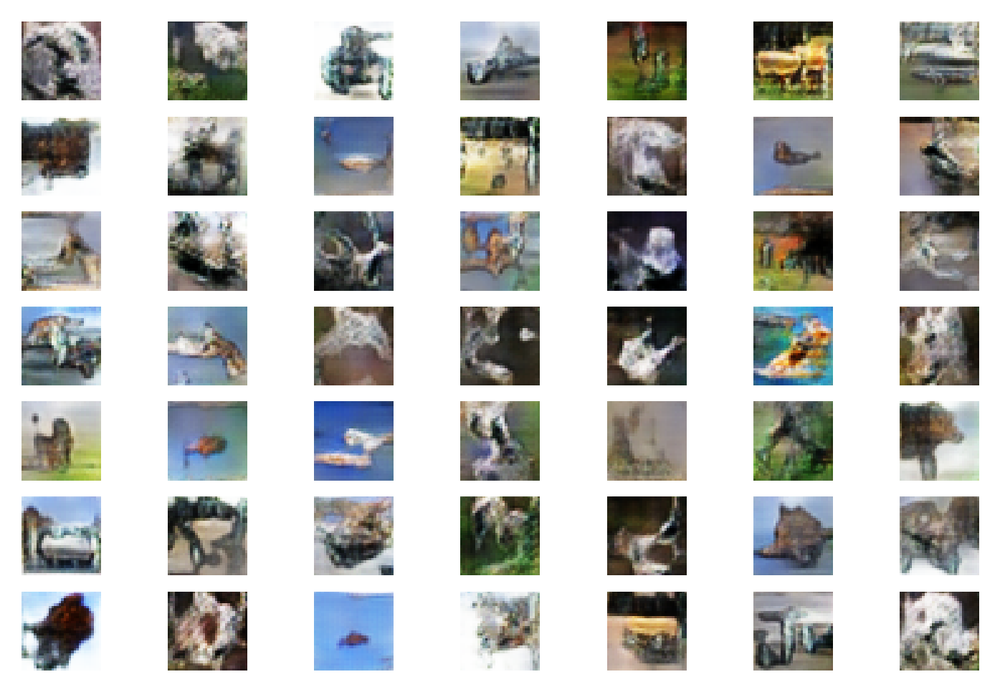

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 29, Batch: 1 of 390
 Discriminator real loss: 0.6494536399841309, Discriminator Fake loss: 0.7115130424499512, Generator loss: 0.8435673713684082
 Epoch: 29, Batch: 101 of 390
 Discriminator real loss: 0.6247680187225342, Discriminator Fake loss: 0.6792359352111816, Generator loss: 0.8304415941238403
 Epoch: 29, Batch: 201 of 390
 Discriminator real loss: 0.6346272826194763, Discriminator Fake loss: 0.753081738948822, Generator loss: 0.8780766725540161
 Epoch: 29, Batch: 301 of 390
 Discriminator real loss: 0.6405550837516785, Discriminator Fake loss: 0.619614839553833, Generator loss: 0.8276078701019287
***** Accuracy real: 40.66666662693024, fake: 82.66666531562805 *****


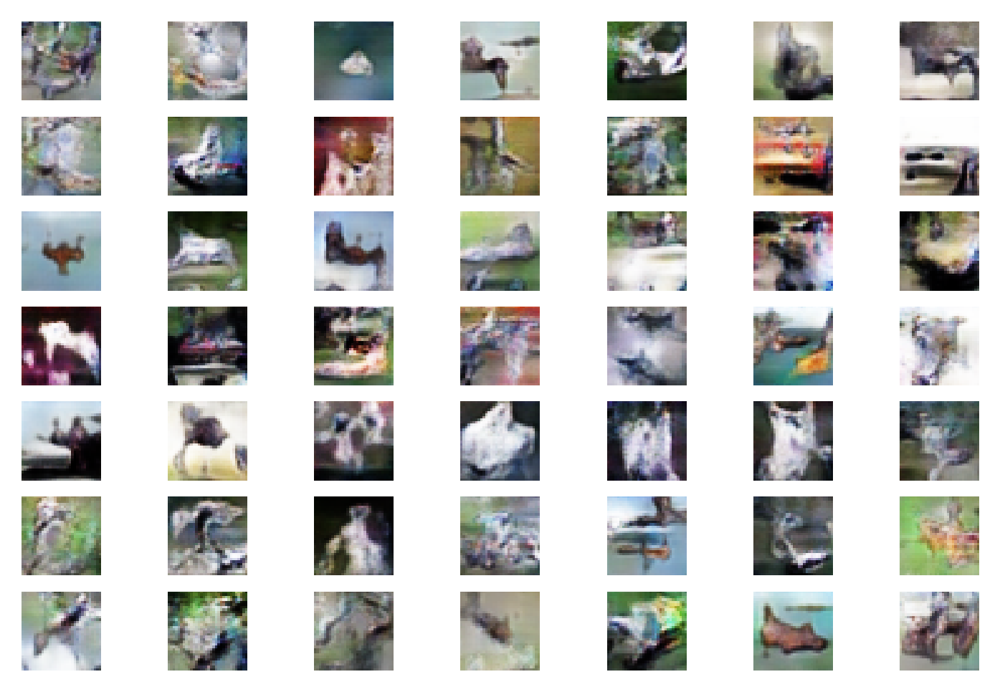

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 30, Batch: 1 of 390
 Discriminator real loss: 0.6224002242088318, Discriminator Fake loss: 0.6143524646759033, Generator loss: 0.8882368206977844
 Epoch: 30, Batch: 101 of 390
 Discriminator real loss: 0.6710501909255981, Discriminator Fake loss: 0.7526553869247437, Generator loss: 0.8263289332389832
 Epoch: 30, Batch: 201 of 390
 Discriminator real loss: 0.6937605142593384, Discriminator Fake loss: 0.661067008972168, Generator loss: 0.8181883692741394
 Epoch: 30, Batch: 301 of 390
 Discriminator real loss: 0.6398871541023254, Discriminator Fake loss: 0.6578744649887085, Generator loss: 0.8343809843063354
***** Accuracy real: 43.99999976158142, fake: 76.66666507720947 *****


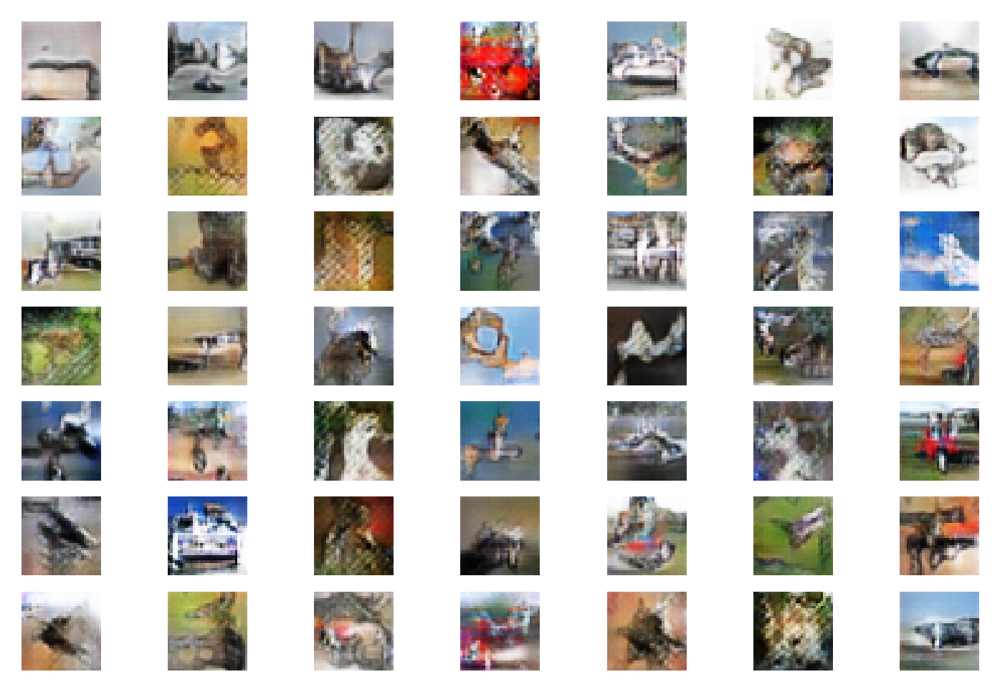

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 31, Batch: 1 of 390
 Discriminator real loss: 0.6434195041656494, Discriminator Fake loss: 0.684609055519104, Generator loss: 0.8252253532409668
 Epoch: 31, Batch: 101 of 390
 Discriminator real loss: 0.6866422295570374, Discriminator Fake loss: 0.5961515307426453, Generator loss: 0.8499906659126282
 Epoch: 31, Batch: 201 of 390
 Discriminator real loss: 0.6834263801574707, Discriminator Fake loss: 0.6249428987503052, Generator loss: 0.8714336156845093
 Epoch: 31, Batch: 301 of 390
 Discriminator real loss: 0.6559447646141052, Discriminator Fake loss: 0.6620179414749146, Generator loss: 0.8058420419692993
***** Accuracy real: 49.33333396911621, fake: 74.6666669845581 *****


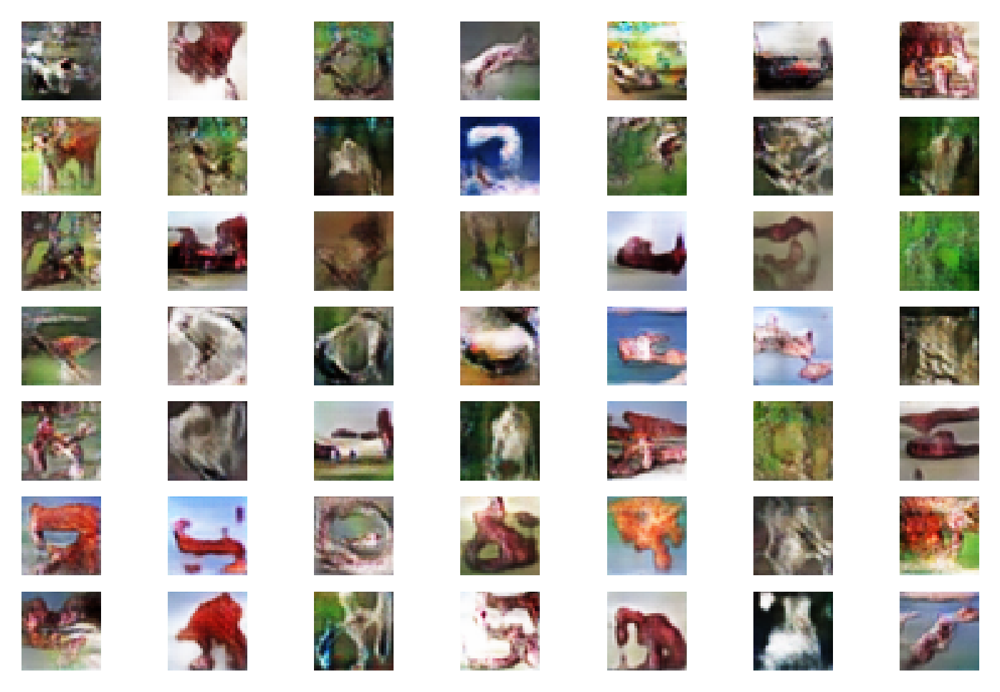

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 32, Batch: 1 of 390
 Discriminator real loss: 0.6631022095680237, Discriminator Fake loss: 0.6846517324447632, Generator loss: 0.8157745599746704
 Epoch: 32, Batch: 101 of 390
 Discriminator real loss: 0.6739377379417419, Discriminator Fake loss: 0.6852000951766968, Generator loss: 0.8189457654953003
 Epoch: 32, Batch: 201 of 390
 Discriminator real loss: 0.7259314060211182, Discriminator Fake loss: 0.6586852073669434, Generator loss: 0.8659634590148926
 Epoch: 32, Batch: 301 of 390
 Discriminator real loss: 0.6878950595855713, Discriminator Fake loss: 0.7132613658905029, Generator loss: 0.8132059574127197
***** Accuracy real: 64.66666460037231, fake: 69.33333277702332 *****


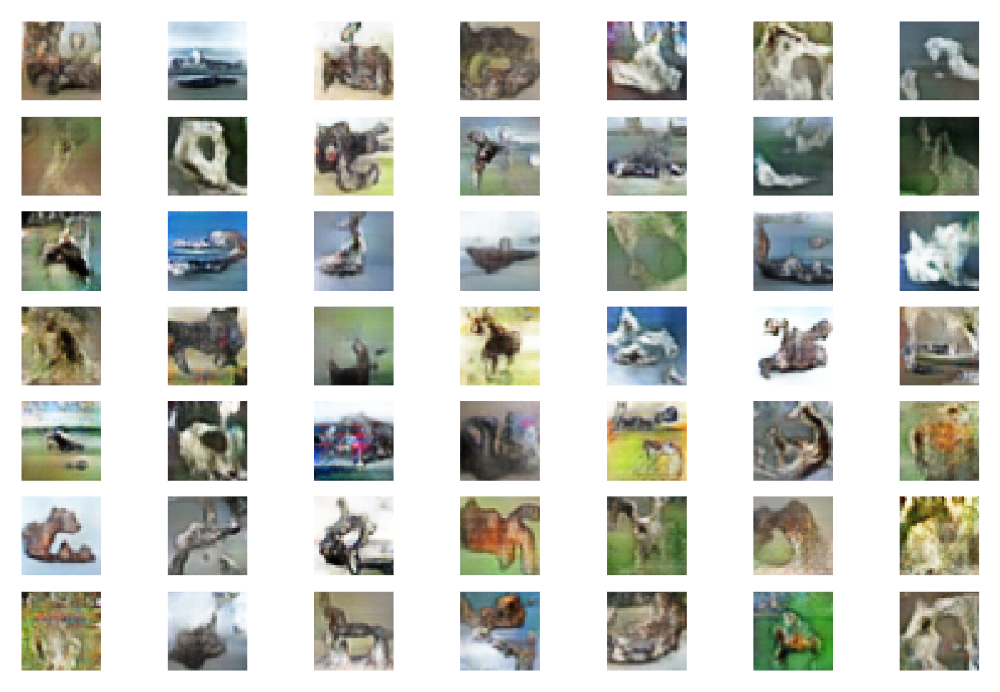

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 33, Batch: 1 of 390
 Discriminator real loss: 0.6310775876045227, Discriminator Fake loss: 0.6855638027191162, Generator loss: 0.8041898012161255
 Epoch: 33, Batch: 101 of 390
 Discriminator real loss: 0.6587292551994324, Discriminator Fake loss: 0.7279636859893799, Generator loss: 0.8054536581039429
 Epoch: 33, Batch: 201 of 390
 Discriminator real loss: 0.6725626587867737, Discriminator Fake loss: 0.6811277866363525, Generator loss: 0.8110790848731995
 Epoch: 33, Batch: 301 of 390
 Discriminator real loss: 0.6623008251190186, Discriminator Fake loss: 0.6608476638793945, Generator loss: 0.8419864177703857
***** Accuracy real: 41.333332657814026, fake: 83.33333134651184 *****


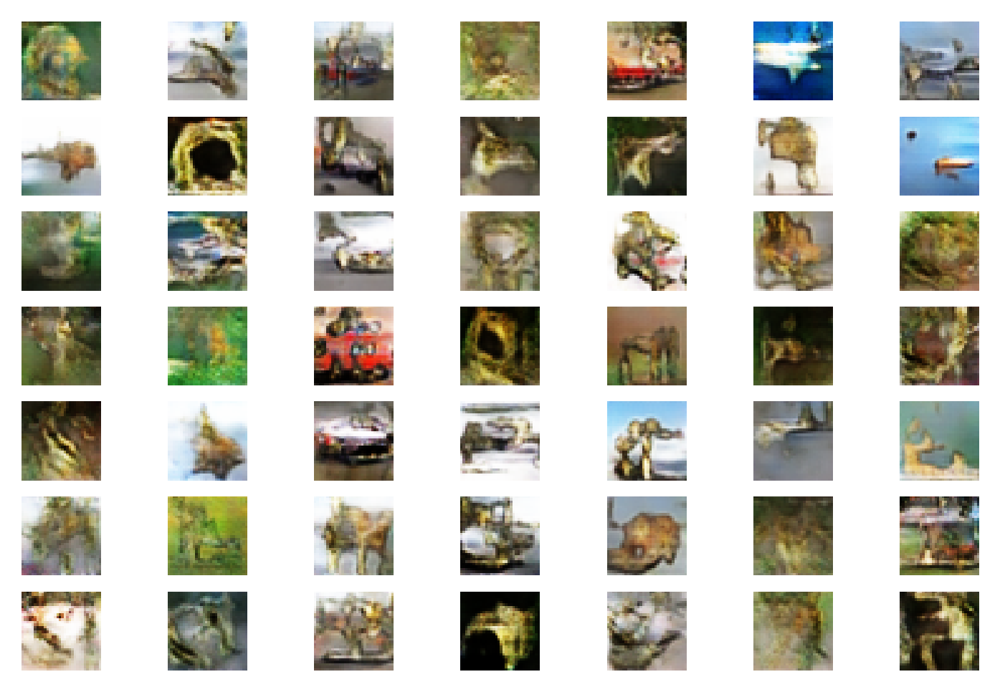

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 34, Batch: 1 of 390
 Discriminator real loss: 0.6286163330078125, Discriminator Fake loss: 0.6266117691993713, Generator loss: 0.8609792590141296
 Epoch: 34, Batch: 101 of 390
 Discriminator real loss: 0.6694213151931763, Discriminator Fake loss: 0.6566332578659058, Generator loss: 0.8400791883468628
 Epoch: 34, Batch: 201 of 390
 Discriminator real loss: 0.6836074590682983, Discriminator Fake loss: 0.6573679447174072, Generator loss: 0.8169512748718262
 Epoch: 34, Batch: 301 of 390
 Discriminator real loss: 0.6914408802986145, Discriminator Fake loss: 0.6125611066818237, Generator loss: 0.8280034065246582
***** Accuracy real: 43.99999976158142, fake: 86.00000143051147 *****


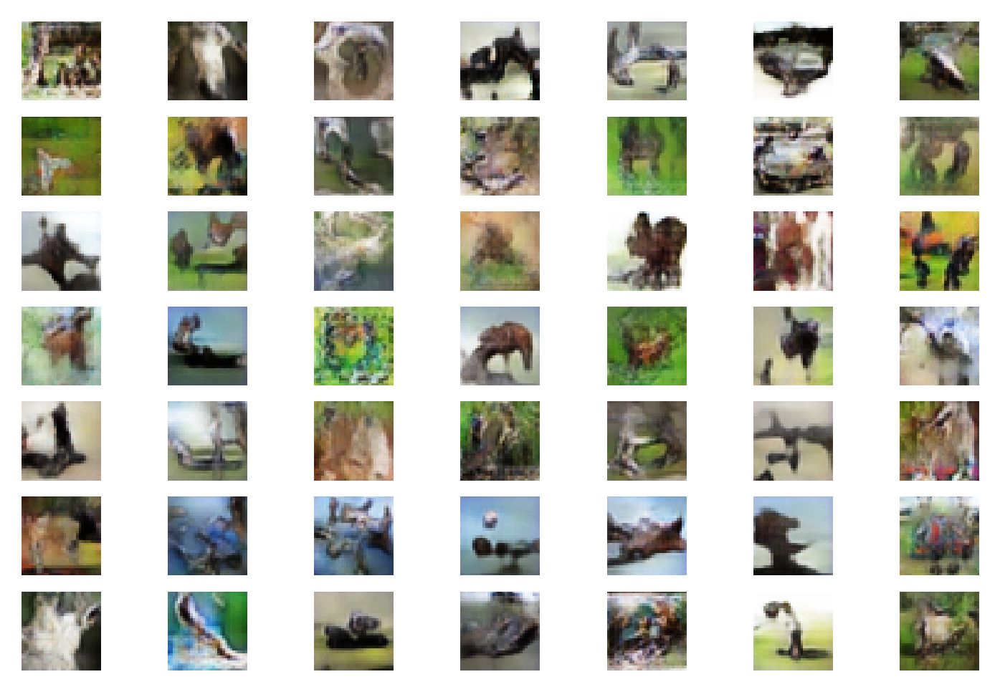

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 35, Batch: 1 of 390
 Discriminator real loss: 0.610558032989502, Discriminator Fake loss: 0.6422114372253418, Generator loss: 0.8595370054244995
 Epoch: 35, Batch: 101 of 390
 Discriminator real loss: 0.6387012004852295, Discriminator Fake loss: 0.6842873692512512, Generator loss: 0.8165626525878906
 Epoch: 35, Batch: 201 of 390
 Discriminator real loss: 0.695088803768158, Discriminator Fake loss: 0.6335281133651733, Generator loss: 0.8223026990890503
 Epoch: 35, Batch: 301 of 390
 Discriminator real loss: 0.6571727395057678, Discriminator Fake loss: 0.7022984027862549, Generator loss: 0.8336457014083862
***** Accuracy real: 46.00000083446503, fake: 93.99999976158142 *****


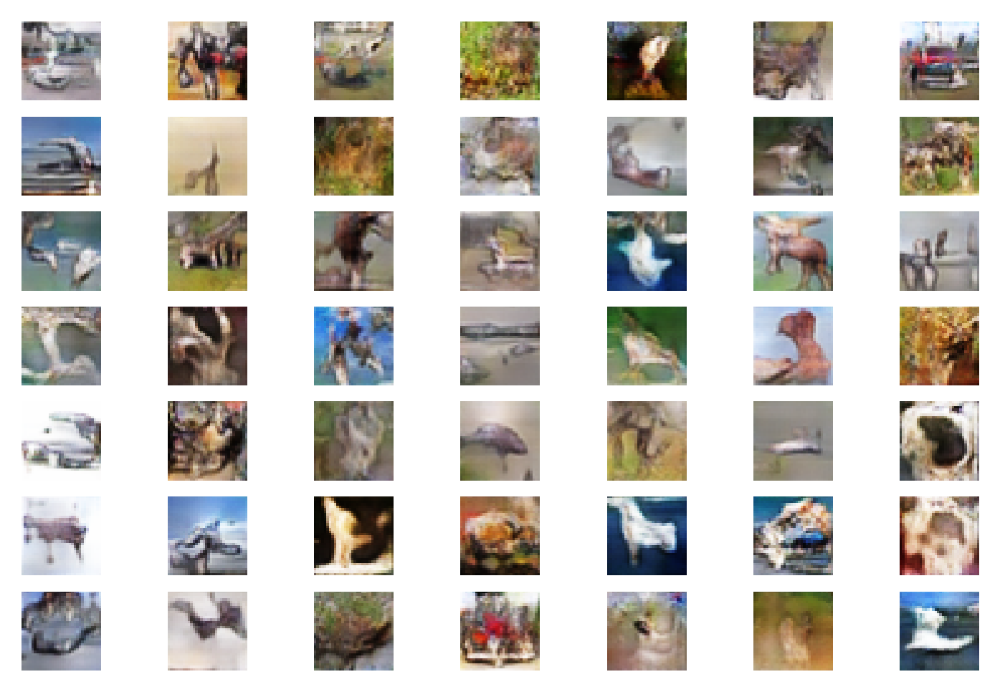

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 36, Batch: 1 of 390
 Discriminator real loss: 0.6144707798957825, Discriminator Fake loss: 0.6144441366195679, Generator loss: 0.9000383615493774
 Epoch: 36, Batch: 101 of 390
 Discriminator real loss: 0.6340691447257996, Discriminator Fake loss: 0.6548026204109192, Generator loss: 0.8064268231391907
 Epoch: 36, Batch: 201 of 390
 Discriminator real loss: 0.6760029792785645, Discriminator Fake loss: 0.5916833877563477, Generator loss: 0.8878239393234253
 Epoch: 36, Batch: 301 of 390
 Discriminator real loss: 0.6563891768455505, Discriminator Fake loss: 0.7747096419334412, Generator loss: 0.7819905281066895
***** Accuracy real: 52.666664123535156, fake: 80.0000011920929 *****


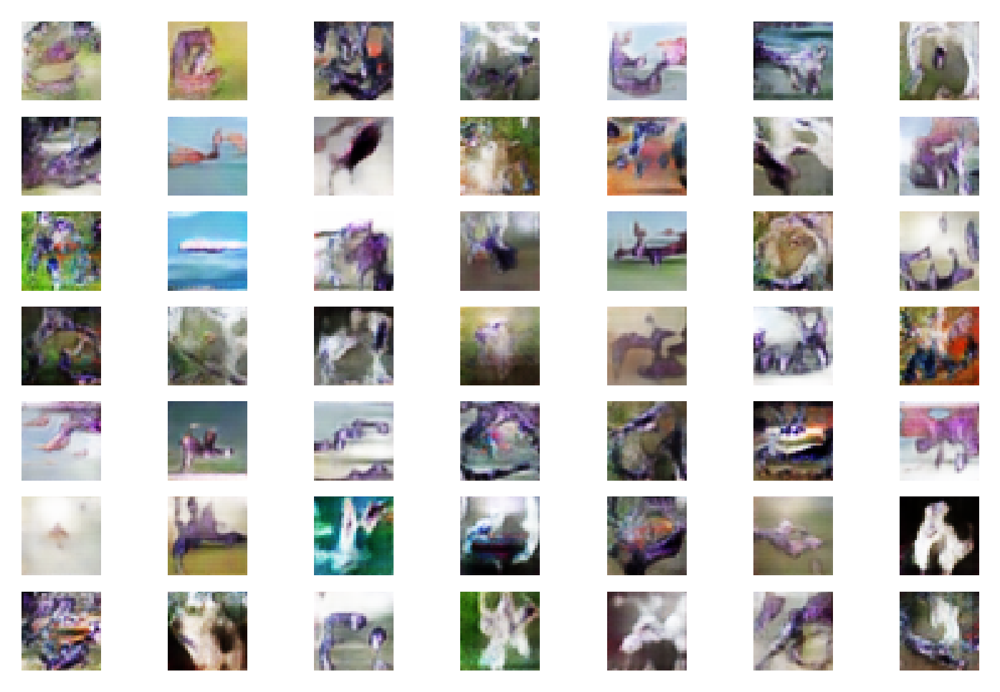

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 37, Batch: 1 of 390
 Discriminator real loss: 0.6282118558883667, Discriminator Fake loss: 0.6499383449554443, Generator loss: 0.8147933483123779
 Epoch: 37, Batch: 101 of 390
 Discriminator real loss: 0.6639218926429749, Discriminator Fake loss: 0.6741343140602112, Generator loss: 0.8678140640258789
 Epoch: 37, Batch: 201 of 390
 Discriminator real loss: 0.727108895778656, Discriminator Fake loss: 0.6592277884483337, Generator loss: 0.8009347915649414
 Epoch: 37, Batch: 301 of 390
 Discriminator real loss: 0.6542328596115112, Discriminator Fake loss: 0.5930888056755066, Generator loss: 0.8664838075637817
***** Accuracy real: 43.99999976158142, fake: 82.66666531562805 *****


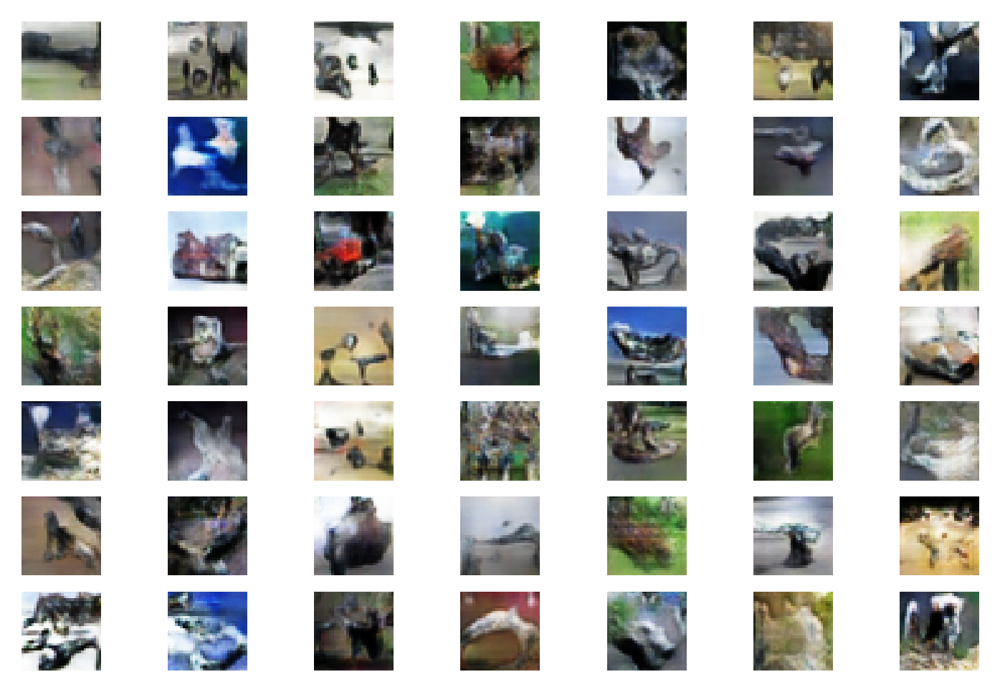

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 38, Batch: 1 of 390
 Discriminator real loss: 0.6301882266998291, Discriminator Fake loss: 0.6308778524398804, Generator loss: 0.8383554816246033
 Epoch: 38, Batch: 101 of 390
 Discriminator real loss: 0.7270829677581787, Discriminator Fake loss: 0.6148335933685303, Generator loss: 0.8739374279975891
 Epoch: 38, Batch: 201 of 390
 Discriminator real loss: 0.6706863641738892, Discriminator Fake loss: 0.6382478475570679, Generator loss: 0.866899847984314
 Epoch: 38, Batch: 301 of 390
 Discriminator real loss: 0.721326470375061, Discriminator Fake loss: 0.689643144607544, Generator loss: 0.8604508638381958
***** Accuracy real: 47.333332896232605, fake: 80.66666722297668 *****


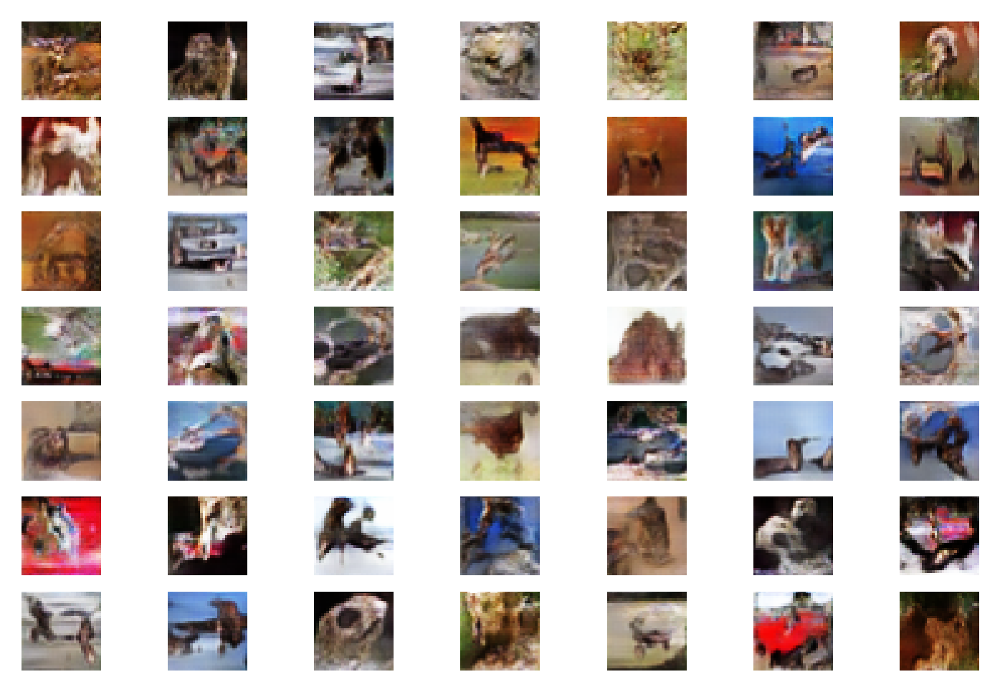

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 39, Batch: 1 of 390
 Discriminator real loss: 0.620567262172699, Discriminator Fake loss: 0.6917620897293091, Generator loss: 0.8249179124832153
 Epoch: 39, Batch: 101 of 390
 Discriminator real loss: 0.6315045356750488, Discriminator Fake loss: 0.627101719379425, Generator loss: 0.8608428835868835
 Epoch: 39, Batch: 201 of 390
 Discriminator real loss: 0.5947878360748291, Discriminator Fake loss: 0.6368786096572876, Generator loss: 0.9043319225311279
 Epoch: 39, Batch: 301 of 390
 Discriminator real loss: 0.6846596598625183, Discriminator Fake loss: 0.6229647994041443, Generator loss: 0.8392561674118042
***** Accuracy real: 65.3333306312561, fake: 66.66666865348816 *****


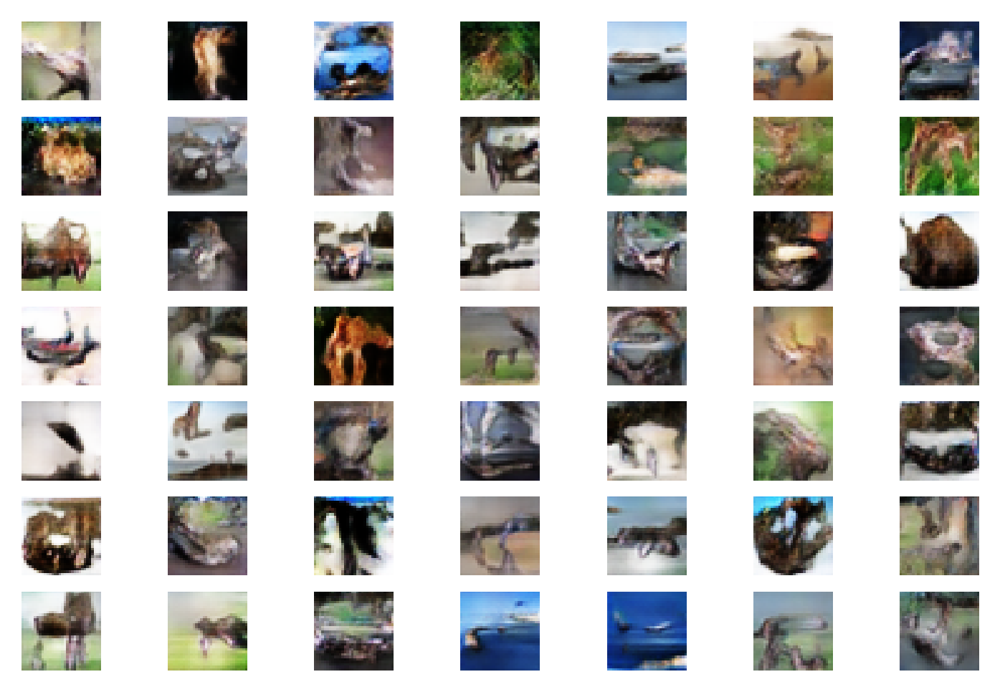

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 40, Batch: 1 of 390
 Discriminator real loss: 0.6519012451171875, Discriminator Fake loss: 0.7772485017776489, Generator loss: 0.8043972253799438
 Epoch: 40, Batch: 101 of 390
 Discriminator real loss: 0.6721503734588623, Discriminator Fake loss: 0.622301459312439, Generator loss: 0.8559368848800659
 Epoch: 40, Batch: 201 of 390
 Discriminator real loss: 0.5713671445846558, Discriminator Fake loss: 0.6320079565048218, Generator loss: 0.8980851769447327
 Epoch: 40, Batch: 301 of 390
 Discriminator real loss: 0.6416233777999878, Discriminator Fake loss: 0.71028071641922, Generator loss: 0.8405302166938782
***** Accuracy real: 47.999998927116394, fake: 81.33333325386047 *****


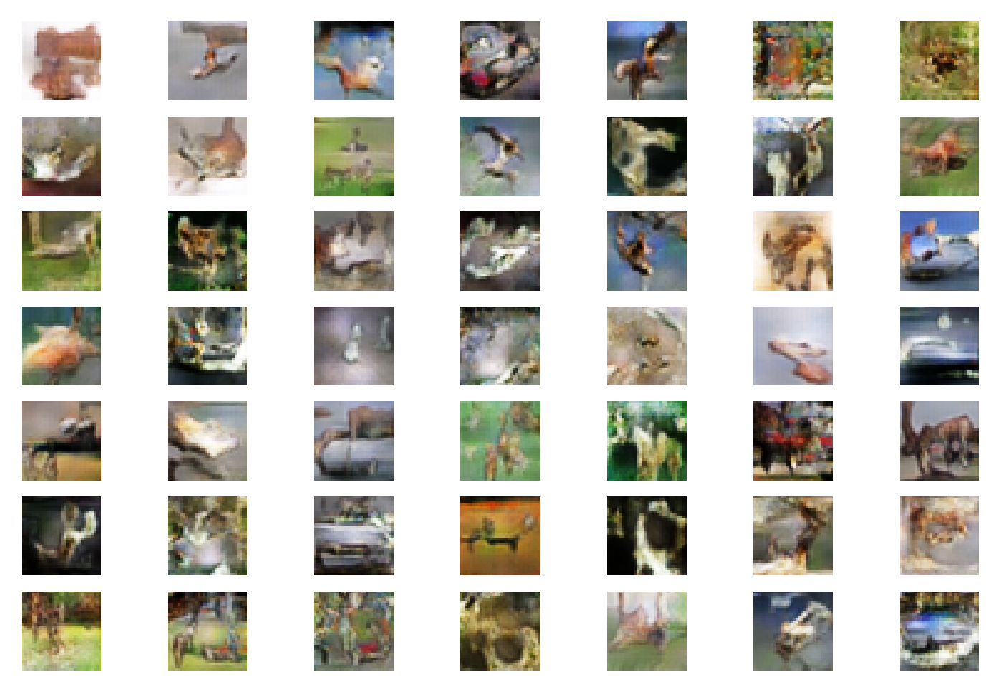

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 41, Batch: 1 of 390
 Discriminator real loss: 0.641197144985199, Discriminator Fake loss: 0.6351787447929382, Generator loss: 0.7981665134429932
 Epoch: 41, Batch: 101 of 390
 Discriminator real loss: 0.6743345260620117, Discriminator Fake loss: 0.6263481378555298, Generator loss: 0.8134701251983643
 Epoch: 41, Batch: 201 of 390
 Discriminator real loss: 0.705258846282959, Discriminator Fake loss: 0.7221125364303589, Generator loss: 0.8488397598266602
 Epoch: 41, Batch: 301 of 390
 Discriminator real loss: 0.6455418467521667, Discriminator Fake loss: 0.6494708061218262, Generator loss: 0.8503433465957642
***** Accuracy real: 46.666666865348816, fake: 74.00000095367432 *****


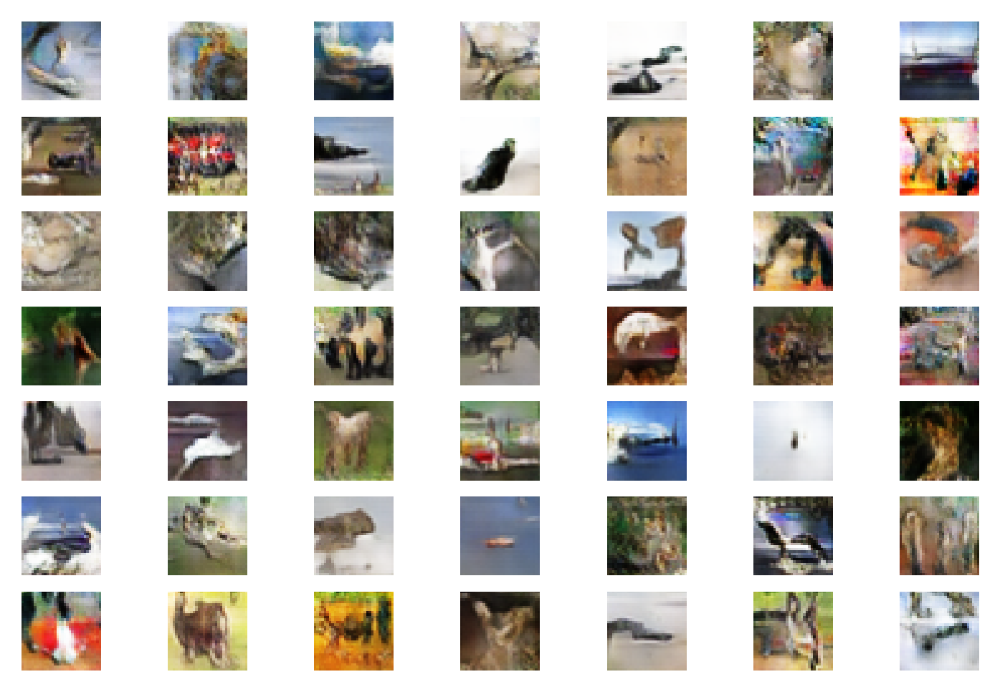

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 42, Batch: 1 of 390
 Discriminator real loss: 0.6251561045646667, Discriminator Fake loss: 0.681316614151001, Generator loss: 0.8325744867324829
 Epoch: 42, Batch: 101 of 390
 Discriminator real loss: 0.6798676252365112, Discriminator Fake loss: 0.7453607320785522, Generator loss: 0.8512411713600159
 Epoch: 42, Batch: 201 of 390
 Discriminator real loss: 0.5819015502929688, Discriminator Fake loss: 0.6128988862037659, Generator loss: 0.8369772434234619
 Epoch: 42, Batch: 301 of 390
 Discriminator real loss: 0.6916953921318054, Discriminator Fake loss: 0.6732555031776428, Generator loss: 0.8232054114341736
***** Accuracy real: 53.33333611488342, fake: 75.3333330154419 *****


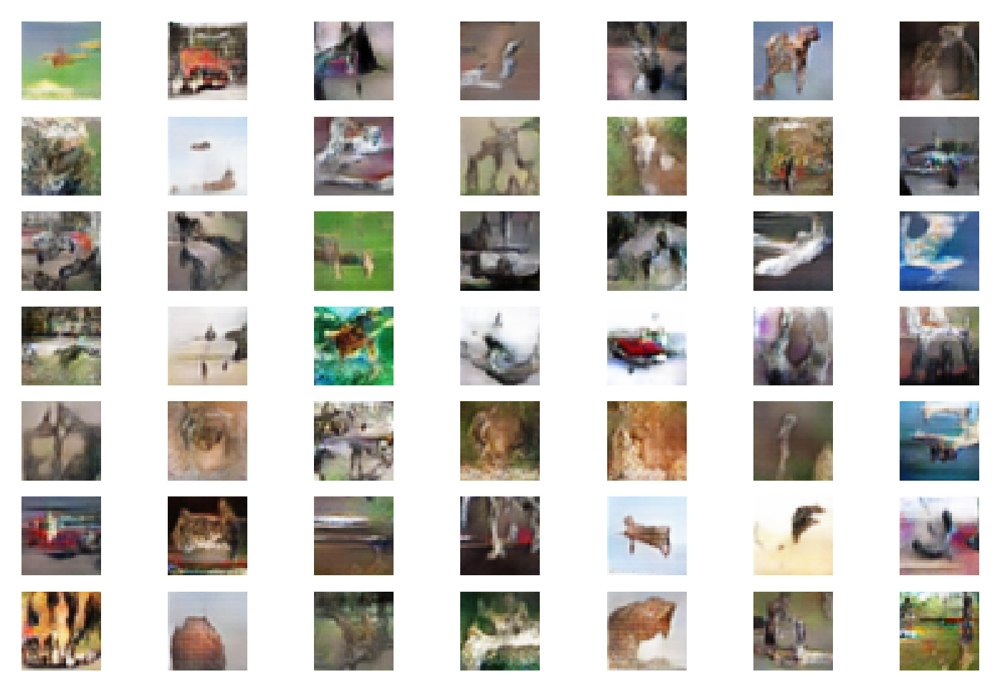

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 43, Batch: 1 of 390
 Discriminator real loss: 0.6309473514556885, Discriminator Fake loss: 0.7411645650863647, Generator loss: 0.8923106789588928
 Epoch: 43, Batch: 101 of 390
 Discriminator real loss: 0.7050505876541138, Discriminator Fake loss: 0.676476001739502, Generator loss: 0.9011358022689819
 Epoch: 43, Batch: 201 of 390
 Discriminator real loss: 0.6598505973815918, Discriminator Fake loss: 0.7428779602050781, Generator loss: 0.8658168315887451
 Epoch: 43, Batch: 301 of 390
 Discriminator real loss: 0.687712550163269, Discriminator Fake loss: 0.6226755380630493, Generator loss: 0.8361106514930725
***** Accuracy real: 47.333332896232605, fake: 80.0000011920929 *****


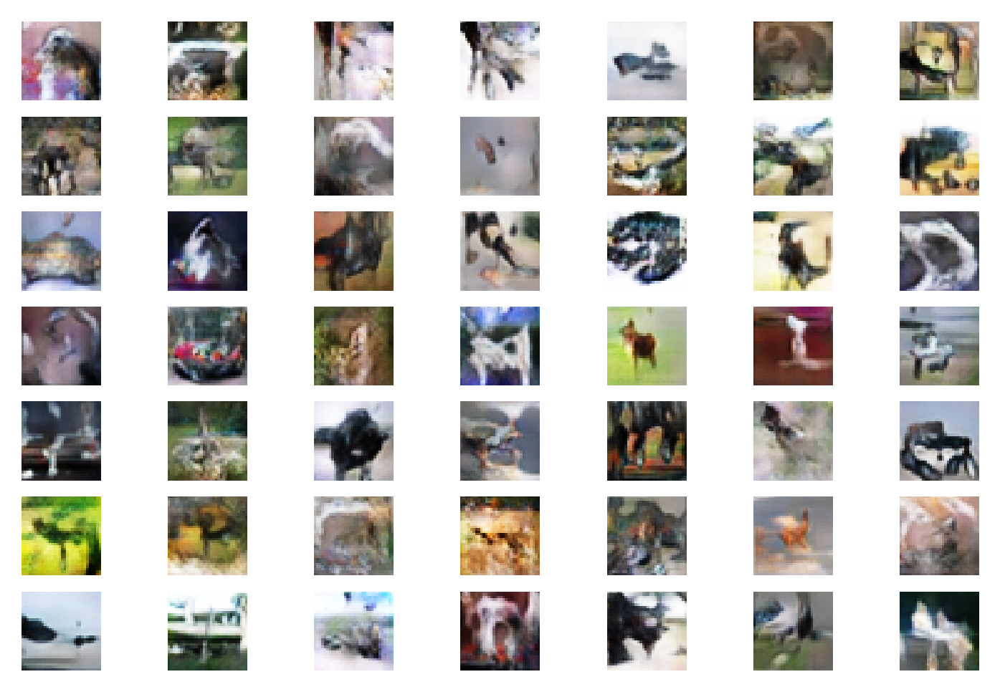

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 44, Batch: 1 of 390
 Discriminator real loss: 0.6379401087760925, Discriminator Fake loss: 0.6433939933776855, Generator loss: 0.8769291639328003
 Epoch: 44, Batch: 101 of 390
 Discriminator real loss: 0.7076241970062256, Discriminator Fake loss: 0.6526181697845459, Generator loss: 0.8097144365310669
 Epoch: 44, Batch: 201 of 390
 Discriminator real loss: 0.7154600024223328, Discriminator Fake loss: 0.6075955629348755, Generator loss: 0.9245700836181641
 Epoch: 44, Batch: 301 of 390
 Discriminator real loss: 0.7097126841545105, Discriminator Fake loss: 0.6275475025177002, Generator loss: 0.84521484375
***** Accuracy real: 52.666664123535156, fake: 91.33333563804626 *****


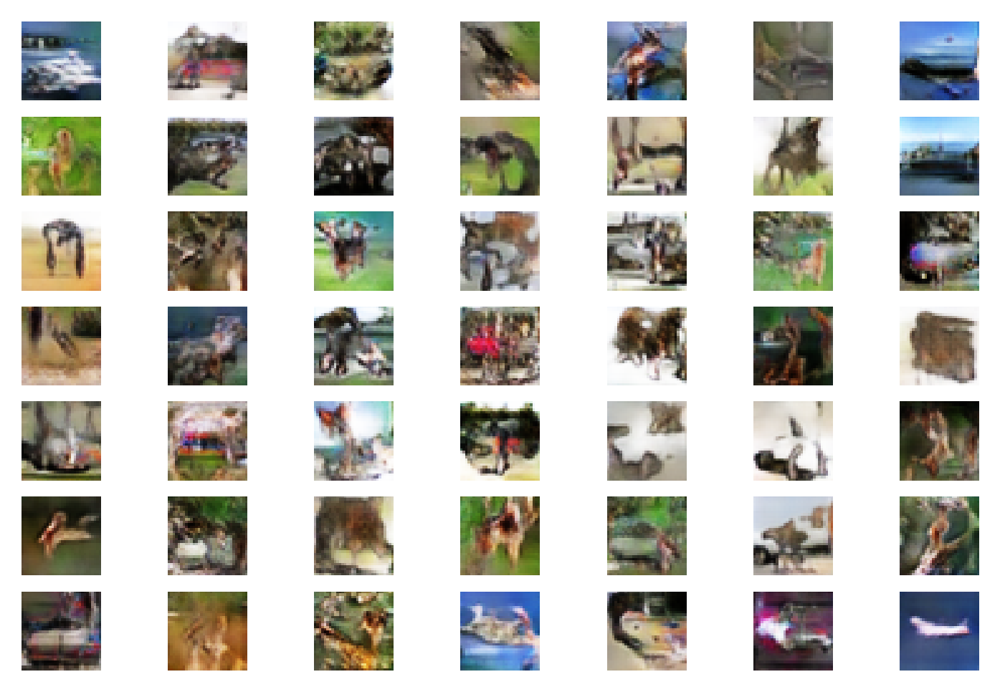

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 45, Batch: 1 of 390
 Discriminator real loss: 0.61407071352005, Discriminator Fake loss: 0.6558691263198853, Generator loss: 0.8639315366744995
 Epoch: 45, Batch: 101 of 390
 Discriminator real loss: 0.6507754325866699, Discriminator Fake loss: 0.6697514057159424, Generator loss: 0.8352285027503967
 Epoch: 45, Batch: 201 of 390
 Discriminator real loss: 0.6990528702735901, Discriminator Fake loss: 0.5810409188270569, Generator loss: 0.9007730484008789
 Epoch: 45, Batch: 301 of 390
 Discriminator real loss: 0.6586965322494507, Discriminator Fake loss: 0.682933509349823, Generator loss: 0.836896538734436
***** Accuracy real: 55.33333420753479, fake: 77.99999713897705 *****


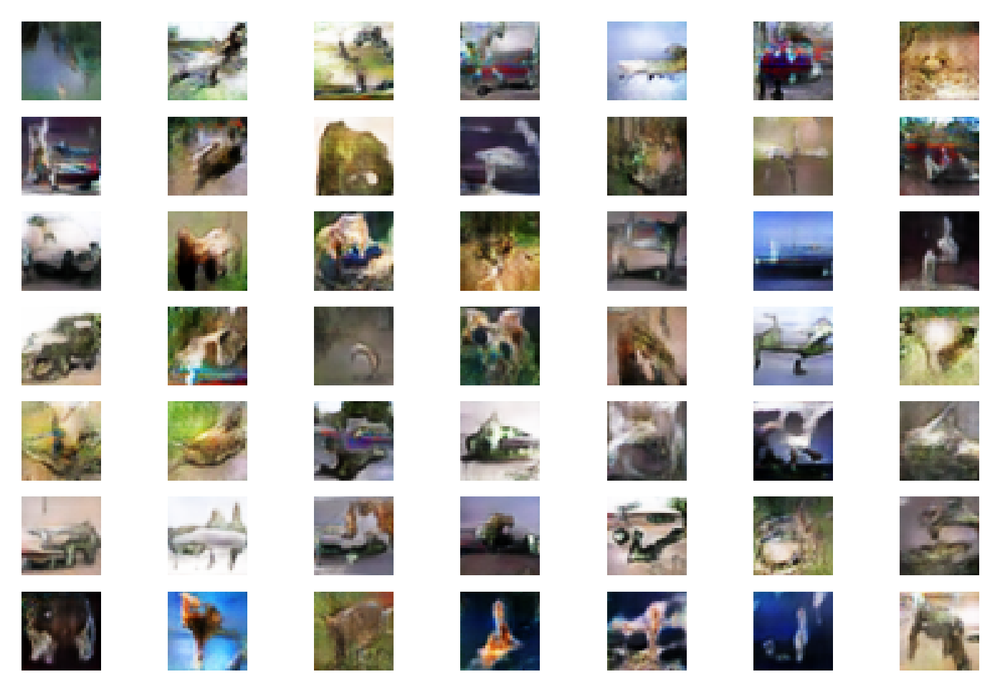

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 46, Batch: 1 of 390
 Discriminator real loss: 0.6249203085899353, Discriminator Fake loss: 0.7035402059555054, Generator loss: 0.9121538996696472
 Epoch: 46, Batch: 101 of 390
 Discriminator real loss: 0.6693959832191467, Discriminator Fake loss: 0.6460703611373901, Generator loss: 0.8532596230506897
 Epoch: 46, Batch: 201 of 390
 Discriminator real loss: 0.7478513717651367, Discriminator Fake loss: 0.6718075275421143, Generator loss: 0.8698712587356567
 Epoch: 46, Batch: 301 of 390
 Discriminator real loss: 0.649932861328125, Discriminator Fake loss: 0.5917773246765137, Generator loss: 0.9436432719230652
***** Accuracy real: 49.33333396911621, fake: 80.66666722297668 *****


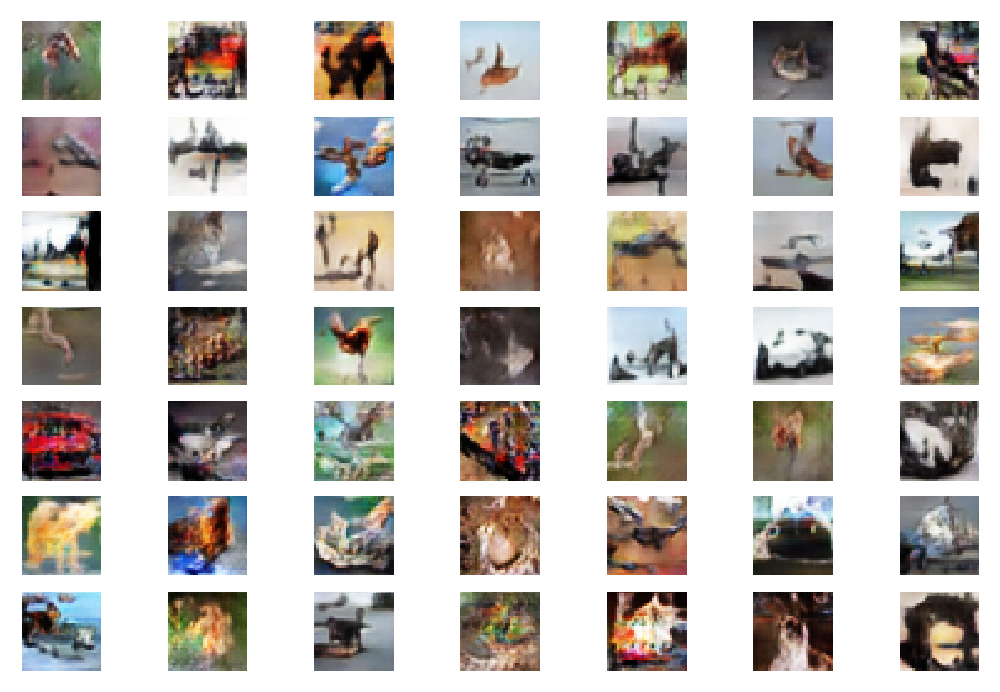

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 47, Batch: 1 of 390
 Discriminator real loss: 0.6387979984283447, Discriminator Fake loss: 0.6289217472076416, Generator loss: 0.8423289060592651
 Epoch: 47, Batch: 101 of 390
 Discriminator real loss: 0.6585042476654053, Discriminator Fake loss: 0.6027209758758545, Generator loss: 0.9738274216651917
 Epoch: 47, Batch: 201 of 390
 Discriminator real loss: 0.666009247303009, Discriminator Fake loss: 0.6412826180458069, Generator loss: 0.8883200287818909
 Epoch: 47, Batch: 301 of 390
 Discriminator real loss: 0.6610851287841797, Discriminator Fake loss: 0.6549645066261292, Generator loss: 0.8676292300224304
***** Accuracy real: 45.33333480358124, fake: 83.99999737739563 *****


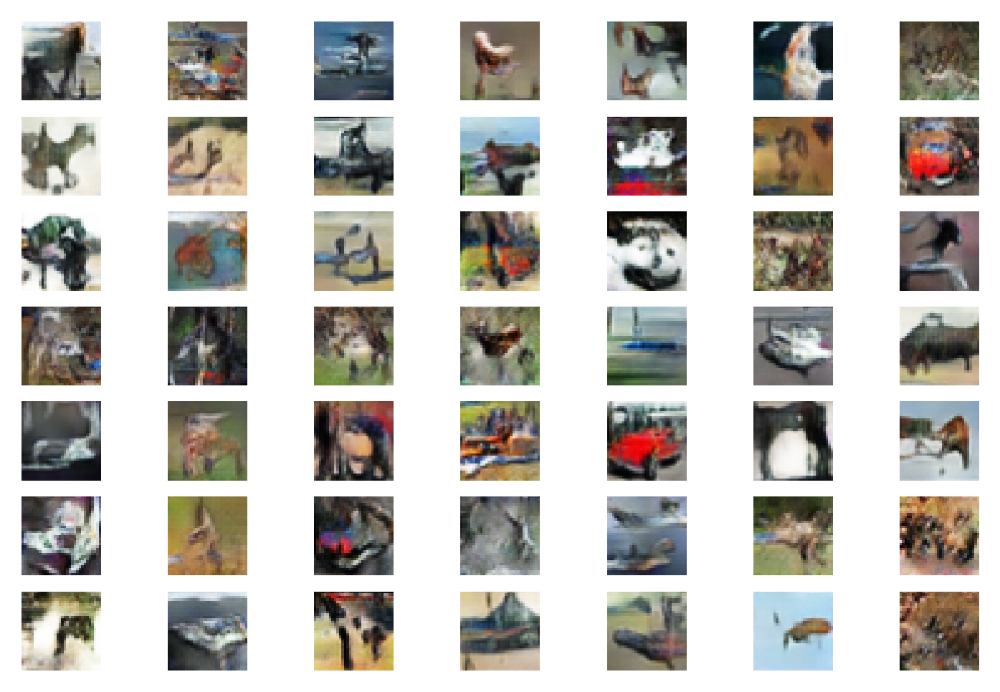

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 48, Batch: 1 of 390
 Discriminator real loss: 0.6114588975906372, Discriminator Fake loss: 0.5994675159454346, Generator loss: 0.8539124727249146
 Epoch: 48, Batch: 101 of 390
 Discriminator real loss: 0.6261286735534668, Discriminator Fake loss: 0.724575936794281, Generator loss: 0.808638870716095
 Epoch: 48, Batch: 201 of 390
 Discriminator real loss: 0.6669492125511169, Discriminator Fake loss: 0.6390500664710999, Generator loss: 0.8059566020965576
 Epoch: 48, Batch: 301 of 390
 Discriminator real loss: 0.5960938930511475, Discriminator Fake loss: 0.7314662933349609, Generator loss: 0.8968584537506104
***** Accuracy real: 56.00000023841858, fake: 69.9999988079071 *****


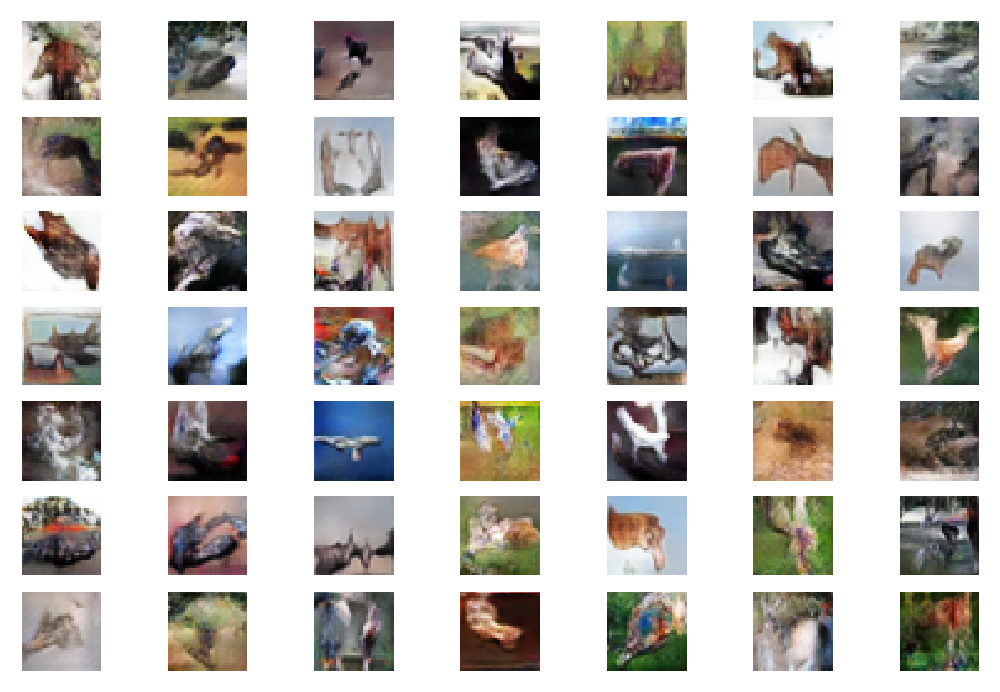

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 49, Batch: 1 of 390
 Discriminator real loss: 0.6383545994758606, Discriminator Fake loss: 0.6587092876434326, Generator loss: 0.8420747518539429
 Epoch: 49, Batch: 101 of 390
 Discriminator real loss: 0.6582704782485962, Discriminator Fake loss: 0.6250303983688354, Generator loss: 0.8543263673782349
 Epoch: 49, Batch: 201 of 390
 Discriminator real loss: 0.6833176612854004, Discriminator Fake loss: 0.6419756412506104, Generator loss: 0.915547788143158
 Epoch: 49, Batch: 301 of 390
 Discriminator real loss: 0.7037386894226074, Discriminator Fake loss: 0.6667069792747498, Generator loss: 0.9116606712341309
***** Accuracy real: 47.999998927116394, fake: 82.66666531562805 *****


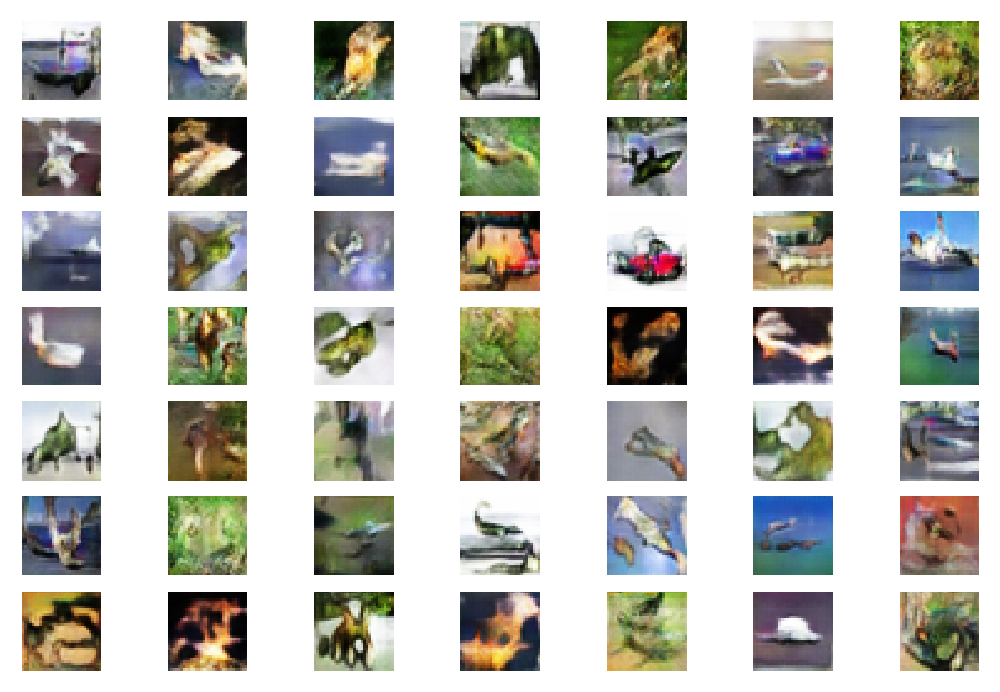

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 50, Batch: 1 of 390
 Discriminator real loss: 0.6434893608093262, Discriminator Fake loss: 0.604764997959137, Generator loss: 0.8198763728141785
 Epoch: 50, Batch: 101 of 390
 Discriminator real loss: 0.723544716835022, Discriminator Fake loss: 0.6121230125427246, Generator loss: 0.9261642694473267
 Epoch: 50, Batch: 201 of 390
 Discriminator real loss: 0.5829120874404907, Discriminator Fake loss: 0.6508532166481018, Generator loss: 0.8586522340774536
 Epoch: 50, Batch: 301 of 390
 Discriminator real loss: 0.6339362263679504, Discriminator Fake loss: 0.6288753747940063, Generator loss: 0.8860220909118652
***** Accuracy real: 59.333330392837524, fake: 77.33333110809326 *****


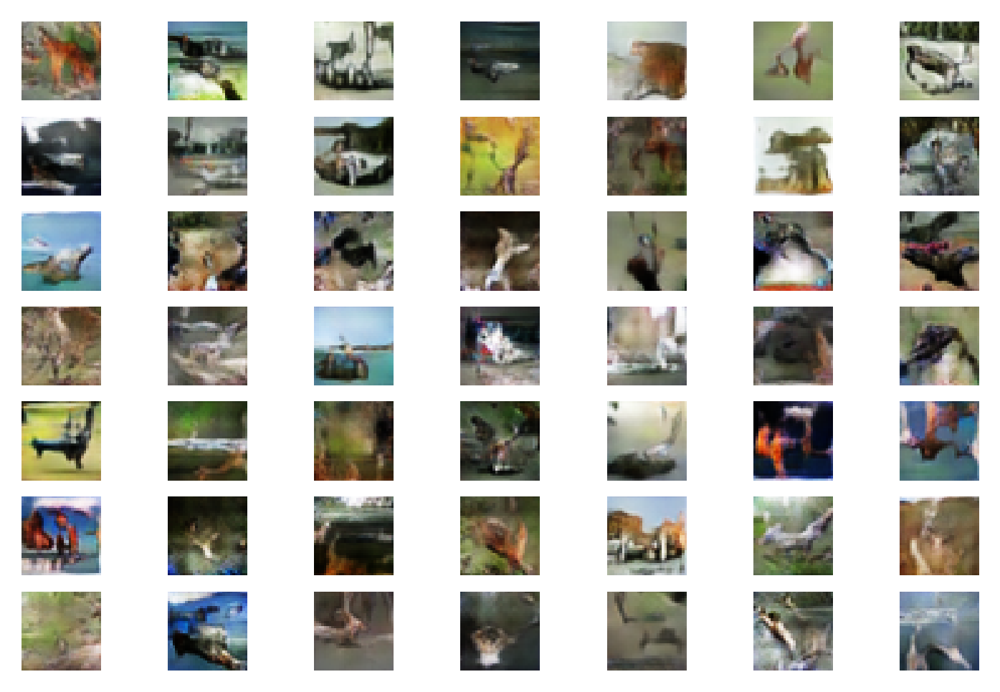

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 51, Batch: 1 of 390
 Discriminator real loss: 0.6143986582756042, Discriminator Fake loss: 0.7346593737602234, Generator loss: 0.8341650366783142
 Epoch: 51, Batch: 101 of 390
 Discriminator real loss: 0.6236751079559326, Discriminator Fake loss: 0.6550437808036804, Generator loss: 0.8309012055397034
 Epoch: 51, Batch: 201 of 390
 Discriminator real loss: 0.6178699135780334, Discriminator Fake loss: 0.6511014699935913, Generator loss: 0.8331307172775269
 Epoch: 51, Batch: 301 of 390
 Discriminator real loss: 0.638703465461731, Discriminator Fake loss: 0.605621337890625, Generator loss: 0.829220175743103
***** Accuracy real: 50.66666603088379, fake: 81.33333325386047 *****


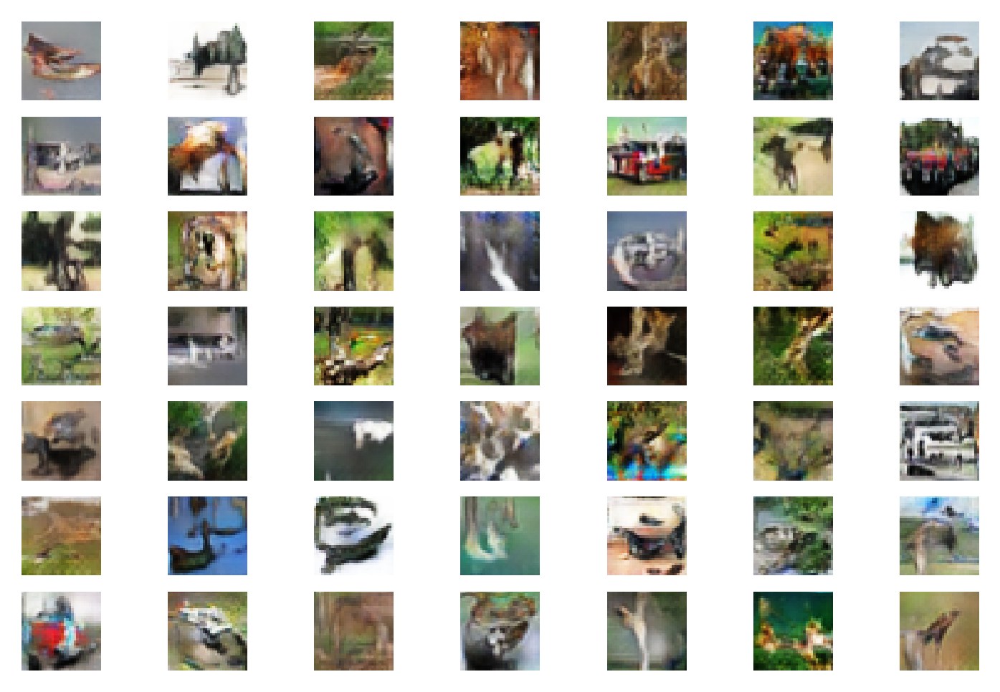

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 52, Batch: 1 of 390
 Discriminator real loss: 0.6209623217582703, Discriminator Fake loss: 0.6685436964035034, Generator loss: 0.8752172589302063
 Epoch: 52, Batch: 101 of 390
 Discriminator real loss: 0.6231467127799988, Discriminator Fake loss: 0.6279244422912598, Generator loss: 0.8106206655502319
 Epoch: 52, Batch: 201 of 390
 Discriminator real loss: 0.7189844250679016, Discriminator Fake loss: 0.6118592619895935, Generator loss: 0.9228670597076416
 Epoch: 52, Batch: 301 of 390
 Discriminator real loss: 0.6155859231948853, Discriminator Fake loss: 0.6745957136154175, Generator loss: 0.852217972278595
***** Accuracy real: 47.333332896232605, fake: 88.66666555404663 *****


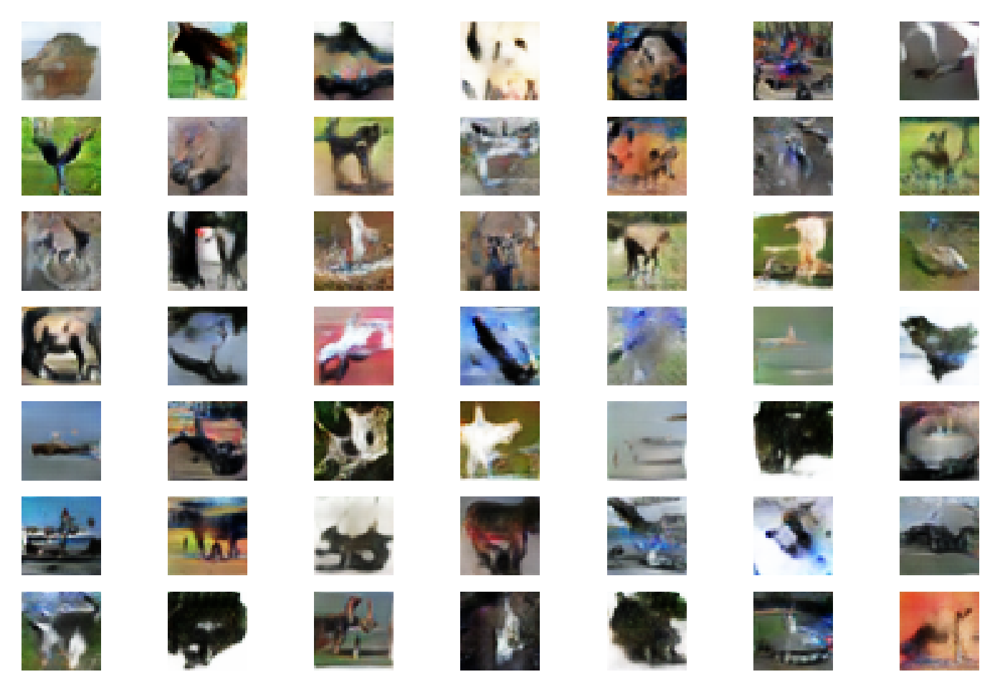

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 53, Batch: 1 of 390
 Discriminator real loss: 0.6062964200973511, Discriminator Fake loss: 0.6312705278396606, Generator loss: 0.864263653755188
 Epoch: 53, Batch: 101 of 390
 Discriminator real loss: 0.7275702953338623, Discriminator Fake loss: 0.6993459463119507, Generator loss: 0.8536025285720825
 Epoch: 53, Batch: 201 of 390
 Discriminator real loss: 0.5992835760116577, Discriminator Fake loss: 0.6170551776885986, Generator loss: 0.9255582690238953
 Epoch: 53, Batch: 301 of 390
 Discriminator real loss: 0.6429722309112549, Discriminator Fake loss: 0.6026703119277954, Generator loss: 0.8619881868362427
***** Accuracy real: 51.33333206176758, fake: 80.0000011920929 *****


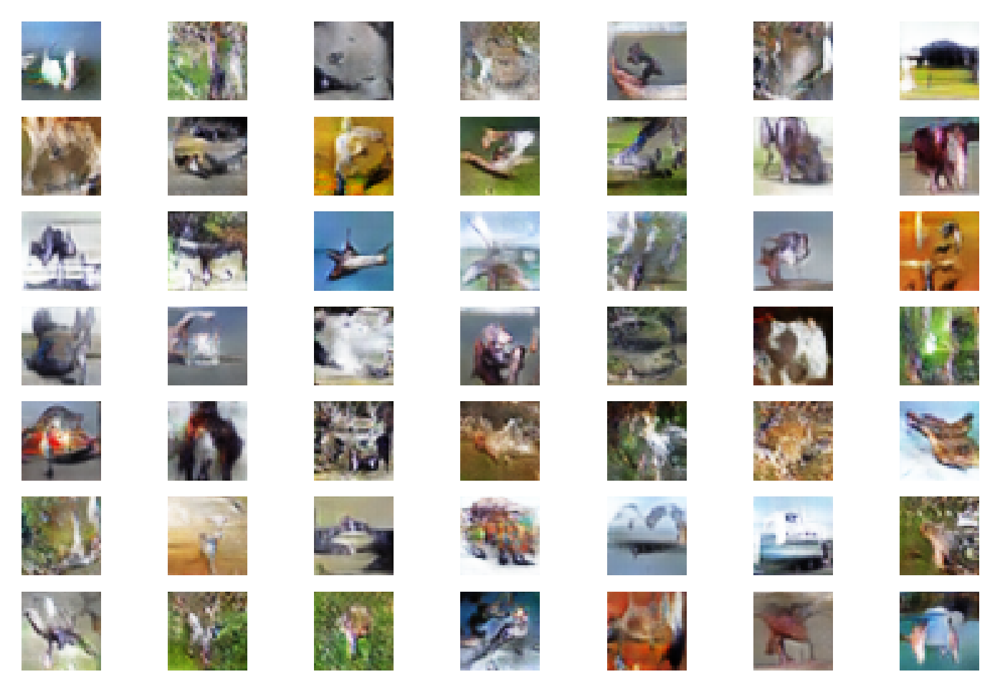

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 54, Batch: 1 of 390
 Discriminator real loss: 0.6104543805122375, Discriminator Fake loss: 0.6465926170349121, Generator loss: 0.8871634006500244
 Epoch: 54, Batch: 101 of 390
 Discriminator real loss: 0.6898759007453918, Discriminator Fake loss: 0.6803514957427979, Generator loss: 0.8444733023643494
 Epoch: 54, Batch: 201 of 390
 Discriminator real loss: 0.604019045829773, Discriminator Fake loss: 0.6567187905311584, Generator loss: 0.9131676554679871
 Epoch: 54, Batch: 301 of 390
 Discriminator real loss: 0.6352590918540955, Discriminator Fake loss: 0.5760573744773865, Generator loss: 0.9564965963363647
***** Accuracy real: 57.33333230018616, fake: 81.33333325386047 *****


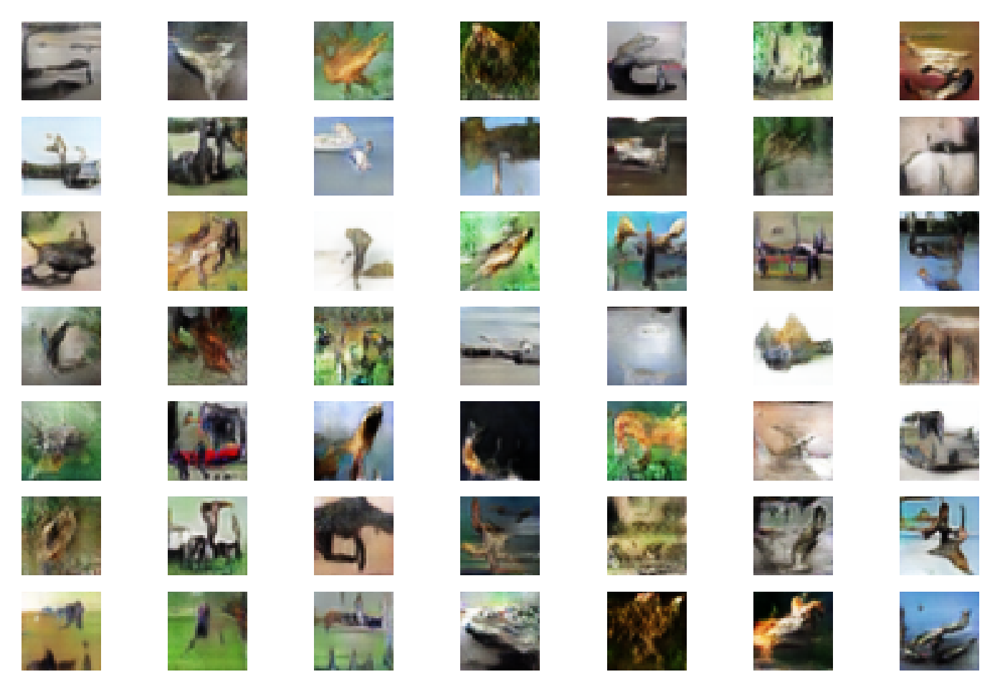

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 55, Batch: 1 of 390
 Discriminator real loss: 0.6083475947380066, Discriminator Fake loss: 0.6804397106170654, Generator loss: 0.8384160399436951
 Epoch: 55, Batch: 101 of 390
 Discriminator real loss: 0.6005784273147583, Discriminator Fake loss: 0.6447667479515076, Generator loss: 0.8726253509521484
 Epoch: 55, Batch: 201 of 390
 Discriminator real loss: 0.6927332878112793, Discriminator Fake loss: 0.6560050249099731, Generator loss: 0.8732151389122009
 Epoch: 55, Batch: 301 of 390
 Discriminator real loss: 0.6864562034606934, Discriminator Fake loss: 0.629014253616333, Generator loss: 0.8796286582946777
***** Accuracy real: 53.33333611488342, fake: 79.3333351612091 *****


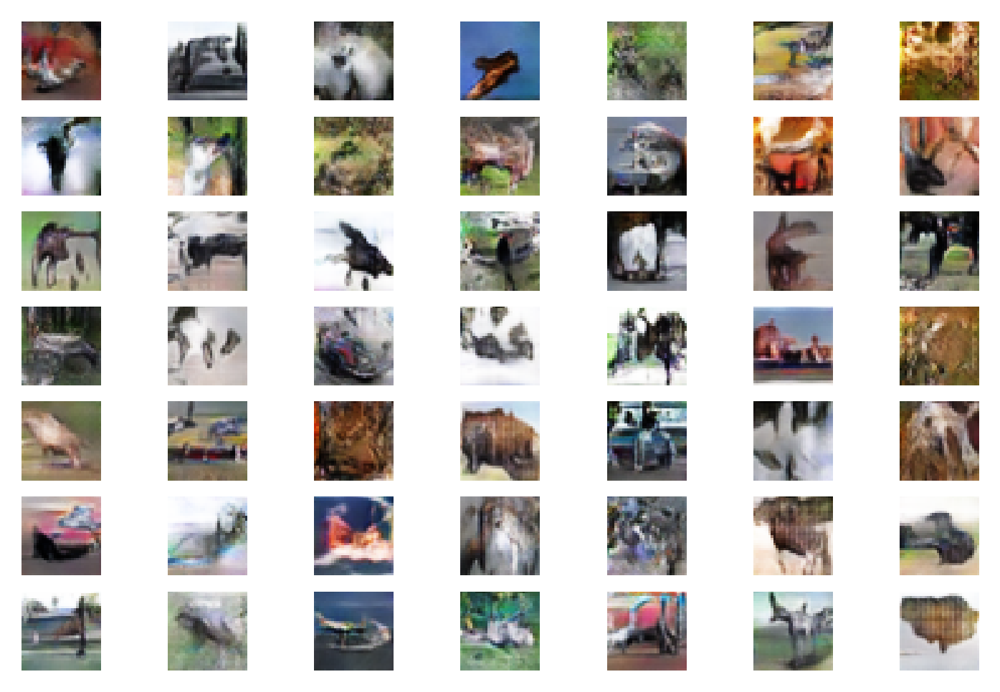

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 56, Batch: 1 of 390
 Discriminator real loss: 0.615695059299469, Discriminator Fake loss: 0.6838739514350891, Generator loss: 0.8373613357543945
 Epoch: 56, Batch: 101 of 390
 Discriminator real loss: 0.585181713104248, Discriminator Fake loss: 0.5974294543266296, Generator loss: 0.9540165662765503
 Epoch: 56, Batch: 201 of 390
 Discriminator real loss: 0.6294155716896057, Discriminator Fake loss: 0.664440393447876, Generator loss: 0.8722970485687256
 Epoch: 56, Batch: 301 of 390
 Discriminator real loss: 0.6835360527038574, Discriminator Fake loss: 0.628918468952179, Generator loss: 0.9102899432182312
***** Accuracy real: 50.0, fake: 81.99999928474426 *****


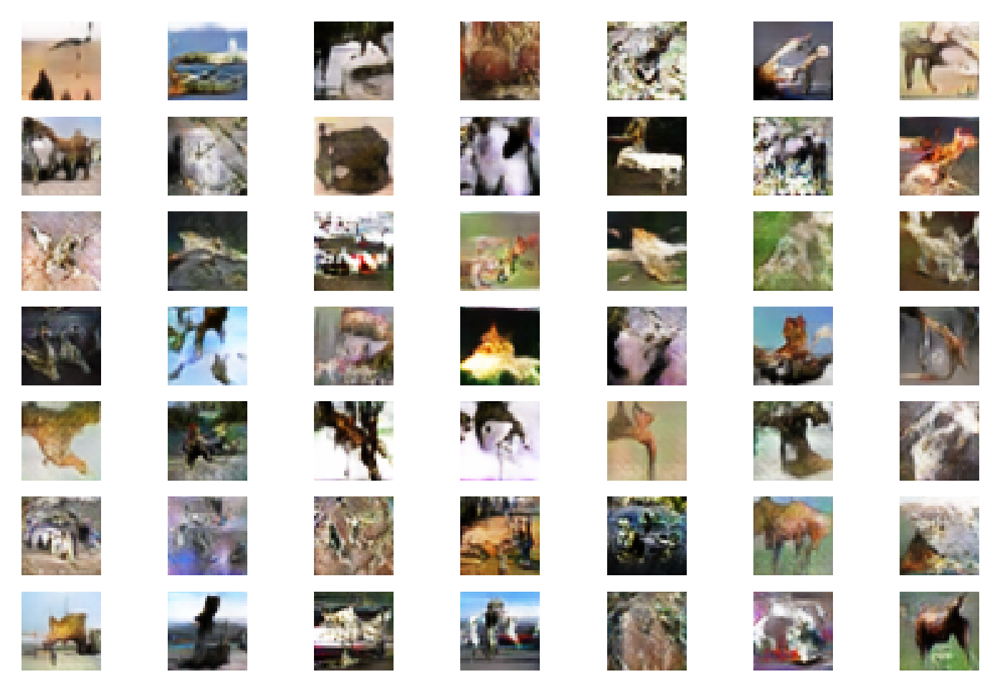

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 57, Batch: 1 of 390
 Discriminator real loss: 0.6126943826675415, Discriminator Fake loss: 0.6558780074119568, Generator loss: 0.8778495788574219
 Epoch: 57, Batch: 101 of 390
 Discriminator real loss: 0.6129993796348572, Discriminator Fake loss: 0.7480454444885254, Generator loss: 0.8962493538856506
 Epoch: 57, Batch: 201 of 390
 Discriminator real loss: 0.70949387550354, Discriminator Fake loss: 0.6090995073318481, Generator loss: 0.8346555233001709
 Epoch: 57, Batch: 301 of 390
 Discriminator real loss: 0.6772332787513733, Discriminator Fake loss: 0.6823153495788574, Generator loss: 0.8838068246841431
***** Accuracy real: 46.666666865348816, fake: 81.99999928474426 *****


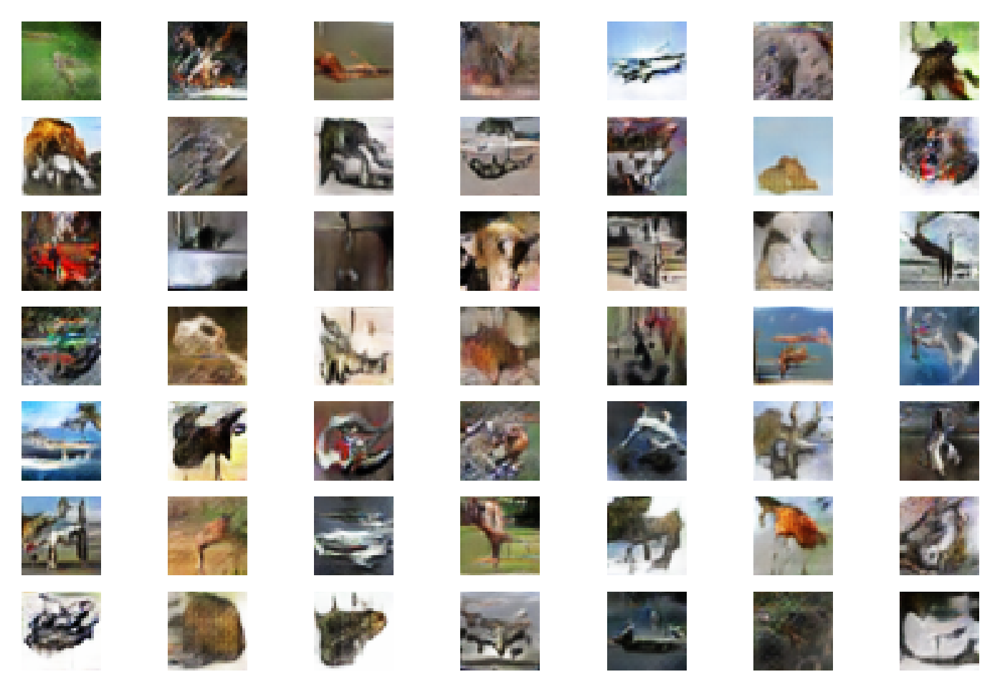

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 58, Batch: 1 of 390
 Discriminator real loss: 0.6117496490478516, Discriminator Fake loss: 0.6353108882904053, Generator loss: 0.931698203086853
 Epoch: 58, Batch: 101 of 390
 Discriminator real loss: 0.7162600755691528, Discriminator Fake loss: 0.5803364515304565, Generator loss: 0.8833231329917908
 Epoch: 58, Batch: 201 of 390
 Discriminator real loss: 0.6109747290611267, Discriminator Fake loss: 0.6403289437294006, Generator loss: 0.8372198343276978
 Epoch: 58, Batch: 301 of 390
 Discriminator real loss: 0.5991213917732239, Discriminator Fake loss: 0.6198477745056152, Generator loss: 0.9005274772644043
***** Accuracy real: 44.66666579246521, fake: 85.33333539962769 *****


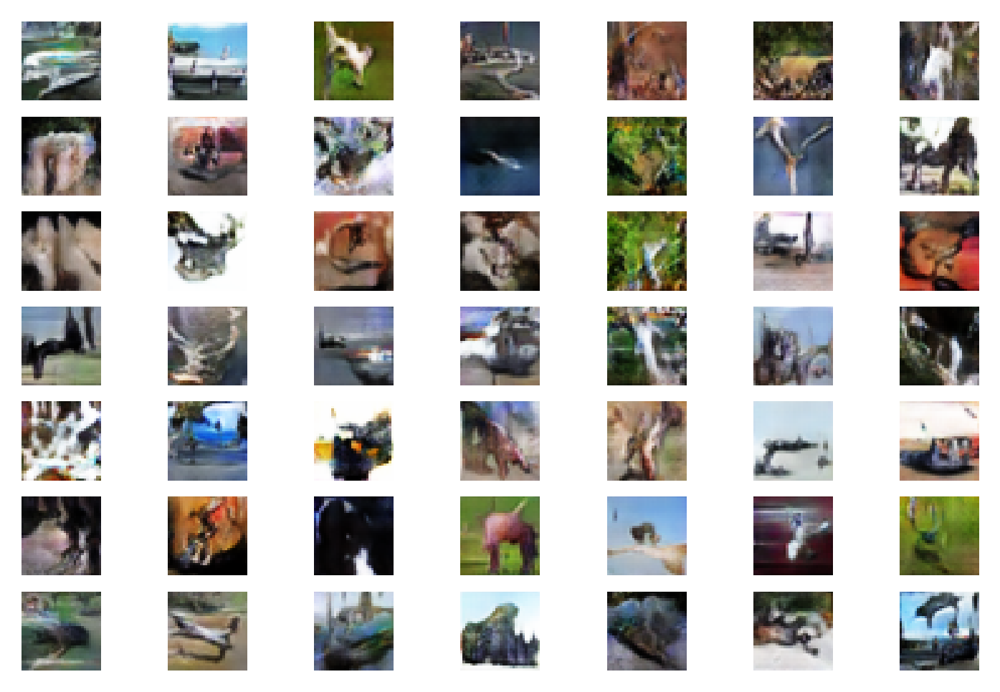

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 59, Batch: 1 of 390
 Discriminator real loss: 0.6044435501098633, Discriminator Fake loss: 0.6172472238540649, Generator loss: 0.88776695728302
 Epoch: 59, Batch: 101 of 390
 Discriminator real loss: 0.6102453470230103, Discriminator Fake loss: 0.6383249759674072, Generator loss: 0.8637194633483887
 Epoch: 59, Batch: 201 of 390
 Discriminator real loss: 0.6636074781417847, Discriminator Fake loss: 0.609199047088623, Generator loss: 0.941165566444397
 Epoch: 59, Batch: 301 of 390
 Discriminator real loss: 0.7017231583595276, Discriminator Fake loss: 0.6612175703048706, Generator loss: 0.8883544206619263
***** Accuracy real: 58.666664361953735, fake: 83.99999737739563 *****


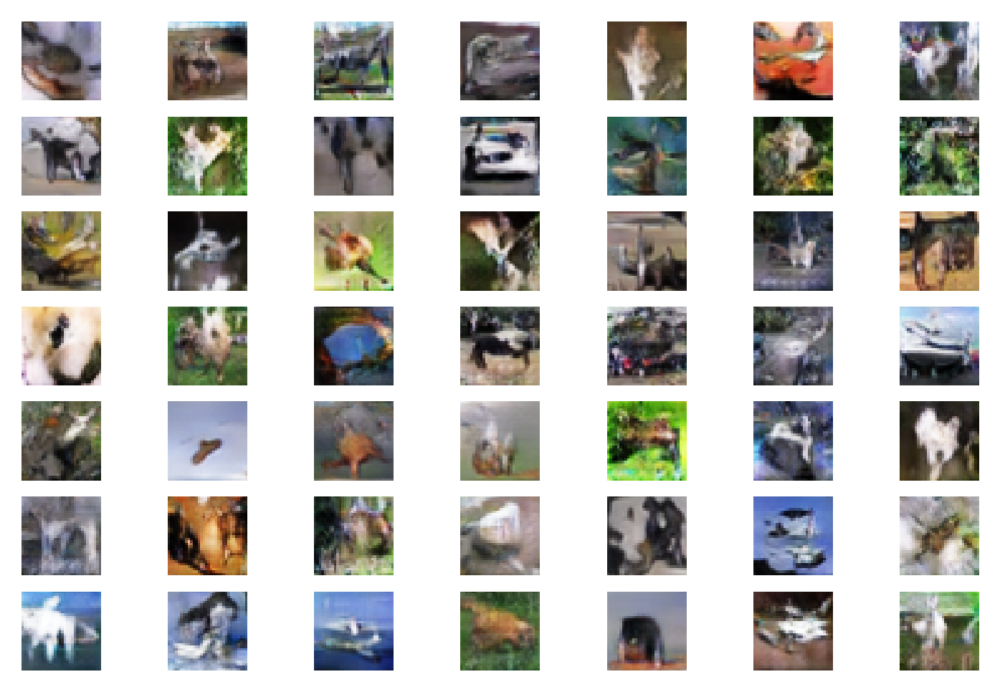

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets
 Epoch: 60, Batch: 1 of 390
 Discriminator real loss: 0.5937318205833435, Discriminator Fake loss: 0.6820363402366638, Generator loss: 0.8989973068237305
 Epoch: 60, Batch: 101 of 390
 Discriminator real loss: 0.6432987451553345, Discriminator Fake loss: 0.5983755588531494, Generator loss: 0.9832258224487305
 Epoch: 60, Batch: 201 of 390
 Discriminator real loss: 0.6302923560142517, Discriminator Fake loss: 0.5998551249504089, Generator loss: 0.956813395023346
 Epoch: 60, Batch: 301 of 390
 Discriminator real loss: 0.649827778339386, Discriminator Fake loss: 0.6175883412361145, Generator loss: 0.9332106113433838
***** Accuracy real: 51.33333206176758, fake: 83.33333134651184 *****


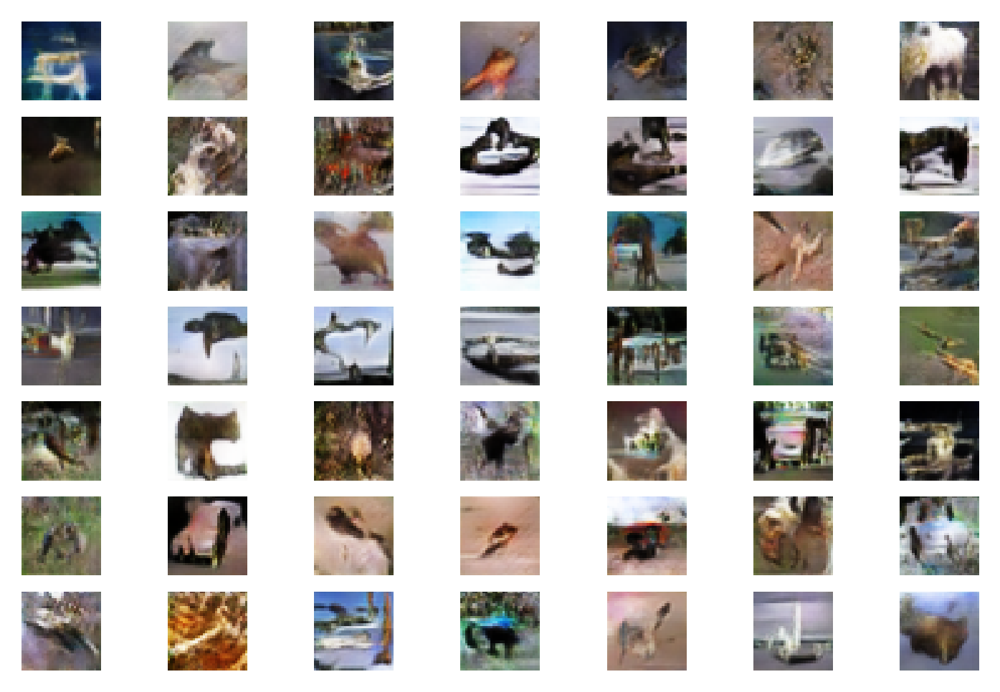

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar/discriminator/assets


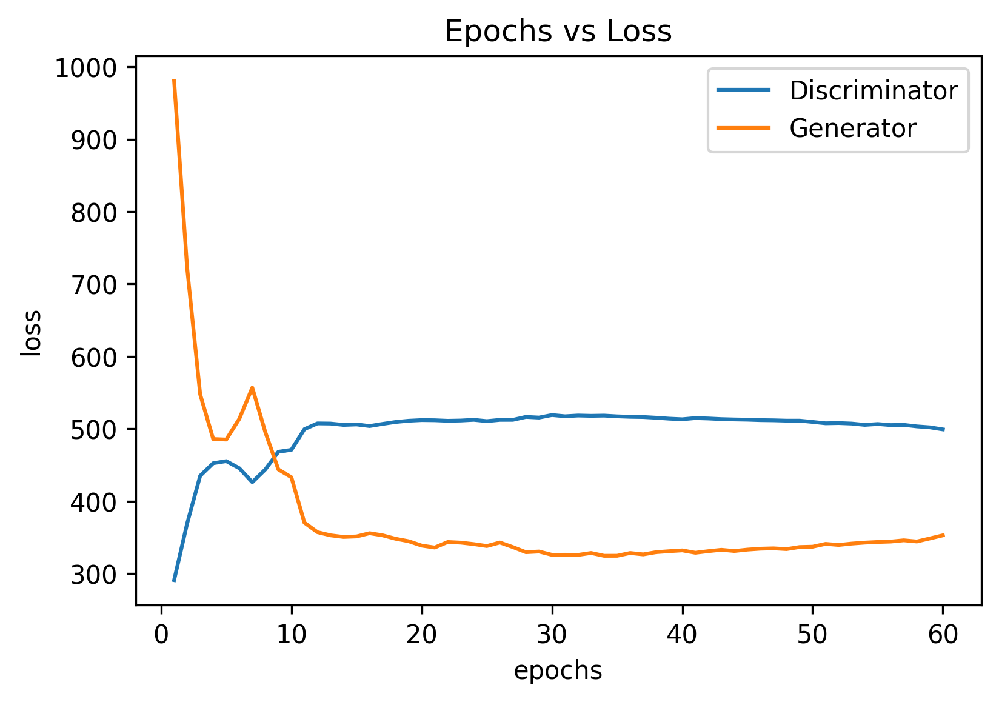

Done with training the model ......
CPU times: user 34min 12s, sys: 2min 44s, total: 36min 56s
Wall time: 1h 24min 14s


In [7]:
%%time
# size of the latent space
samplesize = 100


# create the discriminator
discriminator = discriminator_(in_shape=(32,32,3), 
                               d_lr=0.0002,
                               d_beta=0.5)
# create the generator
generator = generator_(samplesize)
# create the gan
dcgan = dcgan_(generator, discriminator)

# train model
trained_generator = train(generator, discriminator, dcgan, data, samplesize, epochs=60, batch_size=128, model_name="dcgan_cifar")

In [1]:

# image_list =sorted(glob.glob('results/dcgan_cifar/eval_*'), key=lambda x:float(re.findall("(\d+)",x)[0]))
generate_video("dcgan_cifar")
# imageio.mimwrite('animated_from_images.gif', image_list)
# image_list

Epoch evolutions video saved as results/dcgan_cifar/outputs_evolution.avi


## With Batch Normalization in DCGAN

 Training dcgan_cifar_withbatchnorm ......


  0%|          | 0/20 [00:00<?, ?it/s]

 Epoch: 1, Batch: 1 of 390
 Discriminator real loss: 1.287328839302063, Discriminator Fake loss: 0.8034216165542603, Generator loss: 0.6929270029067993
 Epoch: 1, Batch: 101 of 390
 Discriminator real loss: 0.0016399467131122947, Discriminator Fake loss: 0.00020671295351348817, Generator loss: 0.0005964768351987004
 Epoch: 1, Batch: 201 of 390
 Discriminator real loss: 0.0004557232605293393, Discriminator Fake loss: 8.740167686482891e-05, Generator loss: 3.763715312743443e-06
 Epoch: 1, Batch: 301 of 390
 Discriminator real loss: 0.0001109836230170913, Discriminator Fake loss: 0.000268279283773154, Generator loss: 0.00012108821101719514
***** Accuracy real: 100.0, fake: 0.0 *****


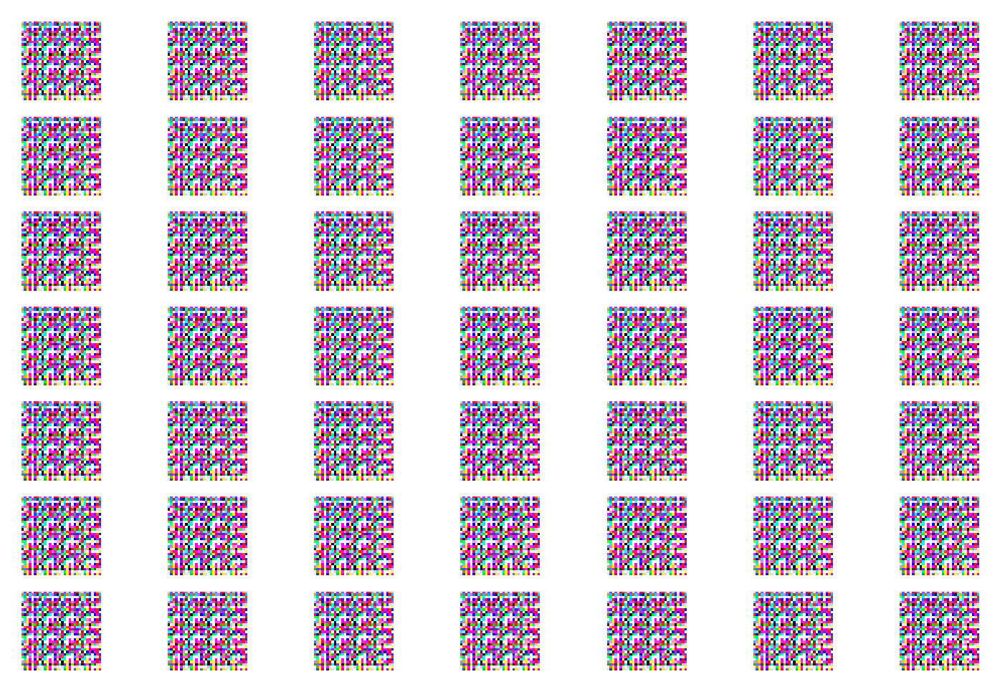

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 2, Batch: 1 of 390
 Discriminator real loss: 5.2521820068359375, Discriminator Fake loss: 0.0002071376657113433, Generator loss: 0.00020029814913868904
 Epoch: 2, Batch: 101 of 390
 Discriminator real loss: 0.0002347706031287089, Discriminator Fake loss: 0.00020383766968734562, Generator loss: 0.00022493075812235475
 Epoch: 2, Batch: 201 of 390
 Discriminator real loss: 8.202314347727224e-05, Discriminator Fake loss: 0.0002307176182512194, Generator loss: 0.0007092567393556237
 Epoch: 2, Batch: 301 of 390
 Discriminator real loss: 0.0001456937607144937, Discriminator Fake loss: 2.3446873456123285e-05, Generator loss: 0.0010488235857337713
***** Accuracy real: 98.66666793823242, fake: 0.0 *****


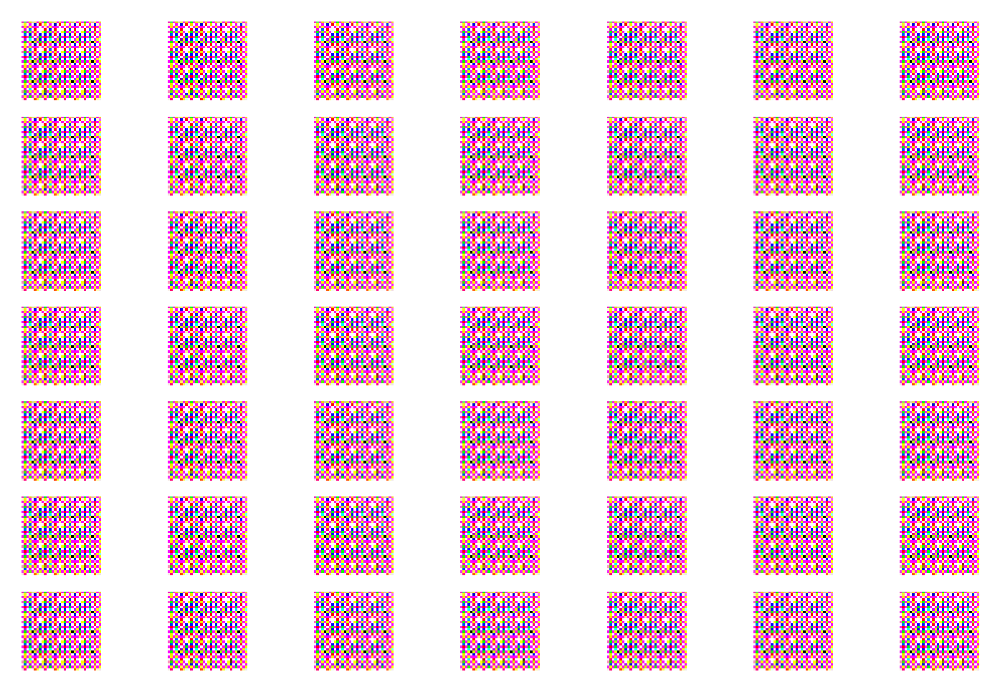

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 3, Batch: 1 of 390
 Discriminator real loss: 5.054481506347656, Discriminator Fake loss: 1.0463721991982311e-05, Generator loss: 0.0007824270287528634
 Epoch: 3, Batch: 101 of 390
 Discriminator real loss: 2.092933573294431e-05, Discriminator Fake loss: 7.326999366341624e-06, Generator loss: 0.0006645310204476118
 Epoch: 3, Batch: 201 of 390
 Discriminator real loss: 2.3803262592991814e-05, Discriminator Fake loss: 3.721669145306805e-06, Generator loss: 0.0007078243652358651
 Epoch: 3, Batch: 301 of 390
 Discriminator real loss: 5.930061888648197e-05, Discriminator Fake loss: 2.796899707391276e-06, Generator loss: 0.0004443580110091716
***** Accuracy real: 100.0, fake: 0.0 *****


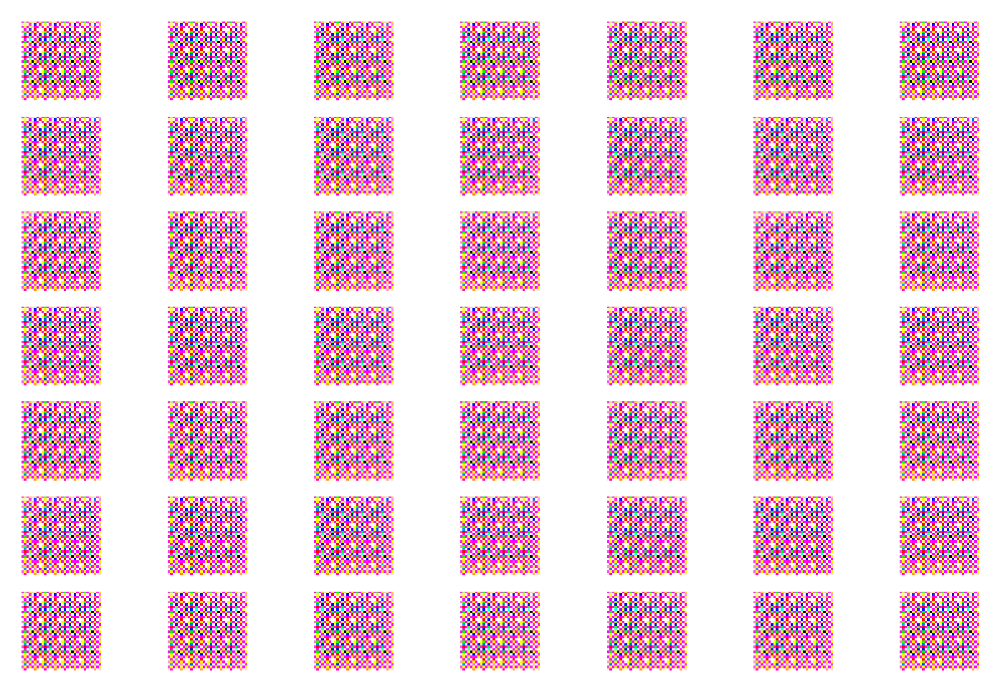

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 4, Batch: 1 of 390
 Discriminator real loss: 5.854794979095459, Discriminator Fake loss: 2.257447931697243e-06, Generator loss: 0.0004259317647665739
 Epoch: 4, Batch: 101 of 390
 Discriminator real loss: 1.454443463444477e-05, Discriminator Fake loss: 2.3774971396051114e-06, Generator loss: 0.0003298154042568058
 Epoch: 4, Batch: 201 of 390
 Discriminator real loss: 6.767805189156206e-06, Discriminator Fake loss: 2.0002821656817105e-06, Generator loss: 0.0002572216035332531
 Epoch: 4, Batch: 301 of 390
 Discriminator real loss: 8.089678885880858e-06, Discriminator Fake loss: 1.305937985307537e-06, Generator loss: 0.00024557654978707433
***** Accuracy real: 100.0, fake: 0.0 *****


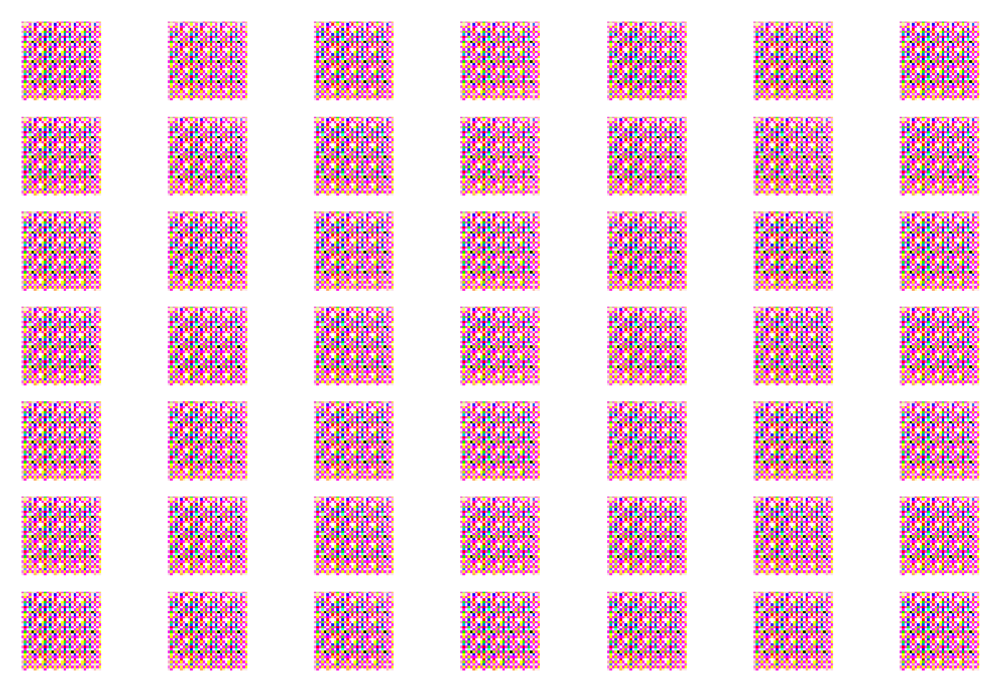

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 5, Batch: 1 of 390
 Discriminator real loss: 6.289620876312256, Discriminator Fake loss: 1.3120981066094828e-06, Generator loss: 0.0002623310429044068
 Epoch: 5, Batch: 101 of 390
 Discriminator real loss: 4.4932603486813605e-06, Discriminator Fake loss: 1.4048446246306412e-06, Generator loss: 0.00023108291497919708
 Epoch: 5, Batch: 201 of 390
 Discriminator real loss: 6.040942480467493e-06, Discriminator Fake loss: 1.4470180076386896e-06, Generator loss: 0.00024492593365721405
 Epoch: 5, Batch: 301 of 390
 Discriminator real loss: 8.22617676021764e-06, Discriminator Fake loss: 1.1209185686311685e-06, Generator loss: 0.00019444405916146934
***** Accuracy real: 100.0, fake: 0.0 *****


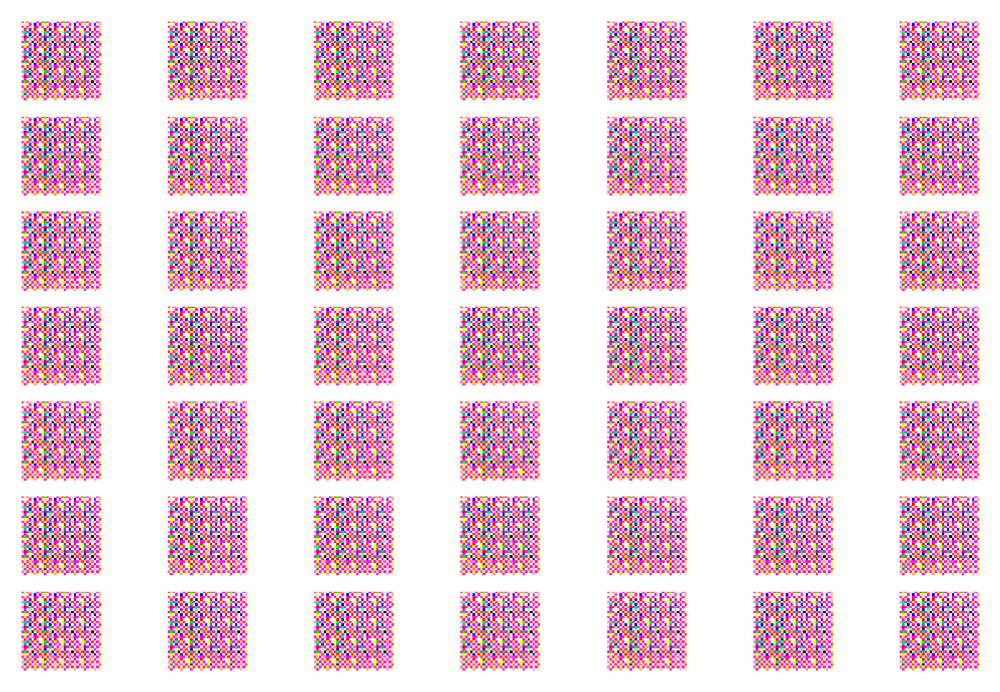

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 6, Batch: 1 of 390
 Discriminator real loss: 6.409120559692383, Discriminator Fake loss: 1.0170027735512122e-06, Generator loss: 0.00021992629626765847
 Epoch: 6, Batch: 101 of 390
 Discriminator real loss: 5.7640318118501455e-06, Discriminator Fake loss: 9.244209309144935e-07, Generator loss: 0.0001453100994694978
 Epoch: 6, Batch: 201 of 390
 Discriminator real loss: 4.564143637253437e-06, Discriminator Fake loss: 9.503728506388143e-07, Generator loss: 0.00017074940842576325
 Epoch: 6, Batch: 301 of 390
 Discriminator real loss: 1.778899218152219e-06, Discriminator Fake loss: 5.770697271145764e-07, Generator loss: 0.00014595869288314134
***** Accuracy real: 100.0, fake: 0.0 *****


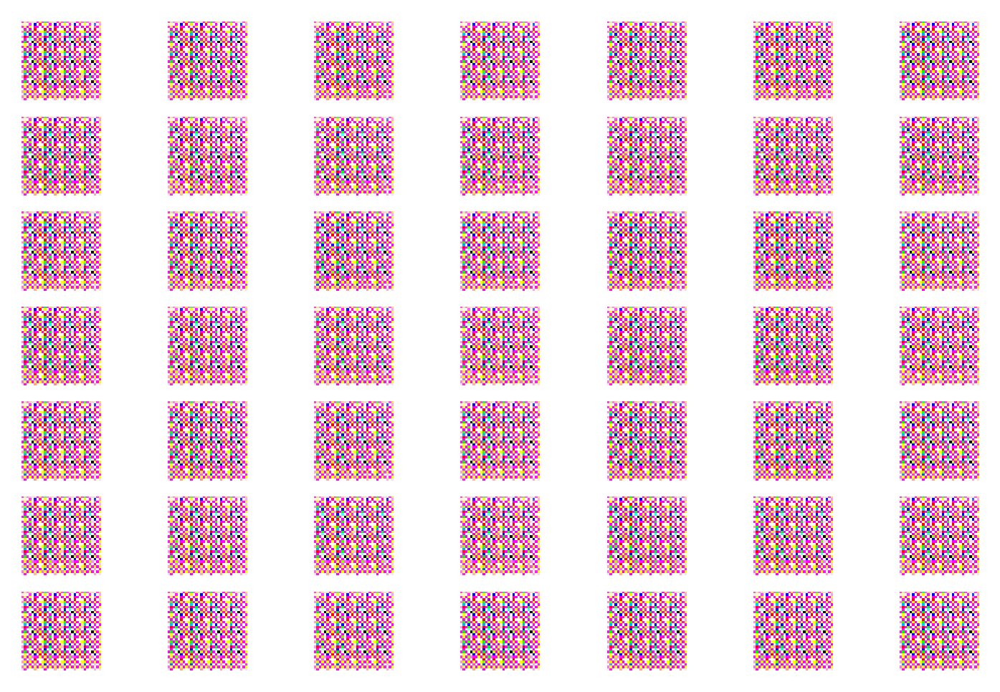

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 7, Batch: 1 of 390
 Discriminator real loss: 6.725053787231445, Discriminator Fake loss: 6.932056635378103e-07, Generator loss: 0.00013837726146448404
 Epoch: 7, Batch: 101 of 390
 Discriminator real loss: 2.250088527944172e-06, Discriminator Fake loss: 4.469563066322735e-07, Generator loss: 0.000123035249998793
 Epoch: 7, Batch: 201 of 390
 Discriminator real loss: 6.917321684341005e-07, Discriminator Fake loss: 5.086355940875364e-07, Generator loss: 0.0001062604205799289
 Epoch: 7, Batch: 301 of 390
 Discriminator real loss: 8.223973964049947e-07, Discriminator Fake loss: 3.323833084323269e-07, Generator loss: 0.00011623717728070915
***** Accuracy real: 100.0, fake: 0.0 *****


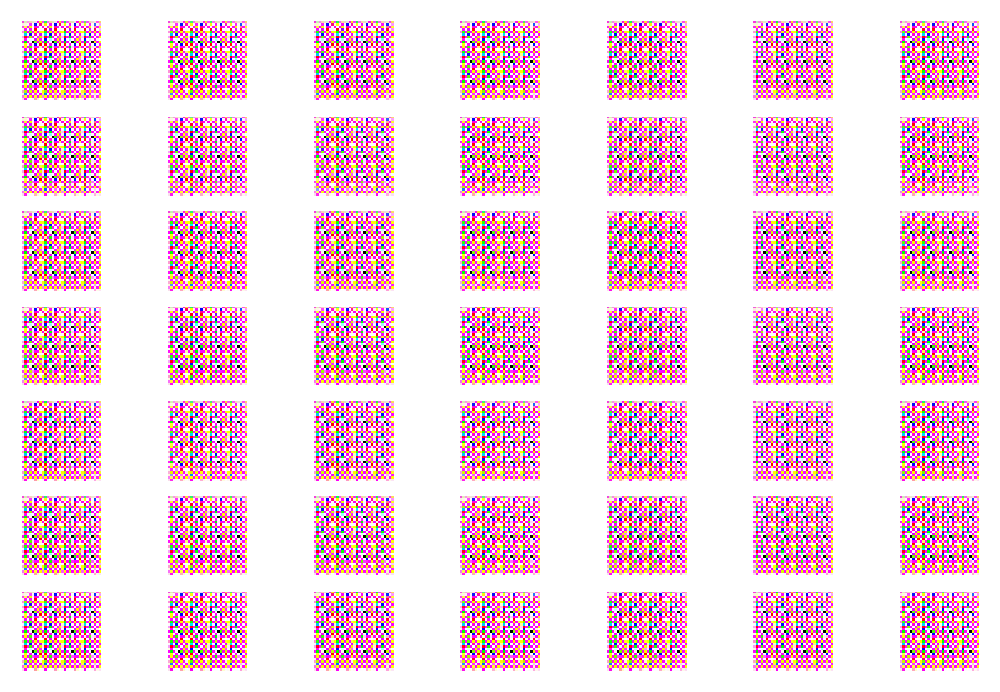

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 8, Batch: 1 of 390
 Discriminator real loss: 6.972853183746338, Discriminator Fake loss: 3.009659792496677e-07, Generator loss: 0.00010381429456174374
 Epoch: 8, Batch: 101 of 390
 Discriminator real loss: 8.879725328370114e-07, Discriminator Fake loss: 2.6650172912923153e-07, Generator loss: 7.454482692992315e-05
 Epoch: 8, Batch: 201 of 390
 Discriminator real loss: 1.6797316675365437e-06, Discriminator Fake loss: 2.493340502951469e-07, Generator loss: 6.921177555341274e-05
 Epoch: 8, Batch: 301 of 390
 Discriminator real loss: 5.112827921038843e-07, Discriminator Fake loss: 2.027807681770355e-07, Generator loss: 6.437524280045182e-05
***** Accuracy real: 100.0, fake: 0.0 *****


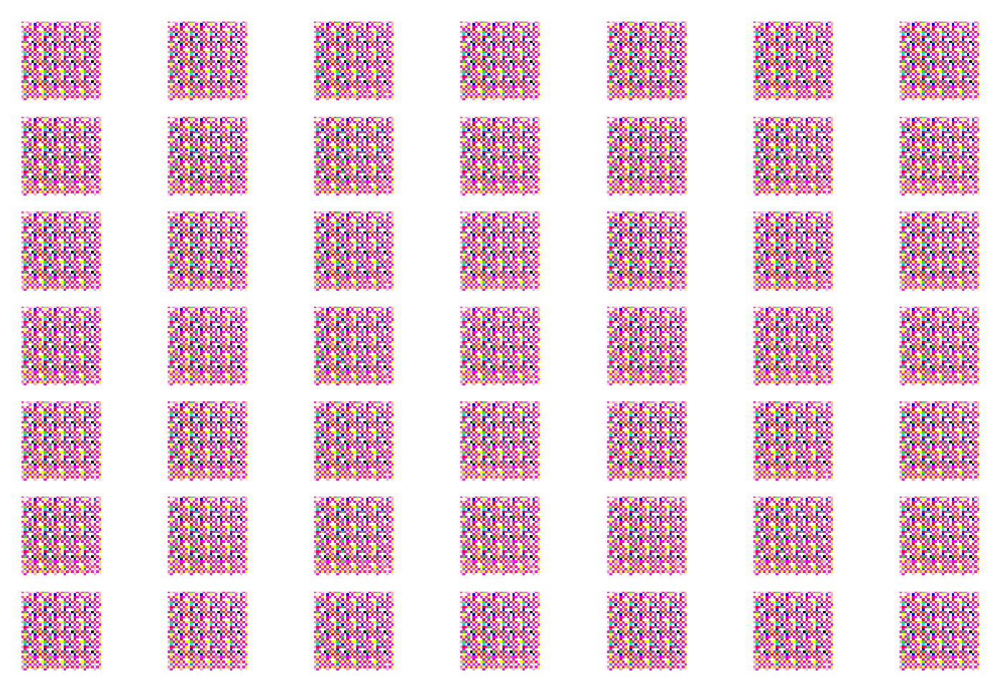

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 9, Batch: 1 of 390
 Discriminator real loss: 7.261235237121582, Discriminator Fake loss: 1.9488214775265078e-07, Generator loss: 4.351518509793095e-05
 Epoch: 9, Batch: 101 of 390
 Discriminator real loss: 6.050360070730676e-07, Discriminator Fake loss: 2.2801830823482305e-07, Generator loss: 6.955196295166388e-05
 Epoch: 9, Batch: 201 of 390
 Discriminator real loss: 1.0434536079628742e-06, Discriminator Fake loss: 1.2434200868938206e-07, Generator loss: 4.7303612518589944e-05
 Epoch: 9, Batch: 301 of 390
 Discriminator real loss: 1.161599243459932e-06, Discriminator Fake loss: 1.5470362768610357e-07, Generator loss: 5.139240965945646e-05
***** Accuracy real: 100.0, fake: 0.0 *****


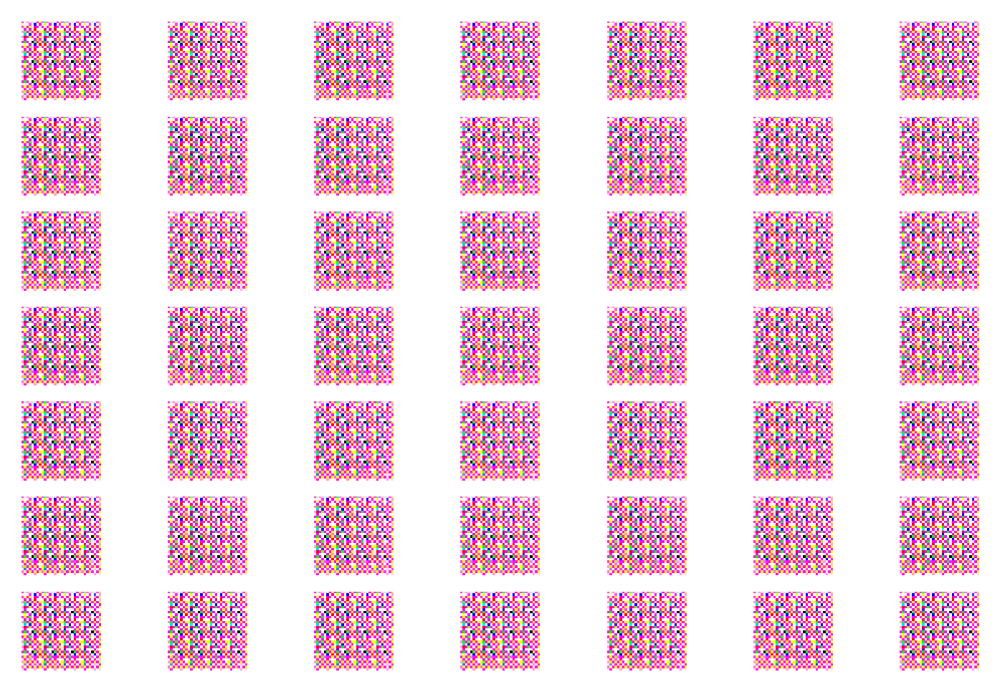

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 10, Batch: 1 of 390
 Discriminator real loss: 7.546503067016602, Discriminator Fake loss: 1.4071831344608654e-07, Generator loss: 4.071237344760448e-05
 Epoch: 10, Batch: 101 of 390
 Discriminator real loss: 2.5737758733157534e-06, Discriminator Fake loss: 1.4767294942430453e-07, Generator loss: 3.794836447923444e-05
 Epoch: 10, Batch: 201 of 390
 Discriminator real loss: 7.260758820848423e-07, Discriminator Fake loss: 1.1833259350169101e-07, Generator loss: 3.2389430998591706e-05
 Epoch: 10, Batch: 301 of 390
 Discriminator real loss: 5.090772674520849e-07, Discriminator Fake loss: 9.77017009518022e-08, Generator loss: 3.069498052354902e-05
***** Accuracy real: 100.0, fake: 0.0 *****


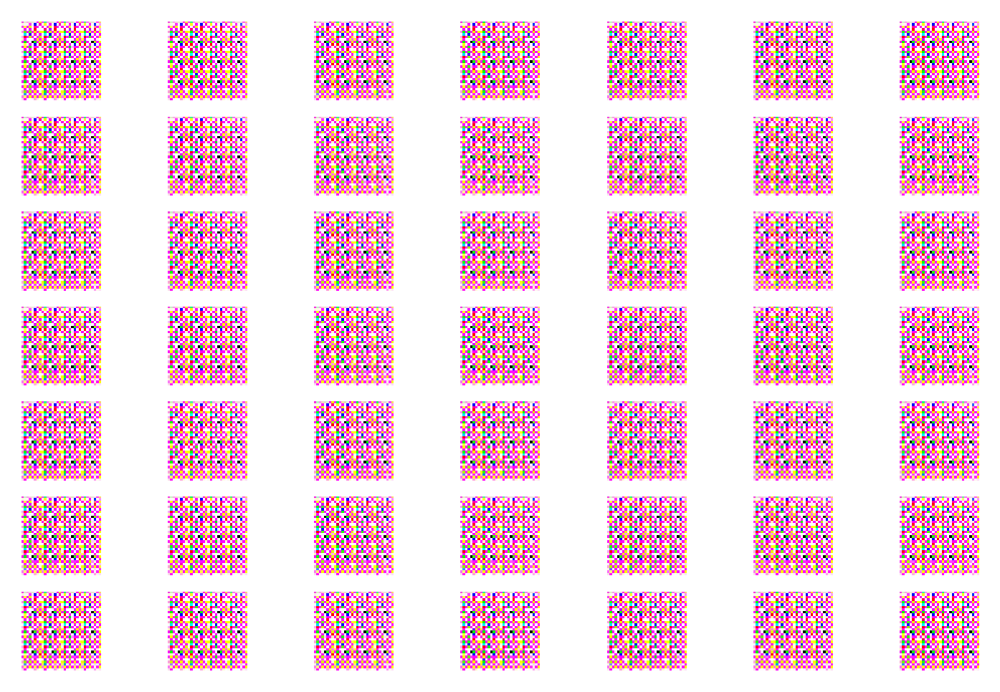

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 11, Batch: 1 of 390
 Discriminator real loss: 7.759884834289551, Discriminator Fake loss: 1.0555945095802599e-07, Generator loss: 2.5427922082599252e-05
 Epoch: 11, Batch: 101 of 390
 Discriminator real loss: 3.187589641129307e-07, Discriminator Fake loss: 9.198509332009053e-08, Generator loss: 2.819523069774732e-05
 Epoch: 11, Batch: 201 of 390
 Discriminator real loss: 3.189166477568506e-07, Discriminator Fake loss: 7.70674546402006e-08, Generator loss: 3.1174284231383353e-05
 Epoch: 11, Batch: 301 of 390
 Discriminator real loss: 4.4327072146188584e-07, Discriminator Fake loss: 7.793563838731643e-08, Generator loss: 3.54844014509581e-05
***** Accuracy real: 100.0, fake: 0.0 *****


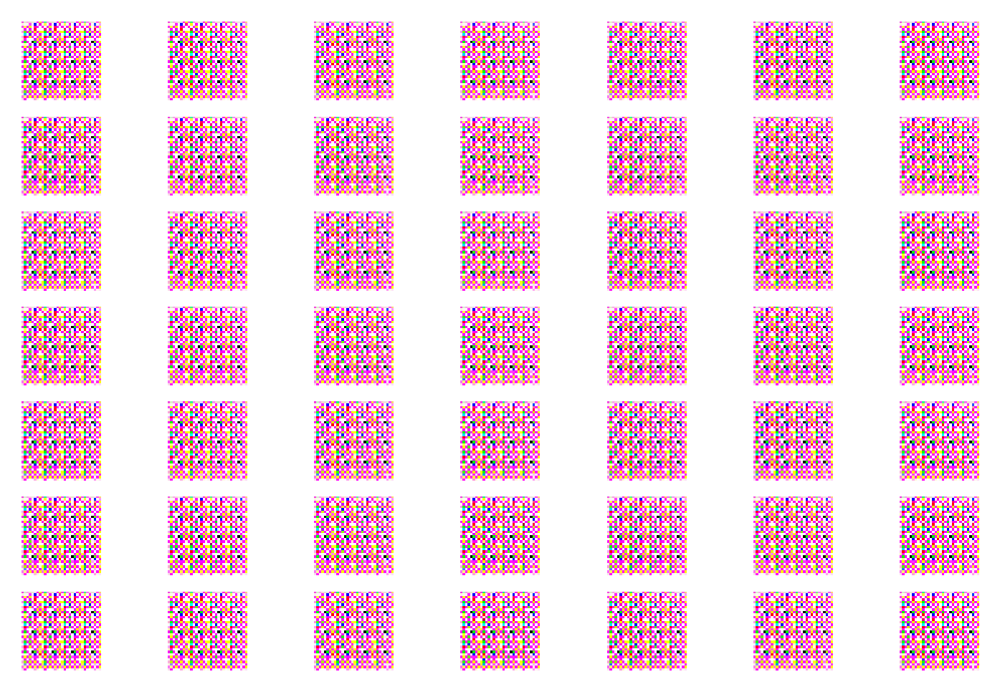

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 12, Batch: 1 of 390
 Discriminator real loss: 7.783484935760498, Discriminator Fake loss: 5.007163039749685e-08, Generator loss: 2.252508420497179e-05
 Epoch: 12, Batch: 101 of 390
 Discriminator real loss: 2.060132260339742e-07, Discriminator Fake loss: 4.686759780270222e-08, Generator loss: 2.2081534552853554e-05
 Epoch: 12, Batch: 201 of 390
 Discriminator real loss: 1.2888442313396808e-07, Discriminator Fake loss: 5.3098151653330206e-08, Generator loss: 2.3140859411796555e-05
 Epoch: 12, Batch: 301 of 390
 Discriminator real loss: 2.4037160528678214e-07, Discriminator Fake loss: 4.641644935077238e-08, Generator loss: 1.6158073776750825e-05
***** Accuracy real: 100.0, fake: 0.0 *****


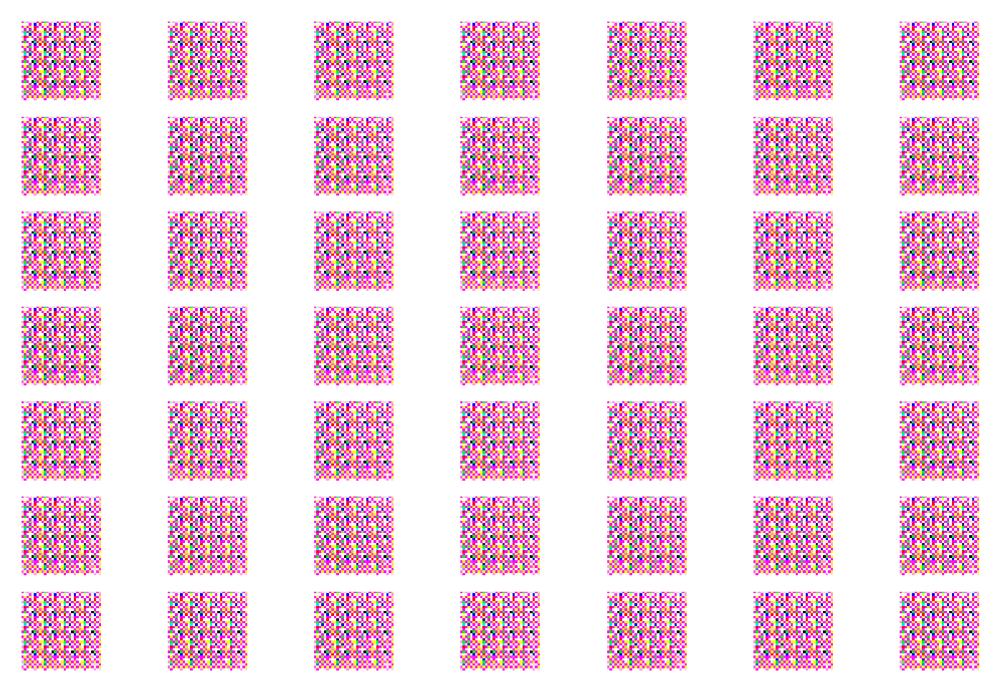

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 13, Batch: 1 of 390
 Discriminator real loss: 7.98194694519043, Discriminator Fake loss: 4.268628828185683e-08, Generator loss: 1.7952437701751478e-05
 Epoch: 13, Batch: 101 of 390
 Discriminator real loss: 9.009103507651162e-08, Discriminator Fake loss: 3.3473501304115416e-08, Generator loss: 1.7196103726746514e-05
 Epoch: 13, Batch: 201 of 390
 Discriminator real loss: 1.1896084117779537e-07, Discriminator Fake loss: 3.206375254194427e-08, Generator loss: 1.6918796973186545e-05
 Epoch: 13, Batch: 301 of 390
 Discriminator real loss: 1.490031280582116e-07, Discriminator Fake loss: 2.8841135701895837e-08, Generator loss: 2.083723848045338e-05
***** Accuracy real: 100.0, fake: 0.0 *****


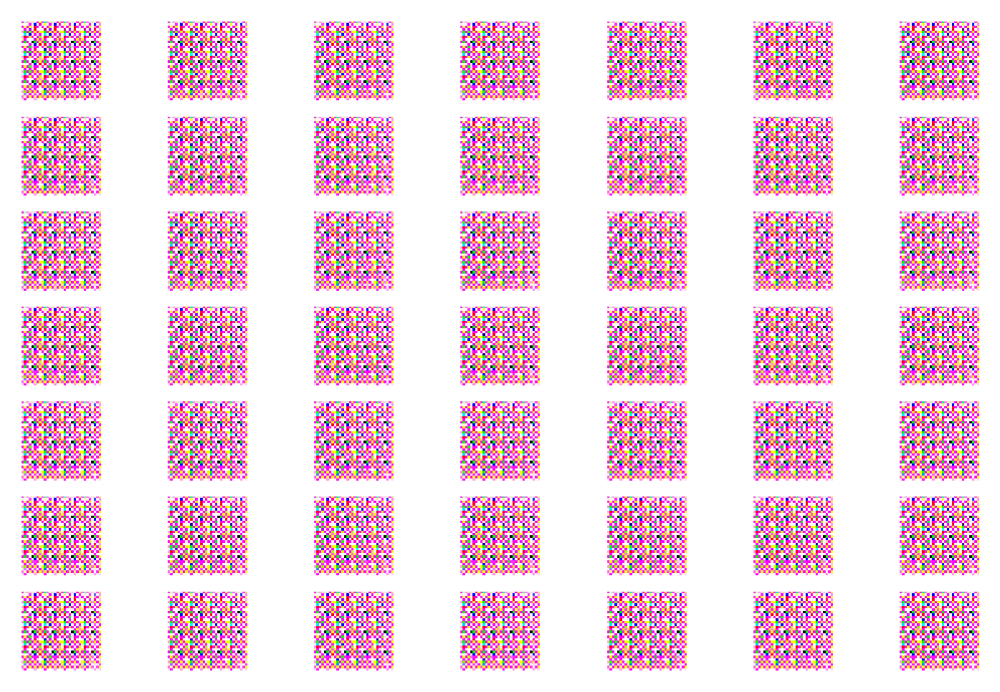

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 14, Batch: 1 of 390
 Discriminator real loss: 8.110763549804688, Discriminator Fake loss: 2.588634018252378e-08, Generator loss: 1.7091706467908807e-05
 Epoch: 14, Batch: 101 of 390
 Discriminator real loss: 9.91368622749178e-08, Discriminator Fake loss: 2.3816578931246113e-08, Generator loss: 1.6020125258364715e-05
 Epoch: 14, Batch: 201 of 390
 Discriminator real loss: 9.352310570420741e-08, Discriminator Fake loss: 1.955964101796326e-08, Generator loss: 1.3904810657550115e-05
 Epoch: 14, Batch: 301 of 390
 Discriminator real loss: 1.2104689517400402e-07, Discriminator Fake loss: 1.8194992179587643e-08, Generator loss: 1.0420393664389849e-05
***** Accuracy real: 100.0, fake: 0.0 *****


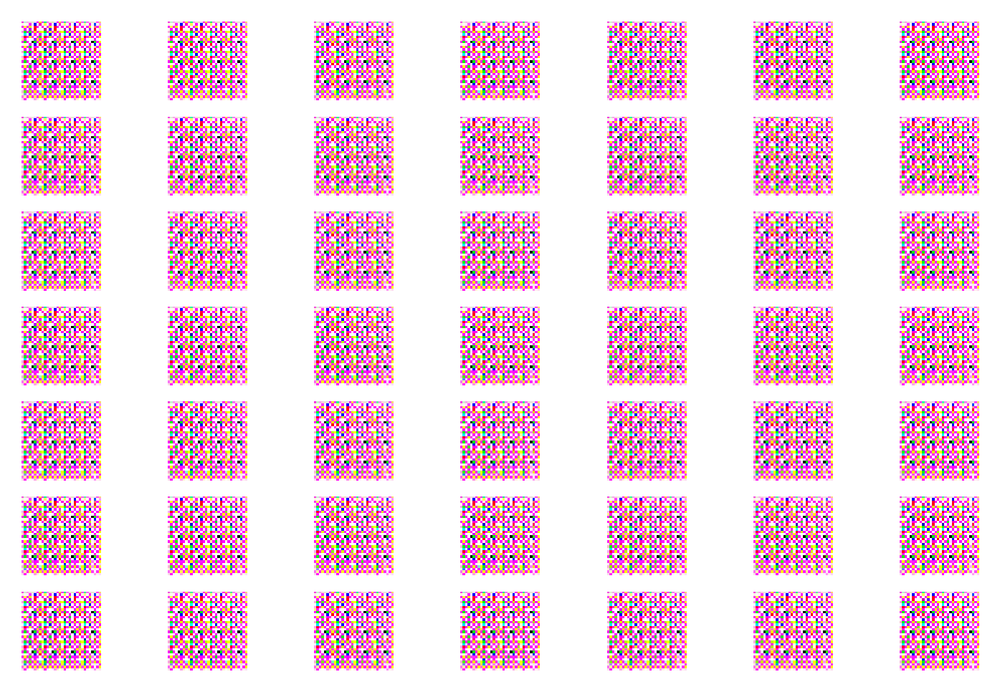

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 15, Batch: 1 of 390
 Discriminator real loss: 8.231058120727539, Discriminator Fake loss: 2.6024430610505078e-08, Generator loss: 1.3365643098950386e-05
 Epoch: 15, Batch: 101 of 390
 Discriminator real loss: 7.795033241109195e-08, Discriminator Fake loss: 2.0933415001422873e-08, Generator loss: 1.3035867596045136e-05
 Epoch: 15, Batch: 201 of 390
 Discriminator real loss: 8.375150883921378e-08, Discriminator Fake loss: 2.2504071495177413e-08, Generator loss: 1.3192096957936883e-05
 Epoch: 15, Batch: 301 of 390
 Discriminator real loss: 5.971840977281317e-08, Discriminator Fake loss: 2.1060730048816367e-08, Generator loss: 1.1471147445263341e-05
***** Accuracy real: 100.0, fake: 0.0 *****


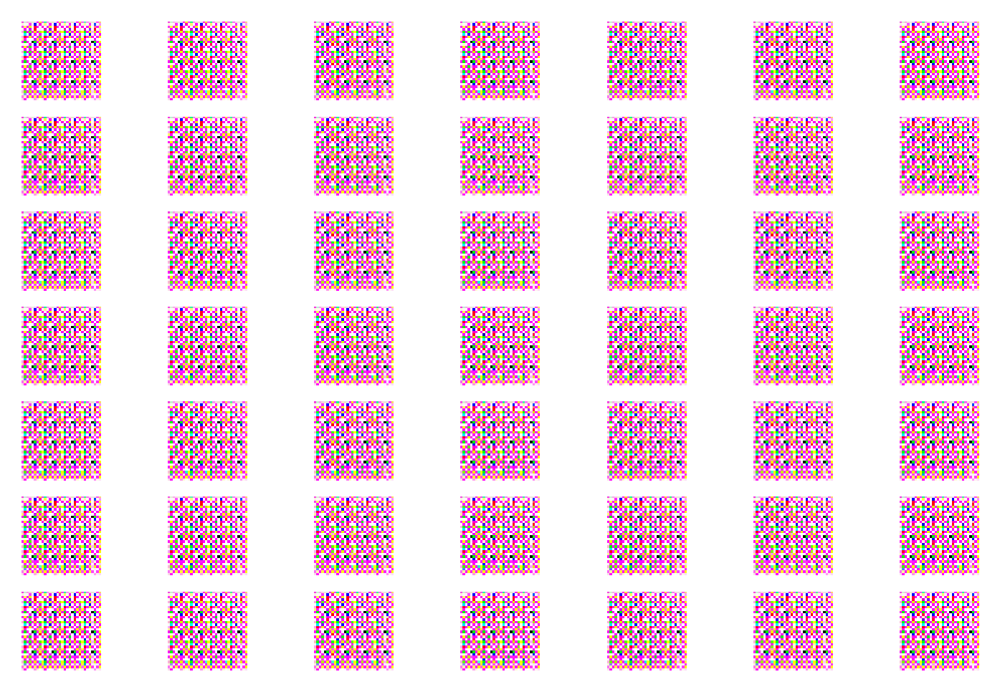

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 16, Batch: 1 of 390
 Discriminator real loss: 8.430313110351562, Discriminator Fake loss: 1.802452054278092e-08, Generator loss: 9.960440365830436e-06
 Epoch: 16, Batch: 101 of 390
 Discriminator real loss: 3.04357108404929e-08, Discriminator Fake loss: 1.729389786930824e-08, Generator loss: 1.0843119525816292e-05
 Epoch: 16, Batch: 201 of 390
 Discriminator real loss: 6.166649768601928e-08, Discriminator Fake loss: 1.4114638346995889e-08, Generator loss: 8.62968408910092e-06
 Epoch: 16, Batch: 301 of 390
 Discriminator real loss: 3.15666568440065e-08, Discriminator Fake loss: 1.2686592221200499e-08, Generator loss: 1.1013935363735072e-05
***** Accuracy real: 100.0, fake: 0.0 *****


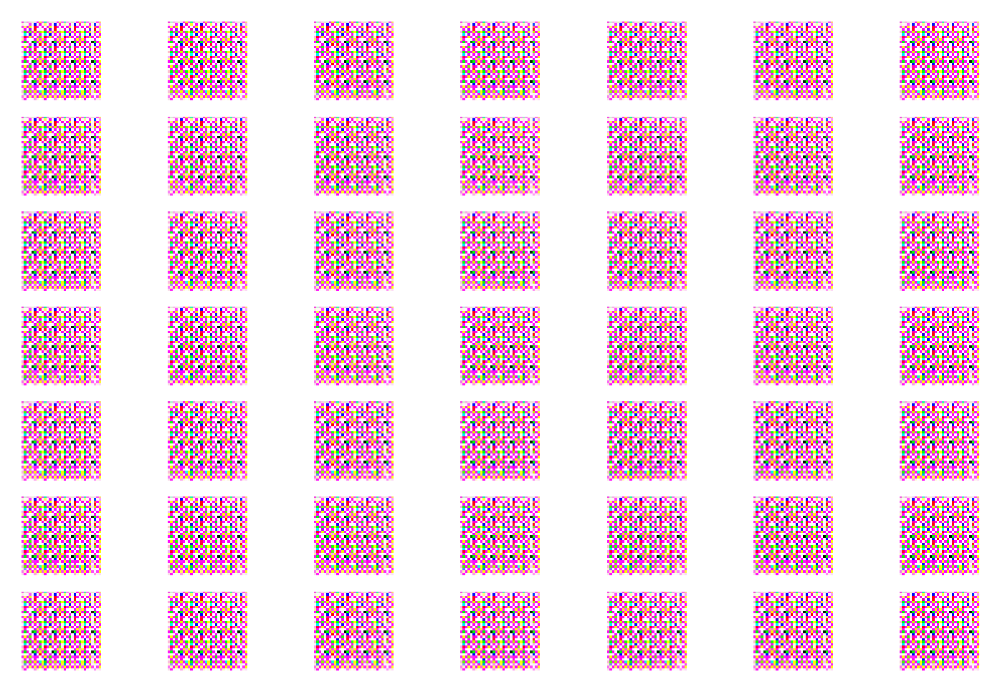

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 17, Batch: 1 of 390
 Discriminator real loss: 8.40813159942627, Discriminator Fake loss: 1.0546655992982323e-08, Generator loss: 8.840693226375151e-06
 Epoch: 17, Batch: 101 of 390
 Discriminator real loss: 4.7532846991771294e-08, Discriminator Fake loss: 1.0741261213809139e-08, Generator loss: 1.1786787581513636e-05
 Epoch: 17, Batch: 201 of 390
 Discriminator real loss: 2.5435785033778302e-08, Discriminator Fake loss: 8.575737453497823e-09, Generator loss: 1.0401035069662612e-05
 Epoch: 17, Batch: 301 of 390
 Discriminator real loss: 3.3966205847946185e-08, Discriminator Fake loss: 7.425440262665006e-09, Generator loss: 1.082874496205477e-05
***** Accuracy real: 100.0, fake: 0.0 *****


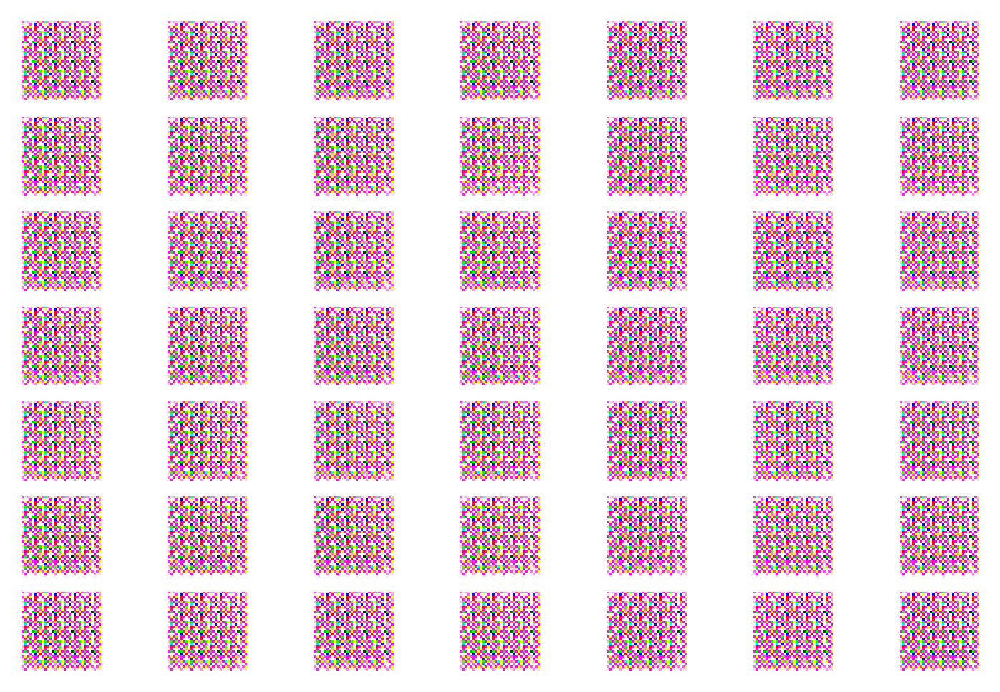

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 18, Batch: 1 of 390
 Discriminator real loss: 8.483650207519531, Discriminator Fake loss: 8.407667451137968e-09, Generator loss: 8.706732842256315e-06
 Epoch: 18, Batch: 101 of 390
 Discriminator real loss: 3.566978179492253e-08, Discriminator Fake loss: 7.438137217263829e-09, Generator loss: 1.055880966305267e-05
 Epoch: 18, Batch: 201 of 390
 Discriminator real loss: 3.338890408599582e-08, Discriminator Fake loss: 5.127026803108947e-09, Generator loss: 8.292668098874856e-06
 Epoch: 18, Batch: 301 of 390
 Discriminator real loss: 1.3655093056286205e-08, Discriminator Fake loss: 5.467563291006172e-09, Generator loss: 7.4455765570746735e-06
***** Accuracy real: 100.0, fake: 0.0 *****


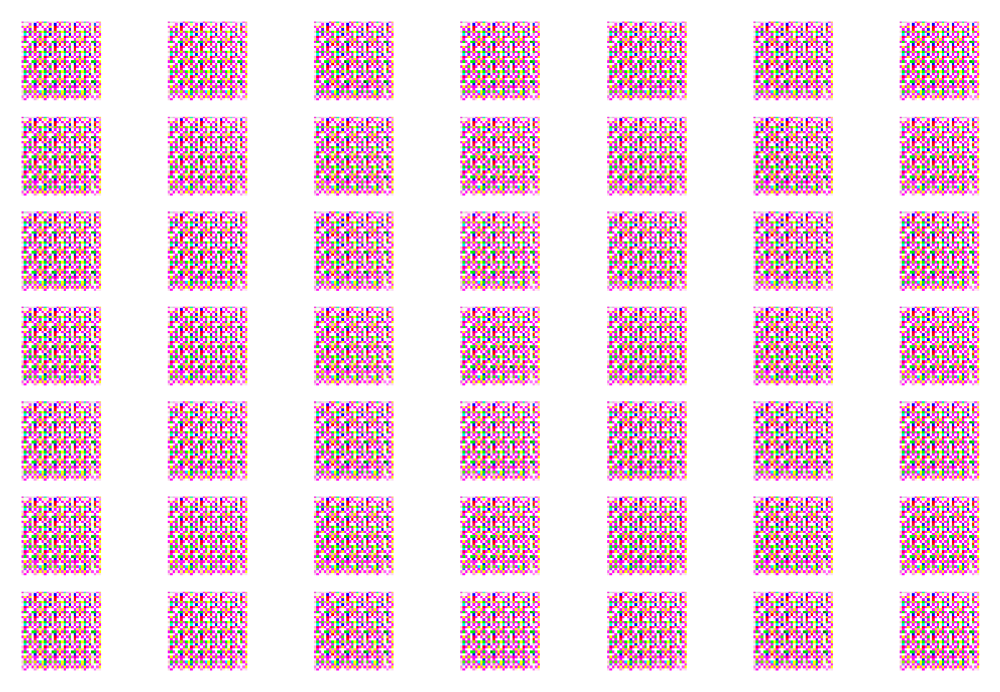

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 19, Batch: 1 of 390
 Discriminator real loss: 8.615656852722168, Discriminator Fake loss: 4.221208271815158e-09, Generator loss: 7.555459433206124e-06
 Epoch: 19, Batch: 101 of 390
 Discriminator real loss: 1.7538066998668e-08, Discriminator Fake loss: 3.2952662820662226e-09, Generator loss: 1.1465070201666094e-05
 Epoch: 19, Batch: 201 of 390
 Discriminator real loss: 1.780072622636908e-08, Discriminator Fake loss: 4.244447016077402e-09, Generator loss: 7.884988008299842e-06
 Epoch: 19, Batch: 301 of 390
 Discriminator real loss: 1.2317689979113311e-08, Discriminator Fake loss: 5.138101055734978e-09, Generator loss: 6.440964625653578e-06
***** Accuracy real: 100.0, fake: 0.0 *****


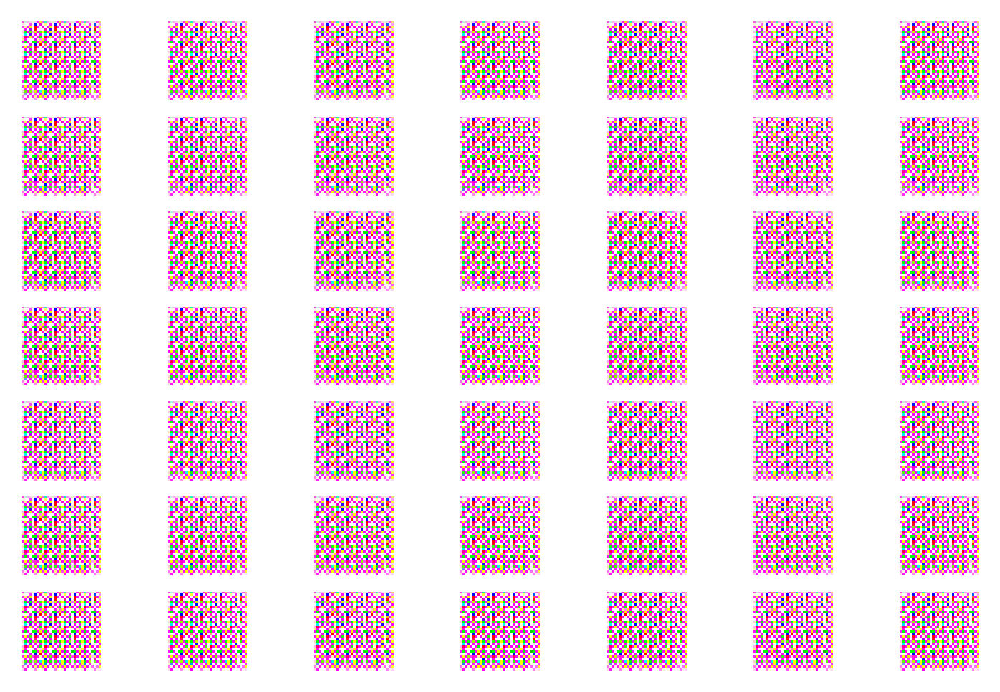

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets
 Epoch: 20, Batch: 1 of 390
 Discriminator real loss: 8.802608489990234, Discriminator Fake loss: 3.118695746096023e-09, Generator loss: 7.005190127529204e-06
 Epoch: 20, Batch: 101 of 390
 Discriminator real loss: 2.0484513640894875e-08, Discriminator Fake loss: 2.9953641789148833e-09, Generator loss: 5.688154487870634e-06
 Epoch: 20, Batch: 201 of 390
 Discriminator real loss: 9.563355440889154e-09, Discriminator Fake loss: 2.9981417348778905e-09, Generator loss: 4.793555945070693e-06
 Epoch: 20, Batch: 301 of 390
 Discriminator real loss: 6.612481673329285e-09, Discriminator Fake loss: 2.840683910321218e-09, Generator loss: 4.689215529651847e-06
***** Accuracy real: 100.0, fake: 0.0 *****


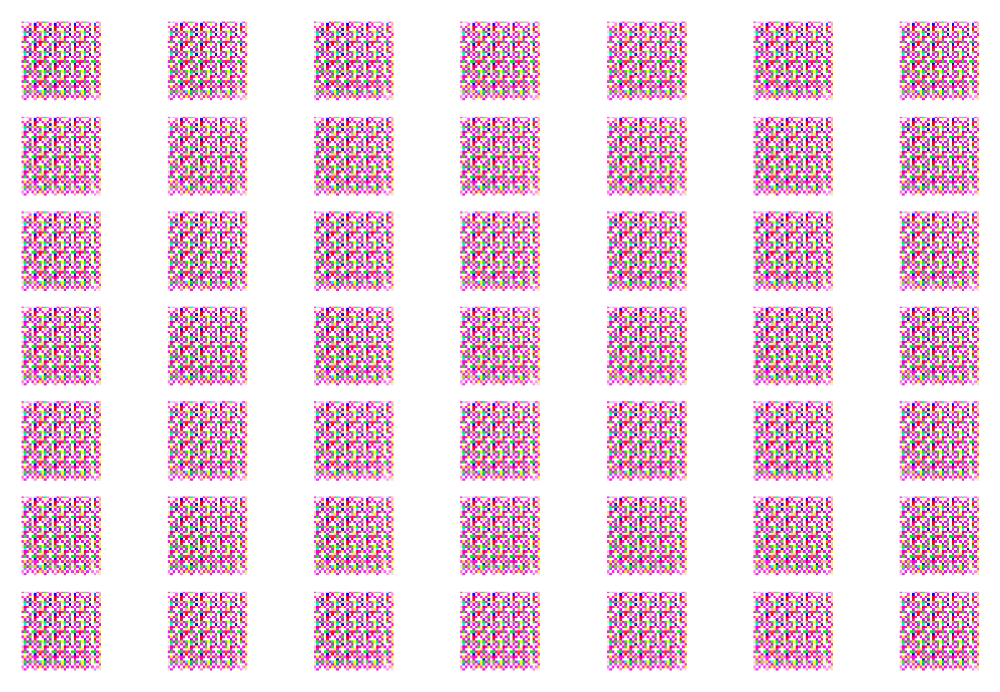

INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/generator/assets
INFO:tensorflow:Assets written to: trained_models/dcgan_cifar_withbatchnorm/discriminator/assets


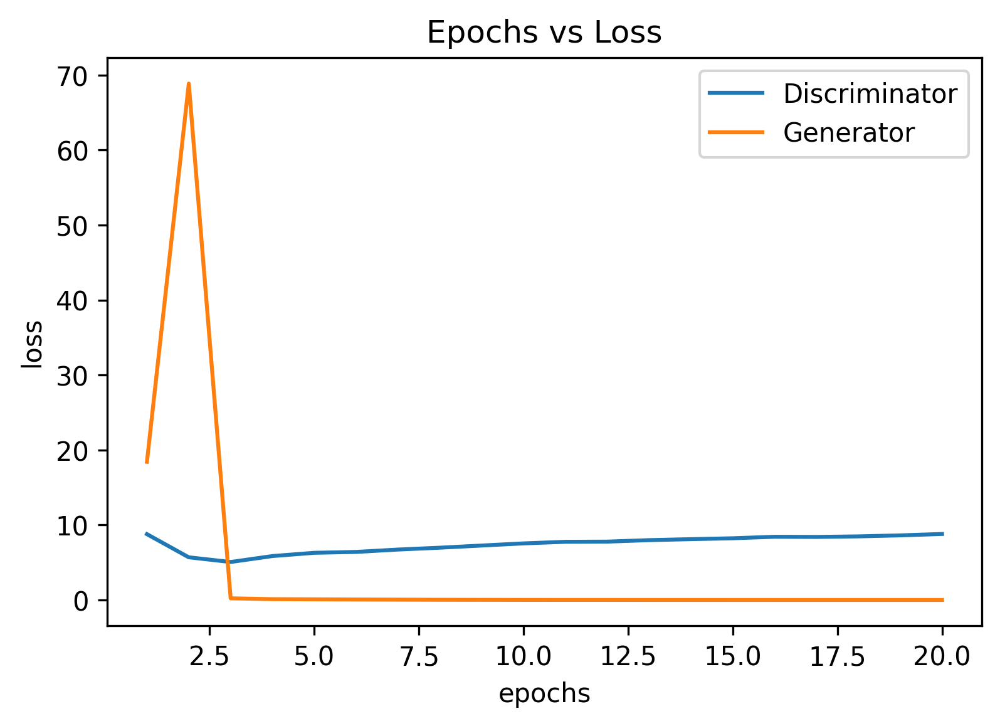

Done with training the model ......
CPU times: user 12min 51s, sys: 59.5 s, total: 13min 51s
Wall time: 31min 2s


In [5]:
%%time
# size of the latent space
samplesize = 100


# create the discriminator
discriminator = discriminator_(in_shape=(32,32,3), 
                               d_lr=0.0002,
                               d_beta=0.5, 
                              batchnorm=True)
# create the generator
generator = generator_(samplesize, batchnorm=True)
# create the gan
dcgan = dcgan_(generator, discriminator)

# train model
trained_generator = train(generator, discriminator, dcgan, data, samplesize, epochs=20, batch_size=128, model_name="dcgan_cifar_withbatchnorm")

In [4]:
generate_video("dcgan_cifar_withbatchnorm")

Epoch evolutions video saved as results/dcgan_cifar_withbatchnorm/outputs_evolution.avi


## We experimented with the architecture and observed that we could get suitable outputs by removing batch normalization from the generator and discriminator models, as opposed to the suggestions in the paper. 
